In [2]:
import pandas as pd
import numpy as np

# For plots
import matplotlib.pyplot as plt
import seaborn as sns

# For time series
from datetime import datetime
import matplotlib.dates as mdates
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.seasonal import STL

In [3]:
ai = pd.read_csv('../data/processed/ai.csv')
meme = pd.read_csv('../data/processed/meme.csv')
rwa = pd.read_csv('../data/processed/rwa.csv')
gaming = pd.read_csv('../data/processed/gaming.csv')

In [4]:
gaming.head()

,timestamp,open,high,low,close,volume,name,symbol,id,category,marketcap
0,1639526400,4.744375,5.317031,2.173027,3.078208,1.480910e+06,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,-1
1,1639612800,3.090095,3.299374,2.405868,2.605501,6.657927e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,-1
2,1639699200,2.625207,3.096436,2.283871,2.741340,5.401045e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,-1
3,1639785600,2.771380,3.038297,2.604262,2.720898,2.294669e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,-1
4,1639872000,2.726673,2.815944,2.498097,2.724654,1.654344e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,-1


In [5]:
ai['date'] = pd.to_datetime(ai['timestamp'], unit='s')
meme['date'] = pd.to_datetime(meme['timestamp'], unit='s')
rwa['date'] = pd.to_datetime(rwa['timestamp'], unit='s')
gaming['date'] = pd.to_datetime(gaming['timestamp'], unit='s')

ai['date'].min(), meme['date'].min(), rwa['date'].min(), gaming['date'].min()

(Timestamp('2016-07-05 00:00:00'),
 Timestamp('2014-08-26 00:00:00'),
 Timestamp('2016-05-24 00:00:00'),
 Timestamp('2015-08-25 00:00:00'))

In [6]:
gaming.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 126980 entries, 0 to 126979
Data columns (total 12 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   timestamp  126980 non-null  int64         
 1   open       126980 non-null  float64       
 2   high       126980 non-null  float64       
 3   low        126980 non-null  float64       
 4   close      126980 non-null  float64       
 5   volume     126980 non-null  float64       
 6   name       126980 non-null  object        
 7   symbol     126980 non-null  object        
 8   id         126980 non-null  object        
 9   category   126980 non-null  object        
 10  marketcap  126980 non-null  int64         
 11  date       126980 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(5), int64(2), object(4)
memory usage: 11.6+ MB


In [7]:
def delete_negative_marketcup(df):
    negative_marketcap_coins = df.groupby('name')['marketcap'].apply(lambda x: (x == -1).any()).sum()
    positive_marketcap_coins = df['name'].nunique() - negative_marketcap_coins
    print(f"Number of coins with marketcap -1: {negative_marketcap_coins}")
    print(f"Number of coins with marketcap not -1: {positive_marketcap_coins}")


In [8]:
delete_negative_marketcup(ai)
delete_negative_marketcup(meme)
delete_negative_marketcup(rwa)
delete_negative_marketcup(gaming)

Number of coins with marketcap -1: 49
Number of coins with marketcap not -1: 31
Number of coins with marketcap -1: 16
Number of coins with marketcap not -1: 18
Number of coins with marketcap -1: 22
Number of coins with marketcap not -1: 16
Number of coins with marketcap -1: 58
Number of coins with marketcap not -1: 59


In [9]:
filtered_data_ai = ai[ai['marketcap'] != -1].copy()
filtered_data_meme = meme[meme['marketcap'] != -1].copy()
filtered_data_rwa = rwa[rwa['marketcap'] != -1].copy()
filtered_data_gaming = gaming[gaming['marketcap'] != -1].copy()

In [10]:
def top_bottom_coins(df, n):
    top_coins = df.groupby('name').agg({'marketcap': 'max'}).nlargest(5, 'marketcap').index
    bottom_coins = df.groupby('name').agg({'marketcap': 'max'}).nsmallest(5, 'marketcap').index
    return top_coins, bottom_coins

In [11]:
def create_top_bottom(df,n):
    top, bottom = top_bottom_coins(df, n)
    return {
        'top': top,
        'bottom': bottom
    }

In [12]:
coin_ai = create_top_bottom(filtered_data_ai, 5)
coin_meme = create_top_bottom(filtered_data_meme, 5)
coin_rwa = create_top_bottom(filtered_data_rwa, 5)
coin_gaming = create_top_bottom(filtered_data_gaming, 5)

In [13]:
average_marketcap_ai = filtered_data_ai.groupby('name')['marketcap'].mean()
average_marketcap_meme = filtered_data_meme.groupby('name')['marketcap'].mean()
average_marketcap_rwa = filtered_data_rwa.groupby('name')['marketcap'].mean()
avarage_marketcap_gaming = filtered_data_gaming.groupby('name')['marketcap'].mean()

Market cap compare

In [14]:
# Paleta de colores
palette = sns.color_palette("husl", 10)

In [15]:
# Función de formato para añadir 'M' para millones y 'K' para miles
def format_value(value):
    if value >= 1_000_000:
        return f'{value / 1_000_000:.2f}M'
    elif value >= 1_000:
        return f'{value / 1_000:.2f}K'
    else:
        return f'{value:.2f}'

In [16]:
def plot_marketcap(df, state, amount, category_name, palette=palette):
    # Determinar si se buscan los valores más bajos o más altos
    if state == 0:
        top_marketcap = df.nsmallest(amount)
        title = f"Top {amount} monedas con menor Market Cap ({category_name})"
    elif state == 1:
        top_marketcap = df.nlargest(amount)
        title = f"Top {amount} monedas con mayor Market Cap ({category_name})"
    
    # Ordenar los datos para visualización en orden ascendente
    top_marketcap = top_marketcap.sort_values(ascending=False)

    # Crear el gráfico de barras
    plt.figure(figsize=(20, 8))
    bars = plt.bar(top_marketcap.index, top_marketcap.values, color=palette, edgecolor='black')

    # Añadir el título y etiquetas de ejes
    plt.title(title, fontsize=16, fontweight='bold')
    plt.xlabel('Token', fontsize=14)
    plt.ylabel('Average Market Cap', fontsize=14)
    plt.xticks(rotation=45, ha='right', fontsize=10)

    # Añadir anotaciones en cada barra con formato personalizado
    for bar in bars:
        yval = bar.get_height()
        # Usar la función format_value para formatear el texto
        plt.text(bar.get_x() + bar.get_width()/2, yval + yval * 0.02, format_value(yval), 
                ha='center', va='bottom', fontsize=10, color='black', fontweight='bold')

    # Añadir un borde al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

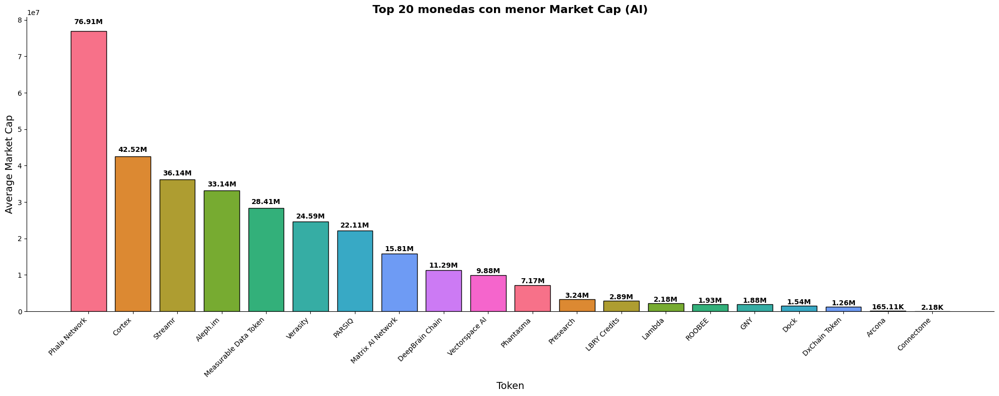

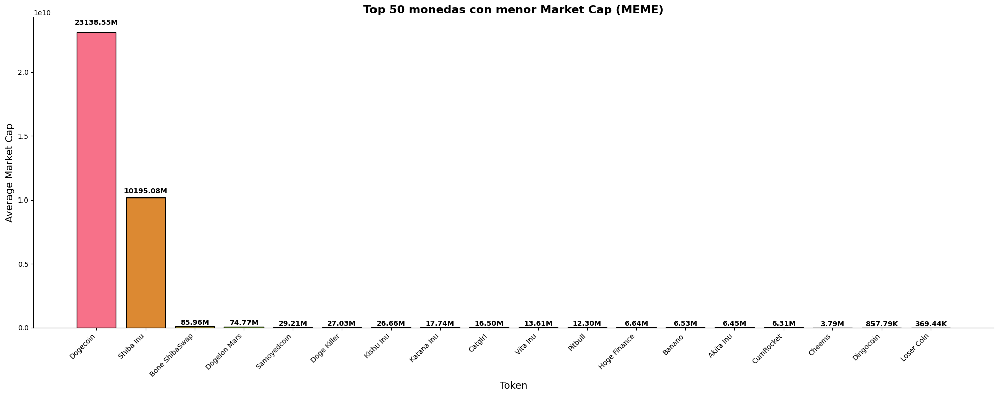

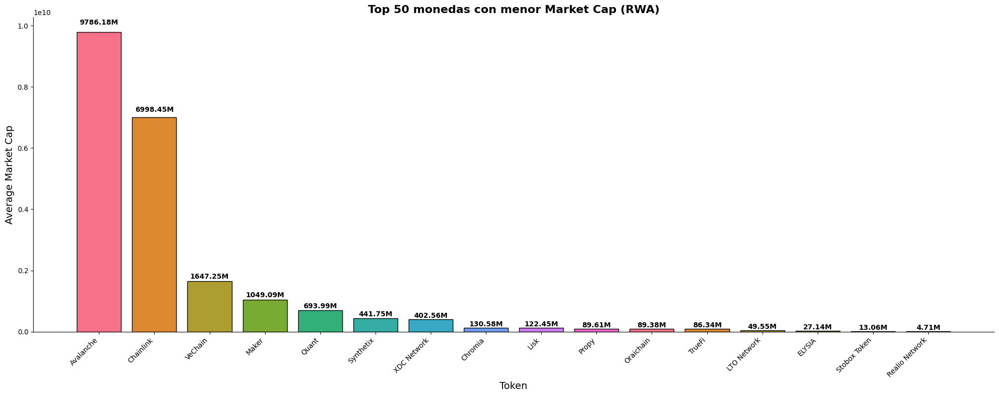

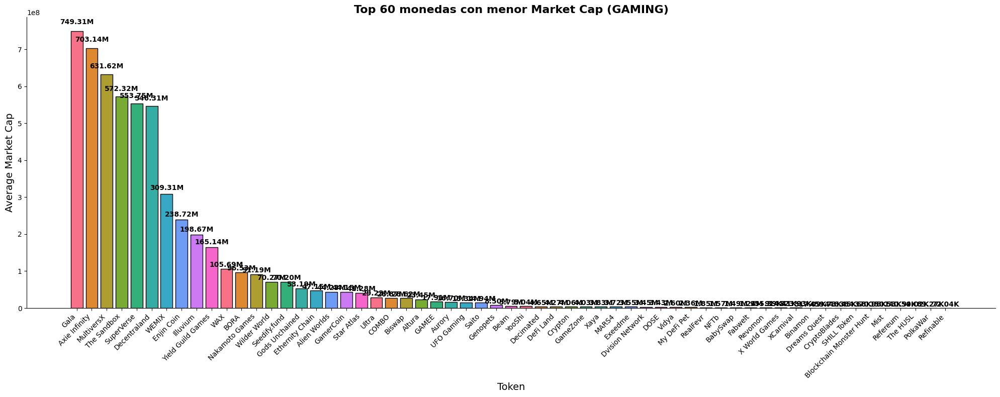

In [17]:
plot_marketcap(average_marketcap_ai, 0, 20, "AI")
plot_marketcap(average_marketcap_meme, 0, 50, "MEME")
plot_marketcap(average_marketcap_rwa, 0, 50, "RWA")
plot_marketcap(avarage_marketcap_gaming, 0, 60, "GAMING")

En las graficas que observamos en la parte superior muestran el panorama de los tokens de menor capitalización en distintas categorías: AI Tokens, MEME Tokens, RWA Tokens y GAMING Tokens. Al observarlas en conjunto, podemos identificar patrones que reflejan las características únicas de cada categoría y nos ayudan a entender su comportamiento y potencial en el mercado.

En la categoría de AI Tokens, vemos que Phantasma sobresale con una capitalización de 7.17 millones, mientras que los demás tokens tienen cifras mucho menores. Esto sugiere que algunos proyectos de inteligencia artificial están logrando captar más atención y respaldo que otros, lo que podría hacerlos interesantes para una inversión que busque innovación, pero con un riesgo moderado.

Por otro lado, los MEME Tokens muestran un comportamiento diferente. Aquí, tokens como Catgirl alcanzan una capitalización de 16.50 millones, mucho mayor que la de los AI Tokens. Sin embargo, la gran diferencia entre el primero y los últimos de la lista, como Loser Coin (369.44 mil), muestra que estos tokens son altamente especulativos y están sujetos a cambios rápidos, influenciados en gran medida por tendencias en redes sociales

En contraste, los RWA Tokens, que están respaldados por activos del mundo real, presentan una capitalización más estable. XDC Network lidera con 402.56 millones, mientras que otros como Realio Network tienen solo 4.71 millones. Esta categoría parece ofrecer mayor seguridad, pues los activos reales en los que están basados aportan cierta estabilidad.

Finalmente, los GAMING Tokens son los de menor capitalización entre todas las categorías, con valores que van desde 517.09 mil (Binamon) hasta 72.04 mil. Este sector es especialmente volátil porque depende de la popularidad de los juegos en blockchain, que puede cambiar rápidamente.

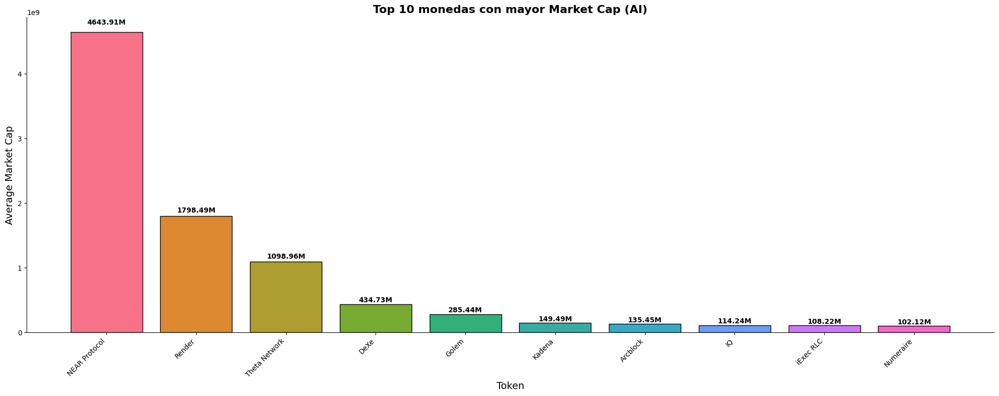

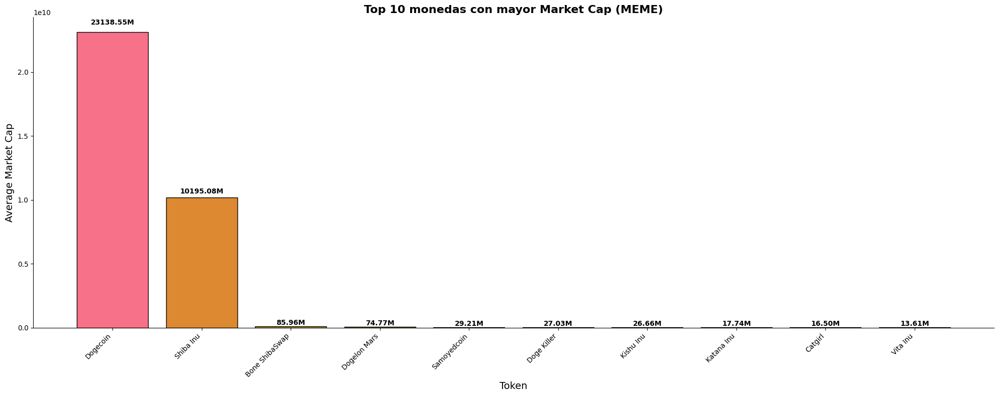

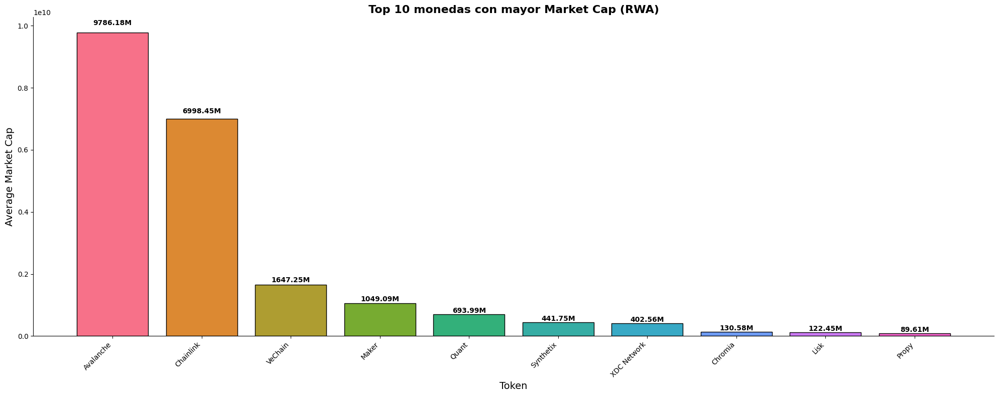

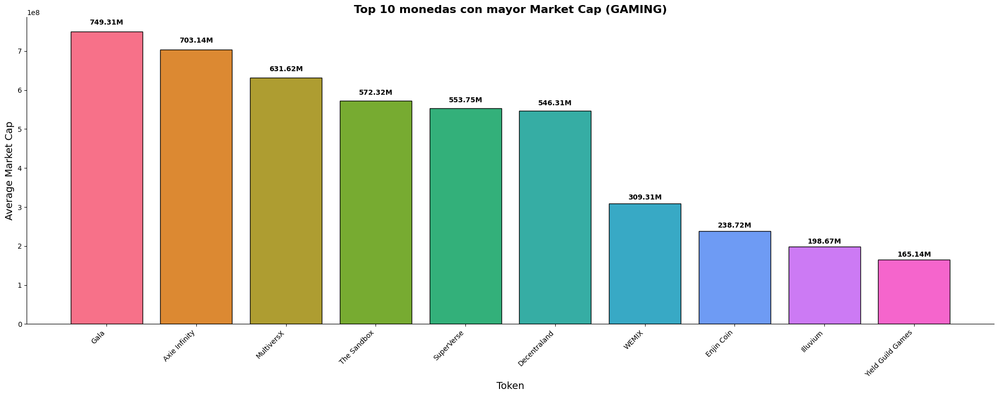

In [18]:
plot_marketcap(average_marketcap_ai, 1, 10, "AI")
plot_marketcap(average_marketcap_meme,1, 10, "MEME")
plot_marketcap(average_marketcap_rwa, 1, 10, "RWA")
plot_marketcap(avarage_marketcap_gaming, 1, 10, "GAMING")

A continuación observamos que estas gráficas a diferencia de las anteriores nos permiten entender cómo se distribuye la capitalización en las criptomonedas más destacadas de cada sector y nos dan una idea de su estabilidad y potencial en el mercado.

En la categoría de AI Tokens, NEAR Protocol lidera ampliamente con una capitalización de 4643.91 millones, seguido por Render con 1798.49 millones y Theta Network con 1098.96 millones. La gran diferencia entre NEAR Protocol y el resto sugiere que, dentro de los AI Tokens, algunos proyectos logran captar mucha más inversión y respaldo que otros, estableciendo una diferencia significativa en términos de confianza e interés en el mercado.

Mientras que para los MEME Tokens, la capitalización de mercado está altamente concentrada en Dogecoin y Shiba Inu, que tienen 23138.55 millones y 10195.08 millones, respectivamente, mientras que los demás tokens están muy por debajo de estas cifras. Esta concentración refleja el poder de la popularidad y el respaldo social en este tipo de tokens, que dependen en gran medida de su visibilidad y aceptación viral. Estos dos tokens dominan claramente la categoría, y aunque los demás tienen cierta capitalización, la diferencia es muy marcada, lo que demuestra el efecto de la marca en el éxito de los MEME Tokens.

Aunque en el caso de los RWA Tokens, encontramos que Avalanche y Chainlink tienen las capitalizaciones más altas, con 9786.18 millones y 6998.45 millones, respectivamente. Al igual que en los AI Tokens, existe una notable brecha entre estos líderes y el resto, como VeChain (1647.25 millones) y Maker (1049.09 millones). Este comportamiento indica que, en los RWA Tokens, los proyectos con una fuerte base en activos tangibles tienden a captar más inversión.

Finalmente, los GAMING Tokens muestran una capitalización relativamente más uniforme en comparación con las otras categorías. Gala lidera con 749.31 millones, seguido de cerca por Axie Infinity y MultiversX. Aunque hay cierta diferencia entre los tokens de mayor y menor capitalización en esta lista, no es tan pronunciada como en los MEME o AI Tokens.

In [19]:
def complete_crypto(top_coin, bottom_coin, df):
    top_coin = df[df['name'].isin(top_coin)].copy()
    bottom_coin = df[df['name'].isin(bottom_coin)].copy()
    top_coin.loc[:, 'timestamp'] = pd.to_datetime(top_coin['timestamp'], unit='s')
    bottom_coin.loc[:, 'timestamp'] = pd.to_datetime(bottom_coin['timestamp'], unit='s')
    return {
        'top': top_coin,
        'bottom': bottom_coin
    }

In [20]:
df_ai = complete_crypto(coin_ai['top'], coin_ai['bottom'], filtered_data_ai)
df_meme = complete_crypto(coin_meme['top'], coin_meme['bottom'], filtered_data_meme)
df_rwa = complete_crypto(coin_rwa['top'], coin_rwa['bottom'], filtered_data_rwa)
df_gaming = complete_crypto(coin_gaming['top'], coin_gaming['bottom'], filtered_data_gaming)

C:\Users\marck\AppData\Local\Temp\ipykernel_4996\707684661.py:4: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '<DatetimeArray>
['2017-08-10 00:00:00', '2017-08-11 00:00:00', '2017-08-12 00:00:00',
 '2017-08-13 00:00:00', '2017-08-14 00:00:00', '2017-08-15 00:00:00',
 '2017-08-16 00:00:00', '2017-08-17 00:00:00', '2017-08-18 00:00:00',
 '2017-08-19 00:00:00',
 ...
 '2024-10-19 00:00:00', '2024-10-20 00:00:00', '2024-10-21 00:00:00',
 '2024-10-22 00:00:00', '2024-10-23 00:00:00', '2024-10-24 00:00:00',
 '2024-10-25 00:00:00', '2024-10-26 00:00:00', '2024-10-27 00:00:00',
 '2024-10-28 00:00:00']
Length: 9651, dtype: datetime64[ns]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  top_coin.loc[:, 'timestamp'] = pd.to_datetime(top_coin['timestamp'], unit='s')
C:\Users\marck\AppData\Local\Temp\ipykernel_4996\707684661.py:5: FutureWarning: Setting an item of incompatible dtype is de

Visualizacion de las 5 criptomonedas top y botton

In [21]:
def plot_price(df, title, palette=palette):
    plt.figure(figsize=(14, 8))
    
    # Agrupamos y asignamos un color diferente a cada línea
    for i, (name, group) in enumerate(df.groupby('name')):
        plt.plot(group['timestamp'], group['close'], label=name, color=palette[i % len(palette)], alpha=0.8, linewidth=1.5)
    
    # Configuración del título y etiquetas
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)

    # Formato de la leyenda
    plt.legend(title="Token", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))

    # Mejorar el formato de la fecha en el eje X
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)

    # Agregar bordes suaves al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

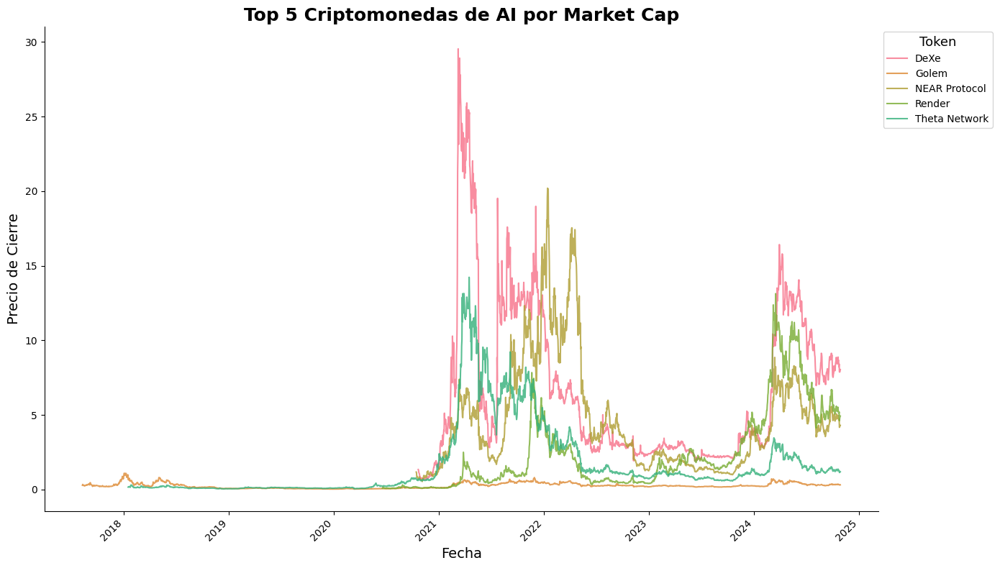

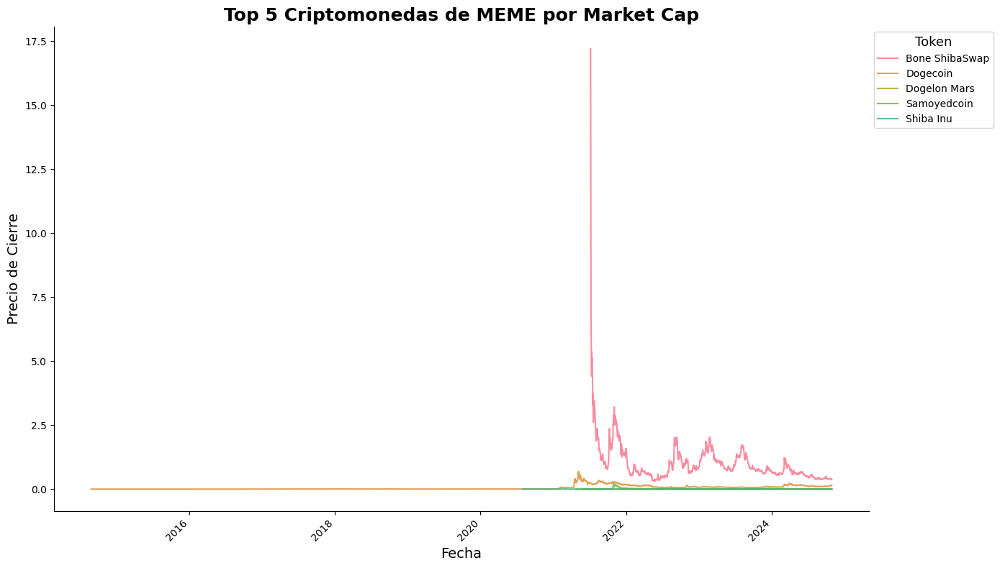

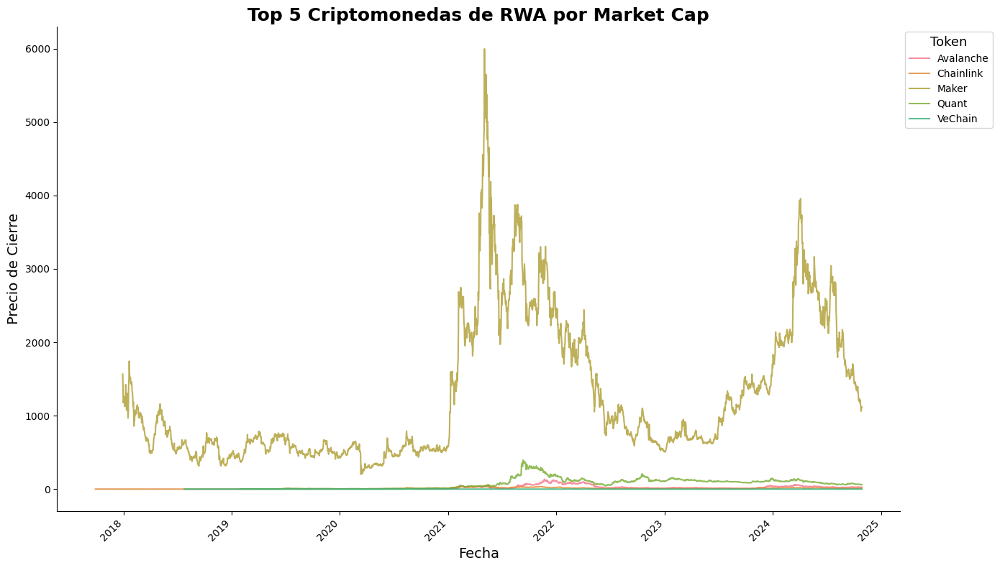

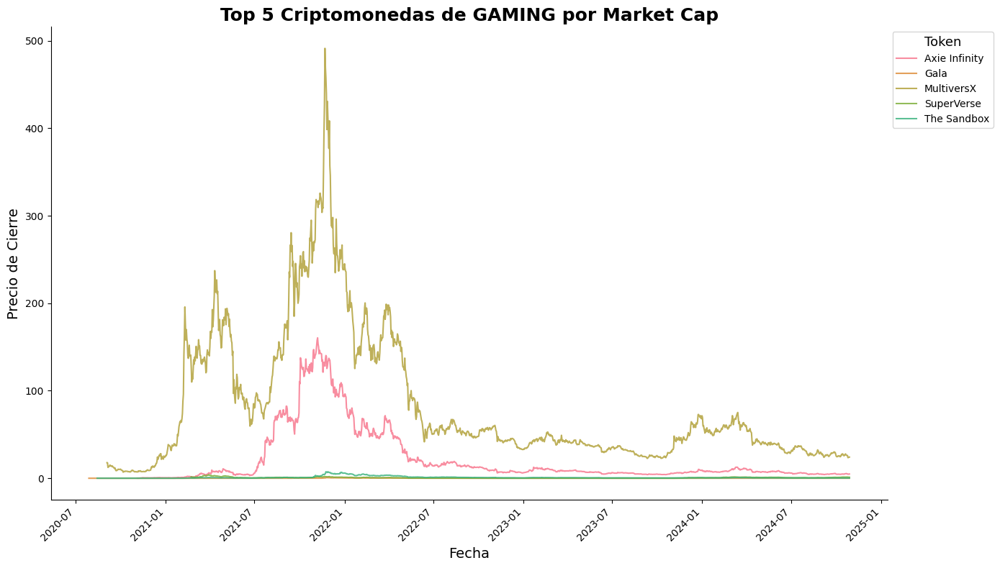

In [22]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
plot_price(df_ai['top'], "Top 5 Criptomonedas de AI por Market Cap")
plot_price(df_meme['top'], "Top 5 Criptomonedas de MEME por Market Cap")
plot_price(df_rwa['top'], "Top 5 Criptomonedas de RWA por Market Cap")
plot_price(df_gaming['top'], "Top 5 Criptomonedas de GAMING por Market Cap")

En estas gráficas de precios de cierre de las principales criptomonedas de las categorías que ya se usaron para graficar anteriormente, podemos ver patrones interesantes que reflejan cómo cada tipo de token responde a diferentes dinámicas del mercado.

En la primera gráfica, se muestra las criptomonedas de inteligencia artificial, las cuales han tenido un crecimiento importante en tokens como DeXe y Golem, alcanzando picos alrededor de 2021 y 2022. Esto podría estar relacionado con el boom del interés en la inteligencia artificial y su implementación en blockchain. Sin embargo, después de estos picos, los precios tienden a bajar, lo cual podría indicar que el interés inicial fue impulsado por la especulación y no se sostuvo en el tiempo.

En la segunda gráfica, con los MEME Tokens. El token de Bone ShibaSwap se mostro con una volatilidad altísima, con aumentos repentinos seguidos de caídas igualmente rápidas. Esto se debe, en gran parte, a la influencia de redes sociales y de personas influyentes, que impulsan estos tokens de manera explosiva. Sin embargo, esa misma volatilidad extrema los hace muy inestables, y es difícil que mantengan un valor alto de forma constante.

Para los RWA Tokens. La token de Maker tienen picos significativos, pero en general, las fluctuaciones son menos extremas comparadas con los MEME Tokens.

Finalmente, en la categoría de GAMING Tokens, observamos que tokens como Axie Infinity y MultiversX experimentaron un gran aumento en 2021, coincidiendo con el auge de los juegos basados en blockchain. Sin embargo, esta categoría parece ser bastante dependiente de la popularidad de los juegos, y los precios caen de manera significativa cuando el interés en estos juegos baja.

In [23]:
def plot_cryptos_in_range(df, start_date, end_date, title, palette=palette):
    # Filtrar los datos en el rango de fechas especificado
    cryptos_filtered = df[(df['timestamp'] >= start_date) & (df['timestamp'] <= end_date)]
    
    # Crear la figura
    plt.figure(figsize=(14, 8))
    
    # Graficar cada criptomoneda con un color distinto de la paleta
    for i, (name, group) in enumerate(cryptos_filtered.groupby('name')):
        plt.plot(group['timestamp'], group['close'], label=name, color=palette[i % len(palette)], alpha=0.8, linewidth=1.5)
    
    # Configuración del título y etiquetas de ejes
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)

    # Formato de la leyenda
    plt.legend(title="Token", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))

    # Mejorar el formato de la fecha en el eje X
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)

    # Agregar bordes suaves al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

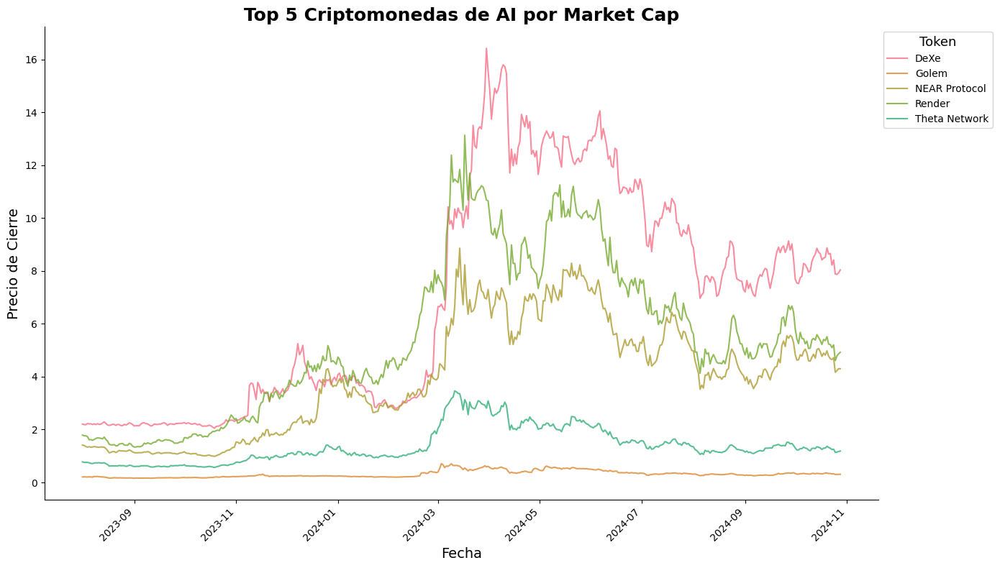

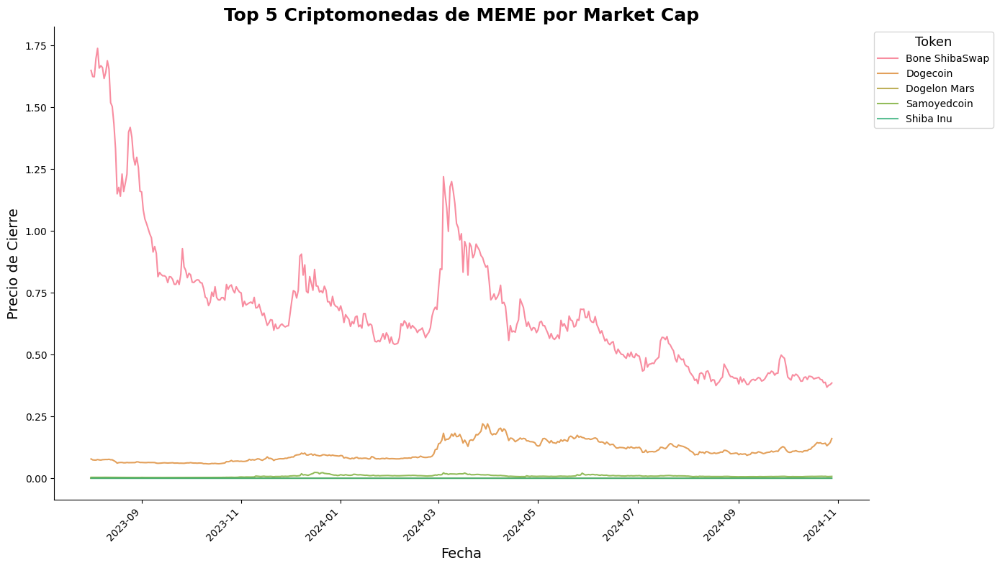

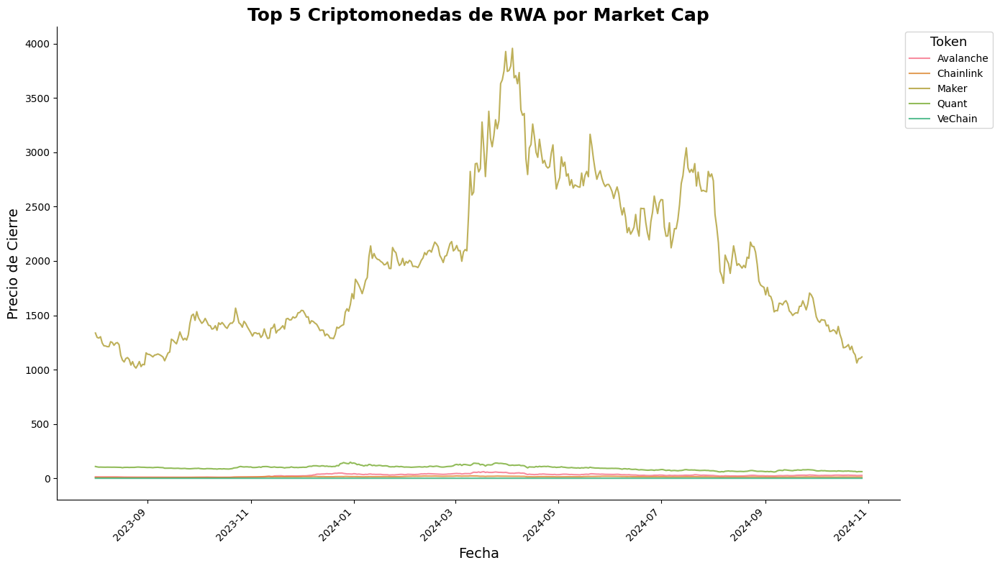

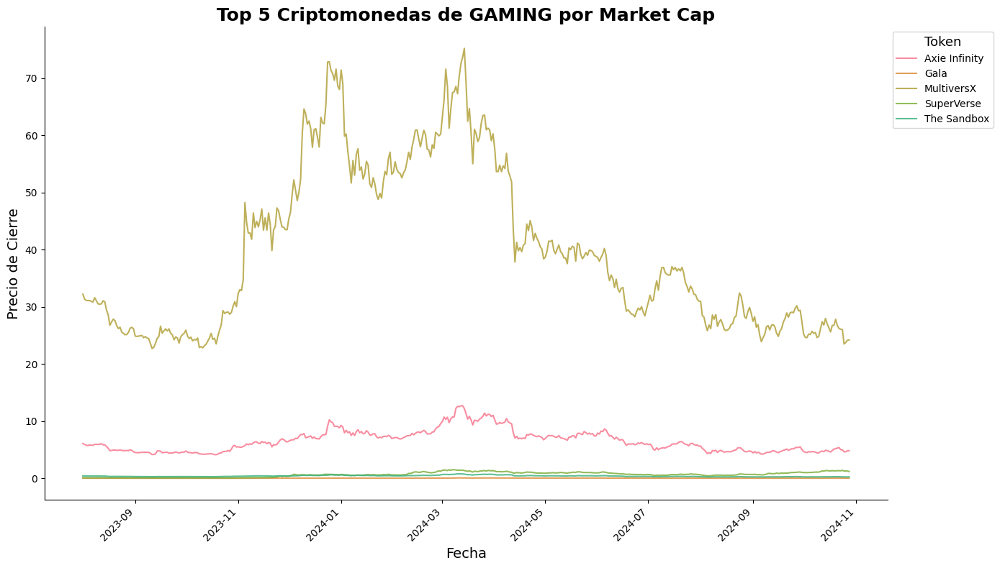

In [24]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en un rango de fechas
plot_cryptos_in_range(df_ai['top'],  datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de AI por Market Cap")
plot_cryptos_in_range(df_meme['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de MEME por Market Cap")
plot_cryptos_in_range(df_rwa['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de RWA por Market Cap")
plot_cryptos_in_range(df_gaming['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de GAMING por Market Cap")

En estas graficas de las criptomonedas con mayor Market Cap en un rango de fechas. En la primera categoría, las criptomonedas de IA muestran una notable volatilidad, reflejando el interés fluctuante en proyectos de inteligencia artificial. Tokens como DeXe y Render experimentan altas variaciones, posiblemente debido a la especulación que atraen por su innovación en el sector. NEAR Protocol también muestra movimientos importantes, lo que sugiere su relevancia en el mercado.

La categoría MEME, por otro lado, presenta una variabilidad distinta, con Bone ShibaSwap destacándose en términos de volatilidad. Este tipo de tokens es altamente especulativo, impulsado principalmente por el sentimiento de las redes sociales y de los inversionistas, lo que provoca fluctuaciones rápidas en sus precios. Aunque Dogecoin y Shiba Inu son relativamente más estables en comparación con Bone ShibaSwap, también muestran cierta volatilidad.

En el caso de las criptomonedas RWA, la gráfica refleja un comportamiento más estable en comparación con las categorías de IA y MEME. Avalanche y Chainlink lideran esta categoría, con precios que fluctúan de manera más controlada, posiblemente debido al respaldo en activos físicos, lo que proporciona una capa de seguridad adicional para los inversionistas. Maker y VeChain mantienen precios relativamente constantes.

Por último, los tokens de GAMING presentan una gran variación de precios, con MultiversX y Axie Infinity experimentando picos destacados. Esta categoría es interesante para quienes buscan aprovechar el crecimiento de la industria de los videojuegos, aunque el riesgo de fluctuación sigue siendo alto debido a la naturaleza impredecible del entretenimiento digital.

In [25]:
def plot_date_halving(df, start_date, end_date, title, palette=palette):
    # Fecha del halving
    halving_date = datetime(2024, 4, 19)
    #halving_date_2 = datetime(2023, 4, 19)  # Segunda fecha de halving

    # Filtrar los datos en el rango de fechas especificado
    cryptos_filtered = df[(df['timestamp'] >= start_date) & (df['timestamp'] <= end_date)]
    
    # Crear la figura
    plt.figure(figsize=(14, 8))
    
    # Graficar cada criptomoneda con diferentes estilos antes y después del halving
    for i, (name, group) in enumerate(cryptos_filtered.groupby('name')):
        color = palette[i % len(palette)]
        before_halving = group[group['timestamp'] < halving_date]
        after_halving = group[group['timestamp'] >= halving_date]
        
        # Línea sólida para antes del halving
        plt.plot(before_halving['timestamp'], before_halving['close'], label=f'{name} - Antes del Halving', 
                color=color, alpha=0.8, linewidth=1.5)
        
        # Línea punteada para después del halving
        plt.plot(after_halving['timestamp'], after_halving['close'], linestyle='--', label=f'{name} - Después del Halving', 
                color=color, alpha=0.8, linewidth=1.5)
    
    # Línea vertical para la fecha del halving
    plt.axvline(x=halving_date, color='red', linestyle=':', linewidth=2, label='Fecha del Halving (19 de Abril de 2024)')
    
    # Línea vertical para la segunda fecha del halving
    #plt.axvline(x=halving_date_2, color='blue', linestyle=':', linewidth=2, label='Fecha del Segundo Halving (19 de Abril de 2023)')

    # Configuración del título y etiquetas de ejes
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)

    # Formato de la leyenda
    plt.legend(title="Leyenda", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))

    # Mejorar el formato de la fecha en el eje X
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)

    # Agregar bordes suaves al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

In [26]:
df_ai['top']['timestamp'].min(), df_meme['top']['timestamp'].min(), df_rwa['top']['timestamp'].min(), df_gaming['top']['timestamp'].min()

(Timestamp('2017-08-10 00:00:00'),
 Timestamp('2014-08-26 00:00:00'),
 Timestamp('2017-09-28 00:00:00'),
 Timestamp('2020-07-28 00:00:00'))

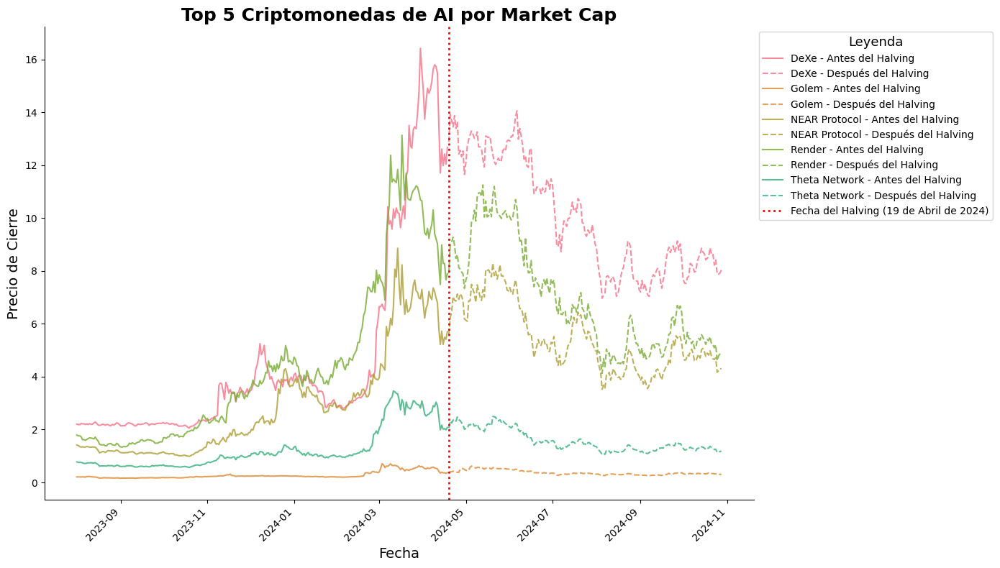

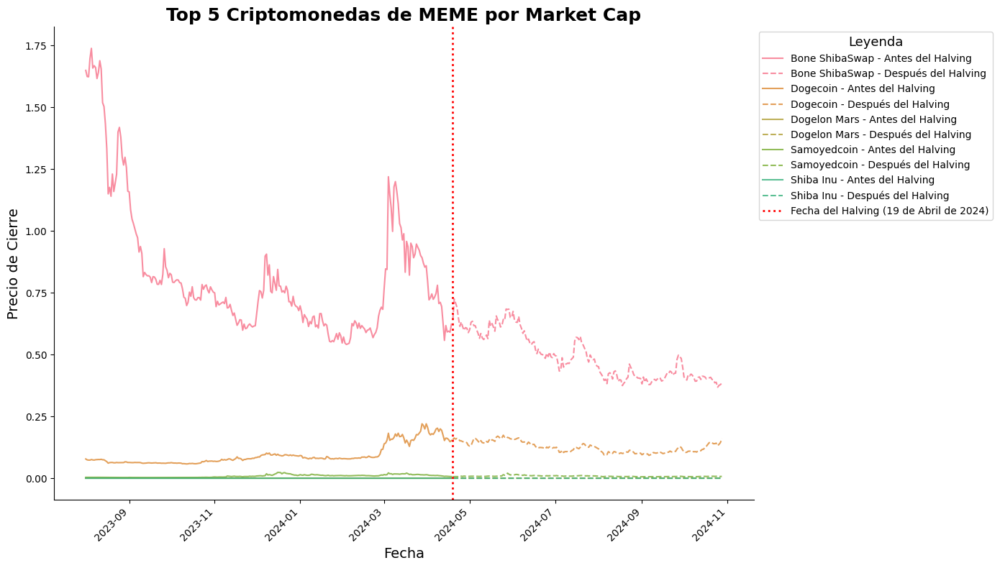

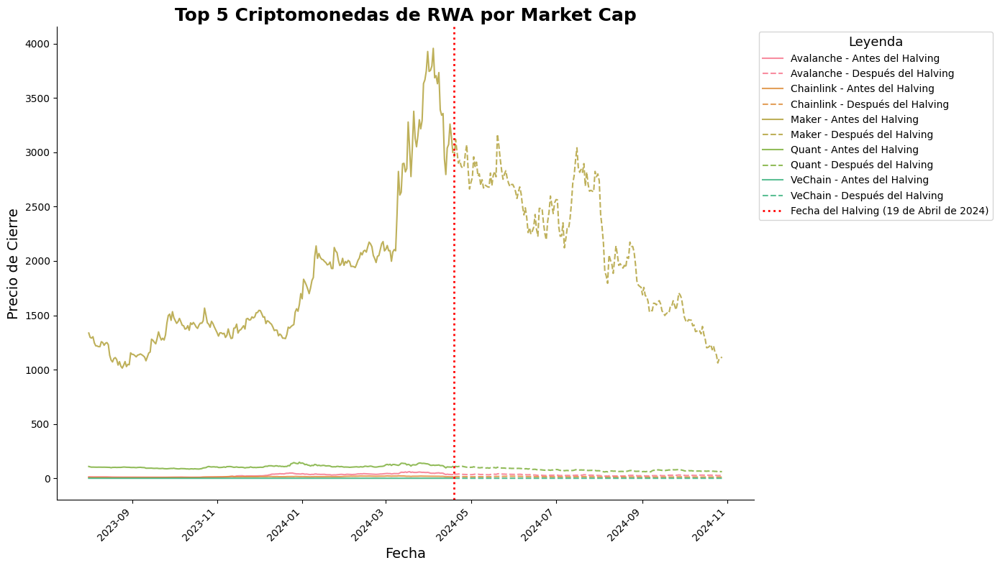

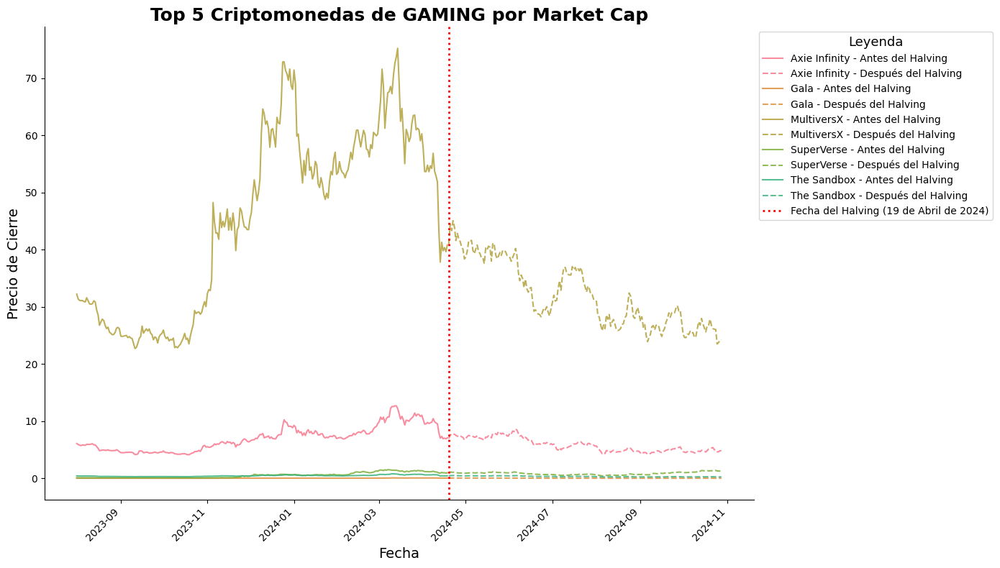

In [27]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en un rango de fechas con el evento del halving
plot_date_halving(df_ai['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de AI por Market Cap")
plot_date_halving(df_meme['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de MEME por Market Cap")
plot_date_halving(df_rwa['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de RWA por Market Cap")
plot_date_halving(df_gaming['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de GAMING por Market Cap")

En cada gráfica, la línea roja vertical representa la fecha del halving, el 19 de abril de 2024, y se diferencia el comportamiento antes y después de este evento mediante líneas sólidas y punteadas.

En la categoría de criptomonedas de IA, se observa una volatilidad significativa en los precios, especialmente en tokens como DeXe y Render. Antes del halving, estas criptomonedas muestran una tendencia al alza que podría estar impulsada por el interés creciente en los proyectos de IA, que suele atraer a especuladores en el sector. Sin embargo, después del halving, los precios parecen estabilizarse, aunque aún presentan fluctuaciones moderadas.

En cuanto a las criptomonedas MEME, la volatilidad es aún más marcada antes del halving, especialmente en Bone ShibaSwap, que presenta fluctuaciones extremas. Después del halving, los precios de estos tokens parecen estabilizarse ligeramente, aunque el mercado sigue siendo volátil.

En el caso de las criptomonedas RWA (respaldadas por activos del mundo real), se observa un comportamiento mucho más estable comparado con las categorías anteriores. Antes del halving, Avalanche y Chainlink mantienen una tendencia moderada al alza, reflejando la estabilidad que suele acompañar a las criptomonedas con respaldo en activos físicos. Tras el halving, hay una leve corrección a la baja, pero las fluctuaciones permanecen contenidas.

Por último, en la categoría de criptomonedas GAMING, los tokens como Axie Infinity y MultiversX muestran una alta volatilidad antes del halving, con picos pronunciados probablemente ligados al lanzamiento o popularidad de juegos específicos. Después del halving, aunque la fluctuación en los precios se modera, todavía se observa una tendencia a la baja en el sector.

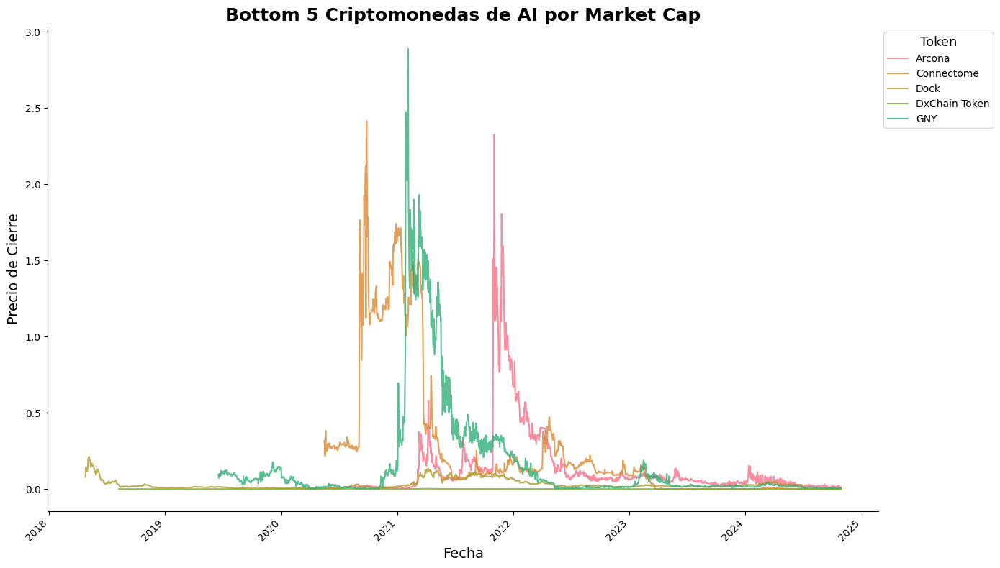

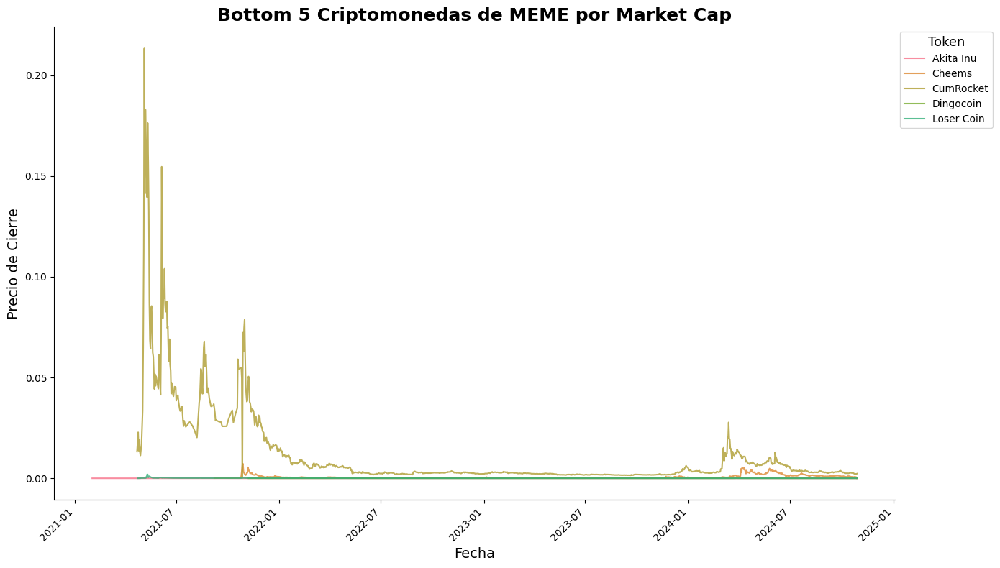

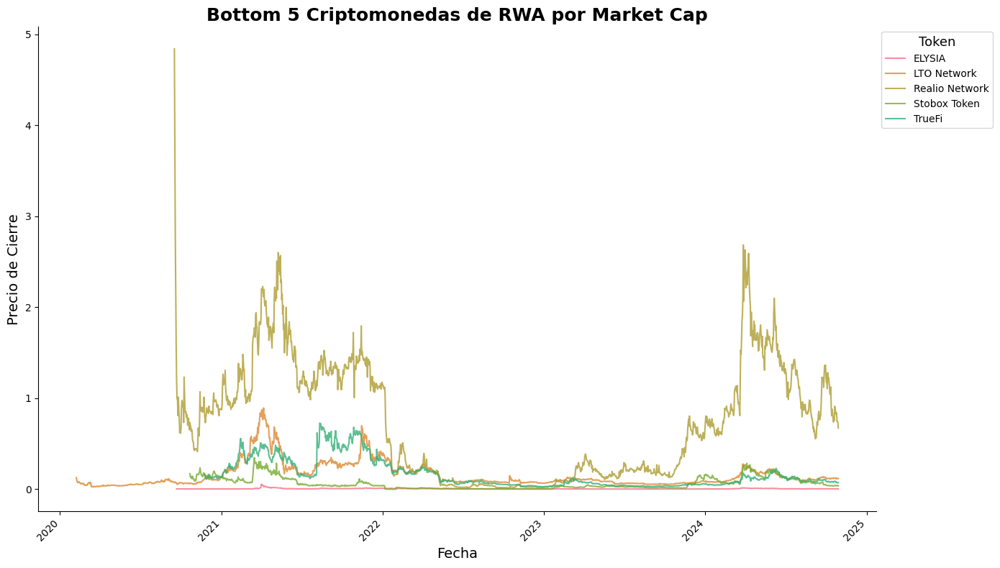

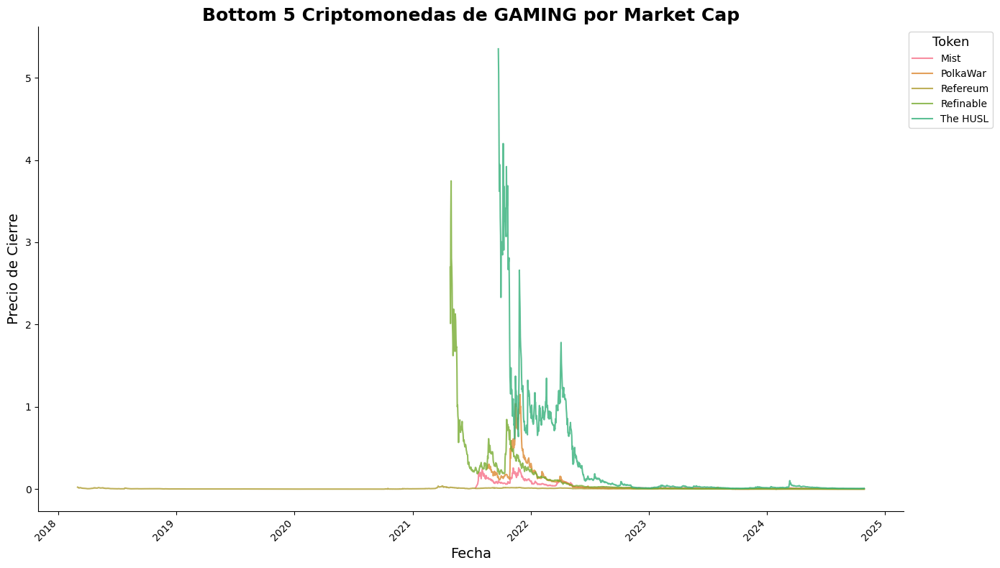

In [28]:
# Precio de Cierre de las 5 criptomonedas con menor Market Cap en cada categoría
plot_price(df_ai['bottom'], "Bottom 5 Criptomonedas de AI por Market Cap")
plot_price(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME por Market Cap")
plot_price(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA por Market Cap")
plot_price(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING por Market Cap")

En estas gráficas se observan las cinco criptomonedas de menor capitalización de mercado en cada categoría. En la categoría de criptomonedas de inteligencia artificial (AI), se observa que tokens como GNY, Connectome y Arcona Token muestran picos de precio significativos en ciertos momentos, especialmente alrededor de 2021 y 2022. Sin embargo, estos picos son seguidos por caídas pronunciadas, lo cual sugiere que el interés en estos proyectos de AI puede ser temporal y altamente especulativo.

Para las criptomonedas MEME de menor capitalización, la token de CumRocket, revela picos esporádicos que rápidamente retornan a niveles cercanos a cero. Este comportamiento es común en criptomonedas MEME de baja capitalización, pues suelen depender del hype o de tendencias virales en redes sociales para alcanzar valores más altos, pero su sostenibilidad es cuestionable.

En el caso de las criptomonedas respaldadas por activos del mundo real (RWA), como Stobox y ELYSIA, se observa un comportamiento un tanto más estable comparado con las MEME, pero igualmente con importantes fluctuaciones.

Por último, en el grupo de criptomonedas de GAMING de menor capitalización, como The HUSL y Refinable, se observa un patrón de picos pronunciados hacia el final de 2021 seguidos por caídas rápidas en el precio. Este tipo de comportamiento es típico en el sector gaming en blockchain, donde el éxito de una criptomoneda depende en gran medida de la popularidad del juego asociado. La alta volatilidad en este grupo sugiere que, aunque el sector gaming en blockchain tiene potencial.

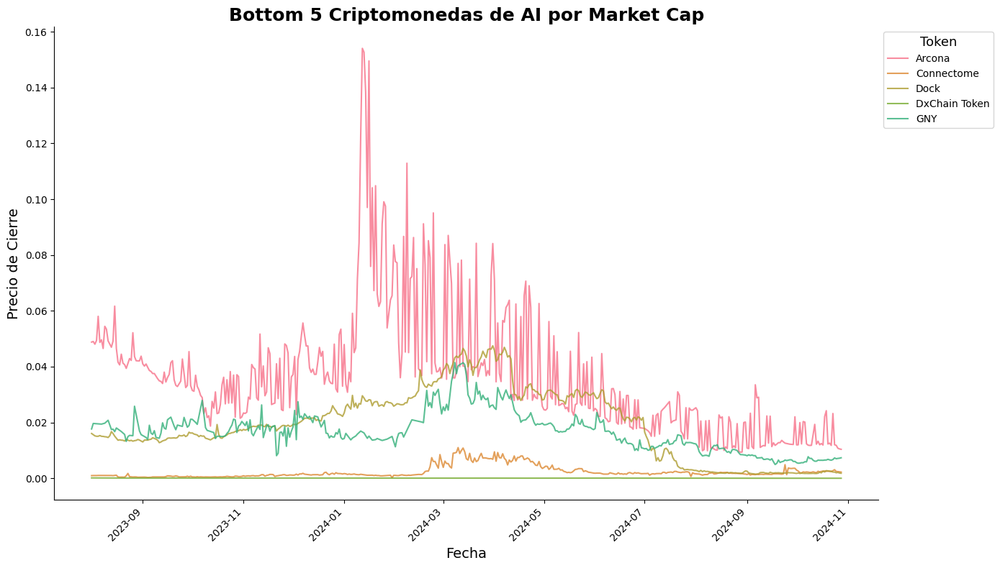

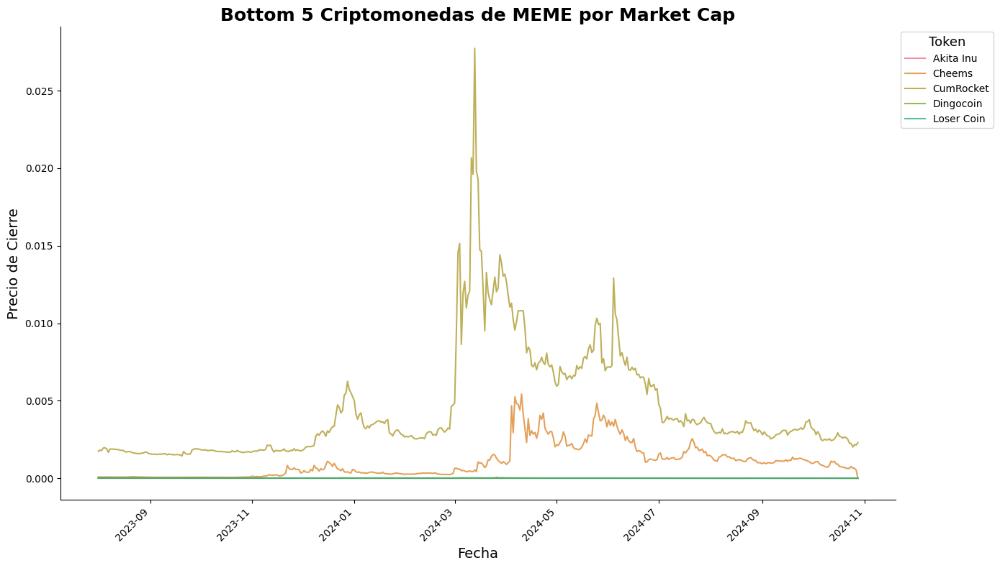

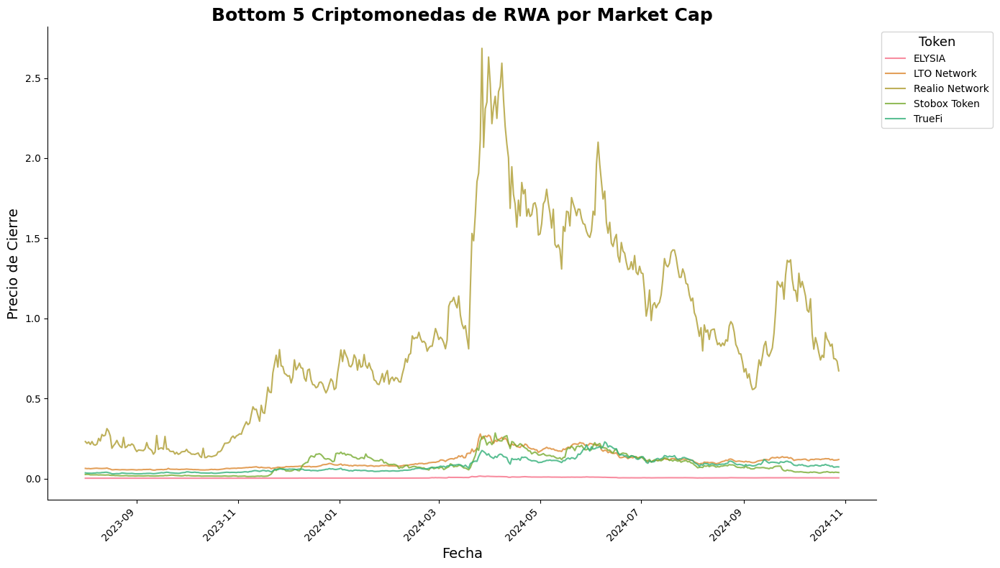

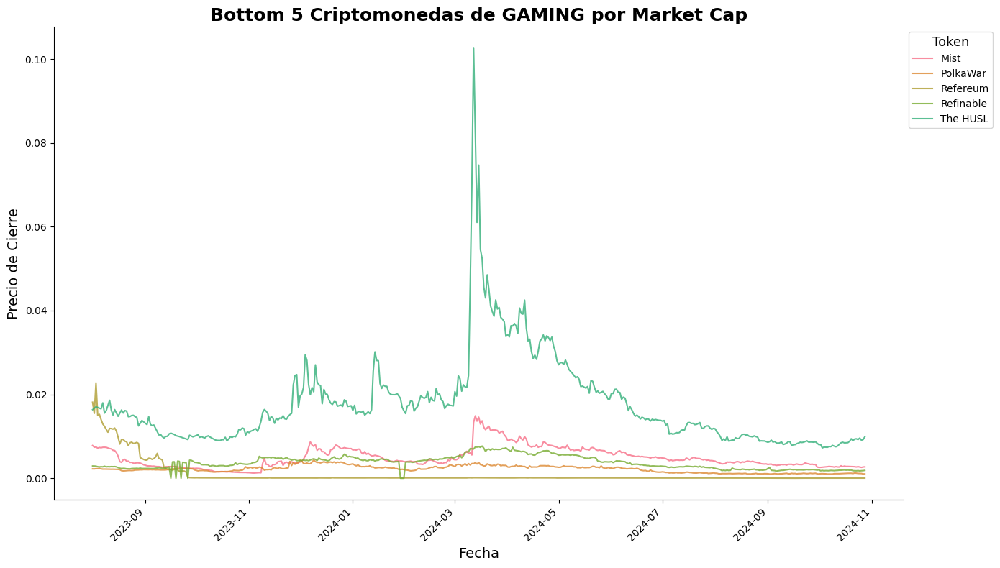

In [29]:
# Precio de Cierre de las 5 criptomonedas con menor Market Cap en un rango de fechas
plot_cryptos_in_range(df_ai['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de AI por Market Cap")
plot_cryptos_in_range(df_meme['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de MEME por Market Cap")
plot_cryptos_in_range(df_rwa['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de RWA por Market Cap")
plot_cryptos_in_range(df_gaming['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de GAMING por Market Cap")

En estas gráficas, se observa la evolución de los precios de cierre de las criptomonedas con menor capitalización de mercado, en el rango de fechas especificado. Cada una de estas categorías muestra una volatilidad distinta, aunque en general, las criptomonedas con menor market cap suelen tener precios más fluctuantes debido a su menor liquidez y menor estabilidad en comparación con las de mayor capitalización.

En el caso de las criptomonedas de IA, se nota que tokens como Arcona, Connectome y GNY presentan un comportamiento inestable, con picos significativos seguidos de caídas abruptas. Estos movimientos son comunes en tokens de menor capitalización, ya que suelen estar más expuestos a la especulación y a cambios de interés por parte de los inversores. A diferencia de las criptomonedas de IA de mayor market cap, estas monedas reflejan un comportamiento mucho menos predecible y son más propensas a responder a factores externos de forma abrupta.

Por su parte, las criptomonedas MEME muestran una volatilidad notable, aunque en un rango de precios generalmente bajo, lo cual es característico en este tipo de activos debido a su naturaleza especulativa. Tokens como Akita Inu y Cheems exhiben aumentos repentinos que pueden deberse a campañas virales o a cambios temporales en el interés de la comunidad, pero su valor tiende a estabilizarse rápidamente en niveles bajos.

En la categoría de RWA, los tokens de menor capitalización, como ELYSIA y TrueFi, también presentan una serie de fluctuaciones, aunque en general son menos pronunciadas que en otras categorías. Esto podría ser un reflejo de la conexión de estos activos con el respaldo en activos del mundo real, lo que proporciona una capa adicional de estabilidad, aunque no completamente inmune a la volatilidad. Aun así, los picos y valles son menos abruptos que en las criptomonedas MEME o de IA, sugiriendo un comportamiento más moderado.

Finalmente, en el ámbito de los tokens de GAMING de menor capitalización, como Mist y Refereum, se observa una alta volatilidad con picos marcados y caídas pronunciadas, reflejando la dependencia de estos activos de la popularidad de los juegos o proyectos subyacentes. Al igual que en el caso de los tokens MEME, estos precios fluctúan en función de la demanda temporal y del interés de los usuarios, que puede variar de manera considerable en el corto plazo.

In [30]:
df_ai['bottom']['timestamp'].min(), df_meme['bottom']['timestamp'].min(), df_rwa['bottom']['timestamp'].min(), df_gaming['bottom']['timestamp'].min()

(Timestamp('2018-04-25 00:00:00'),
 Timestamp('2021-02-01 00:00:00'),
 Timestamp('2020-02-07 00:00:00'),
 Timestamp('2018-03-02 00:00:00'))

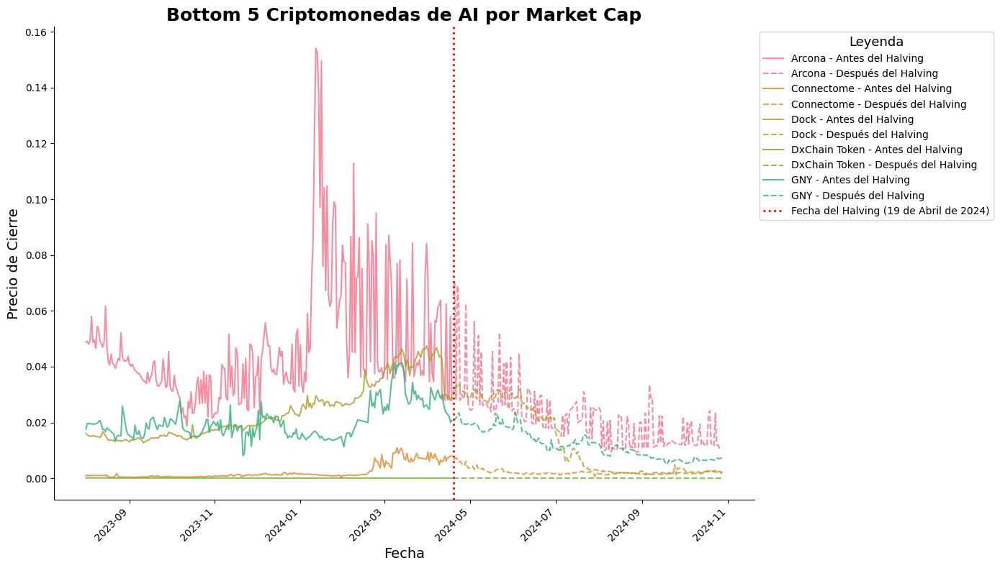

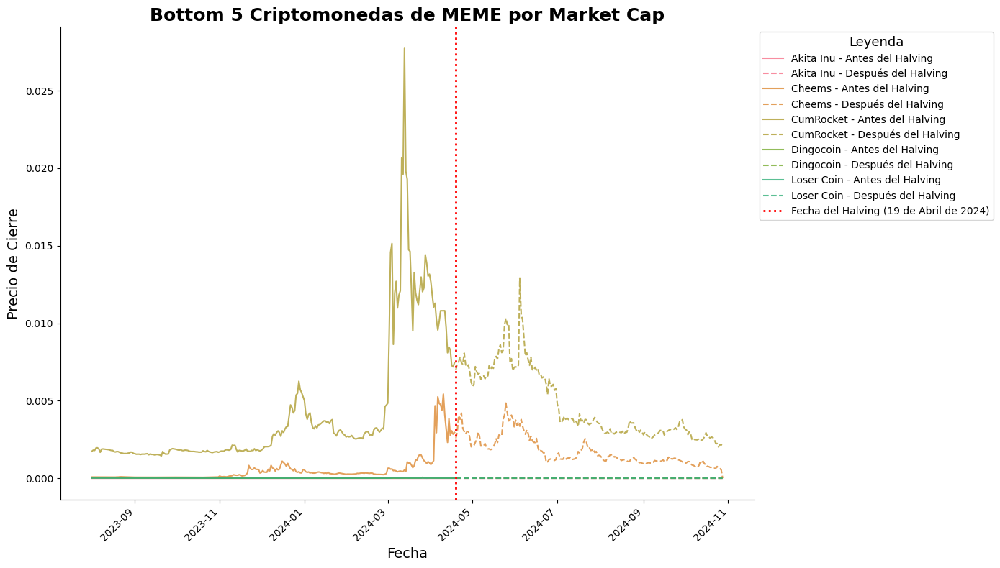

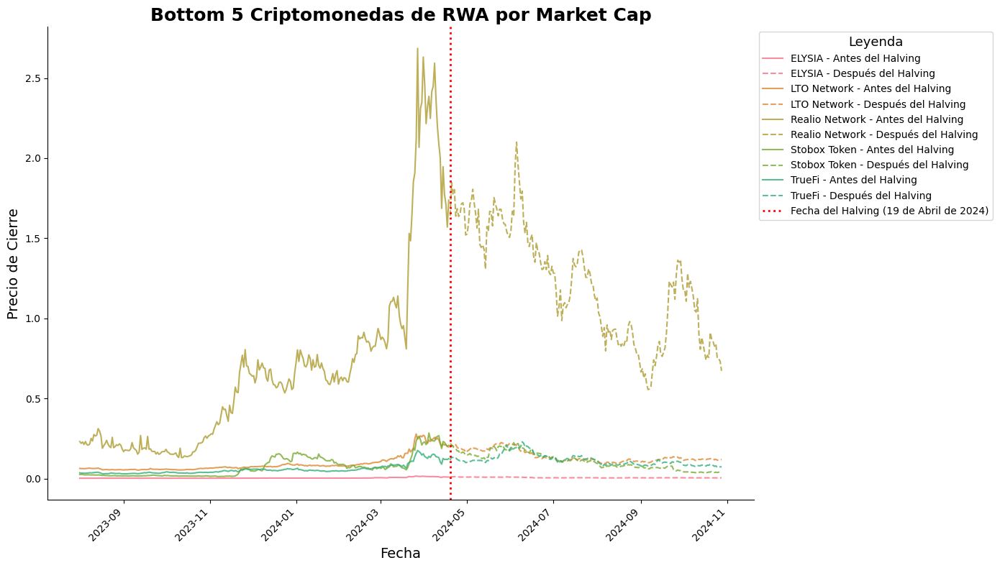

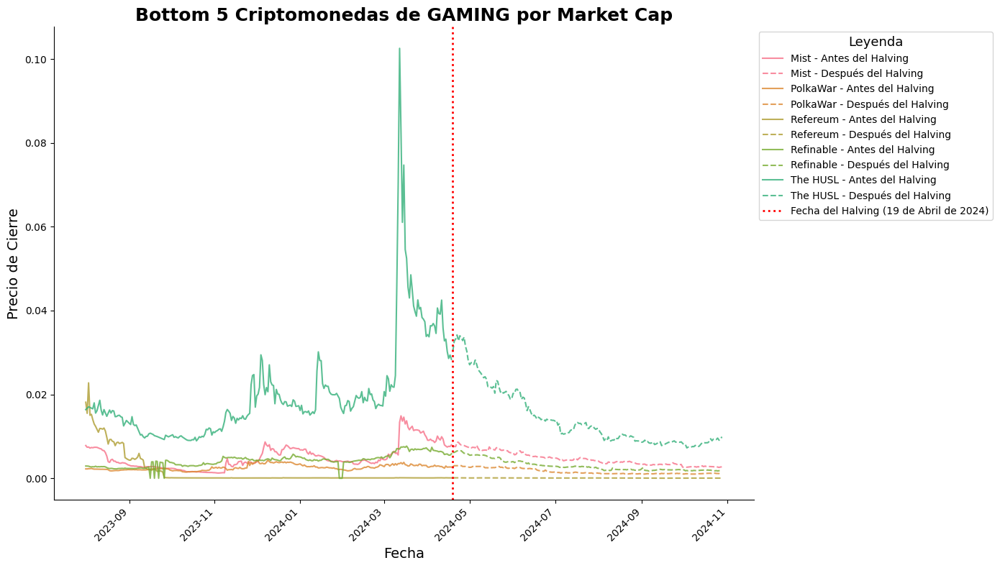

In [31]:
# Precio de Cierre de las 5 criptomonedas con menor Market Cap en un rango de fechas con el evento del halving
plot_date_halving(df_ai['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de AI por Market Cap")
plot_date_halving(df_meme['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de MEME por Market Cap")
plot_date_halving(df_rwa['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de RWA por Market Cap")
plot_date_halving(df_gaming['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de GAMING por Market Cap")

En estas gráficas se muestra la evolución de las criptomonedas con menor capitalización de mercado en las 4 categorías, diferenciando los períodos antes y después del halving, que ocurrió el 19 de abril de 2024.

En la gráfica de las criptomonedas de AI, vemos que los tokens como Arcona experimentaron una notable volatilidad antes del halving, con picos de precios que luego se suavizan tras el evento. Los otros tokens, como Connectome y Dock, presentan movimientos de precios más moderados y no parecen reaccionar de manera tan intensa al halving.

Para las criptomonedas MEME de menor market cap, como Cheems y CumRocket, se observa que estos tokens mantienen una variabilidad constante antes del halving, pero tienden a estabilizarse a valores muy bajos tras el evento.

En el caso de las criptomonedas de RWA con menor capitalización, como TrueFi y Stobox Token, se muestra una mayor estabilidad en comparación con las categorías AI y MEME, aunque también experimentan fluctuaciones más amplias antes del halving. Estas criptomonedas parecen mantenerse relativamente estables en el largo plazo, posiblemente debido a su respaldo en activos del mundo real, lo cual proporciona un nivel adicional de seguridad para los inversionistas. Sin embargo, después del halving, hay una ligera tendencia a la baja, reflejando tal vez una disminución en el interés especulativo.

Por último, en el sector de criptomonedas de GAMING, observamos que tokens como The HUSL y Mist presentaron picos significativos antes del halving, lo cual podría deberse al impacto de lanzamientos o eventos en el ecosistema de juegos en blockchain. No obstante, después del halving, estos tokens muestran una tendencia descendente o se estabilizan en niveles bajos, lo que sugiere que el entusiasmo inicial no fue sostenible. La volatilidad característica de esta categoría también es evidente, siendo esta una constante en el sector de juegos en blockchain debido a la dependencia de la popularidad de títulos específicos o el interés en el metaverso.

Autocorrelación

In [32]:
def autocorrelacion(df, title, max_lags=365, palette=palette):
    for i, (name, group) in enumerate(df.groupby('name')):
        plt.figure(figsize=(12, 6))
        
        # Seleccionar el color de la paleta para cada criptomoneda
        color = palette[i % len(palette)]
        
        # Definir el número de rezagos (lags) a mostrar, limitado por el tamaño de los datos
        lags = min(max_lags, len(group['close']) - 1)
        
        # Crear gráfico de autocorrelación con el color de la paleta
        plot_acf(group['close'], lags=lags, alpha=0.05,
                title=f'Autocorrelación para {name} - {title}',
                zero=False, color=color, vlines_kwargs={'colors': color})
        
        # Configuración del título y etiquetas de ejes
        plt.title(f'Autocorrelación para {name} - {title}', fontsize=16, fontweight='bold', pad=25)
        plt.xlabel('Rezagos', fontsize=14)
        plt.ylabel('Autocorrelación', fontsize=14)
        
        # Ajustes adicionales en el gráfico
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        
        # Agregar línea de referencia horizontal
        plt.axhline(y=0, color='gray', linestyle='--', linewidth=1)
        
        # Eliminar bordes superiores y derechos para un diseño más limpio
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        # Ajustar el diseño y mostrar el gráfico
        plt.tight_layout()
        plt.show()

<Figure size 1200x600 with 0 Axes>

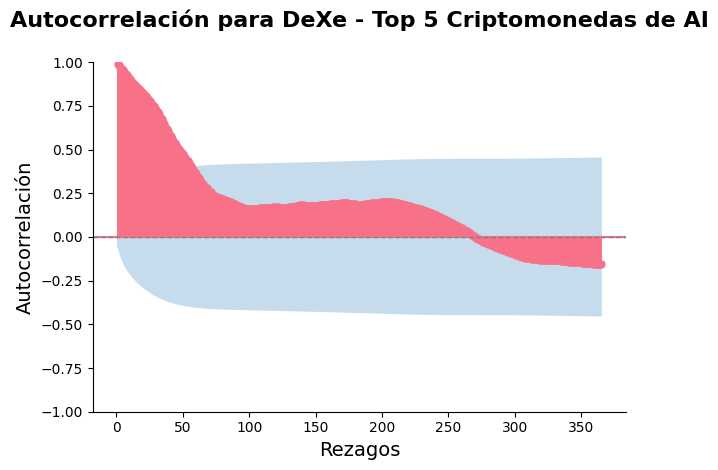

<Figure size 1200x600 with 0 Axes>

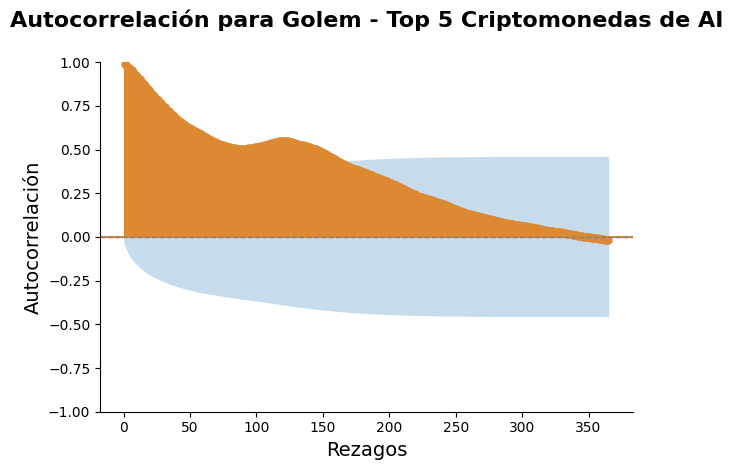

<Figure size 1200x600 with 0 Axes>

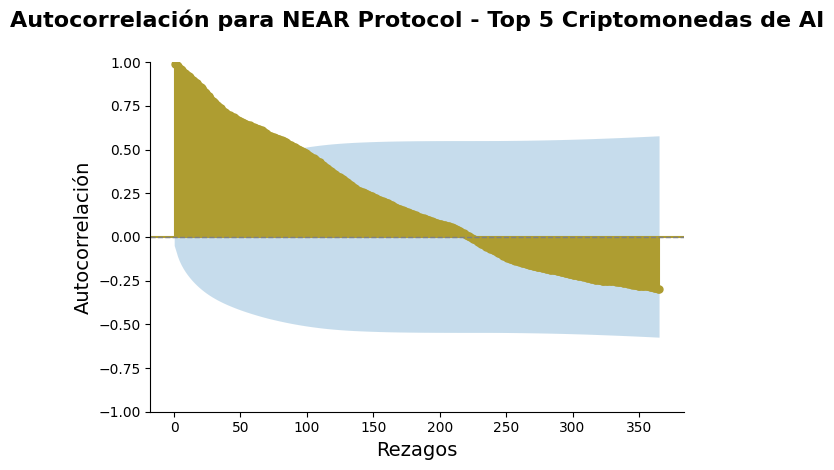

<Figure size 1200x600 with 0 Axes>

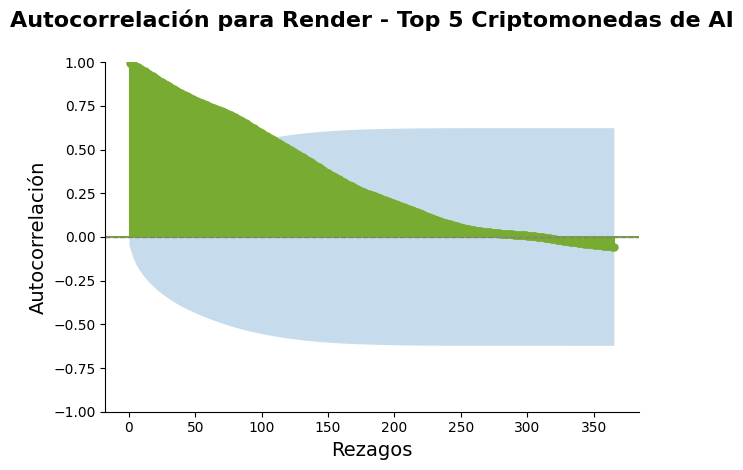

<Figure size 1200x600 with 0 Axes>

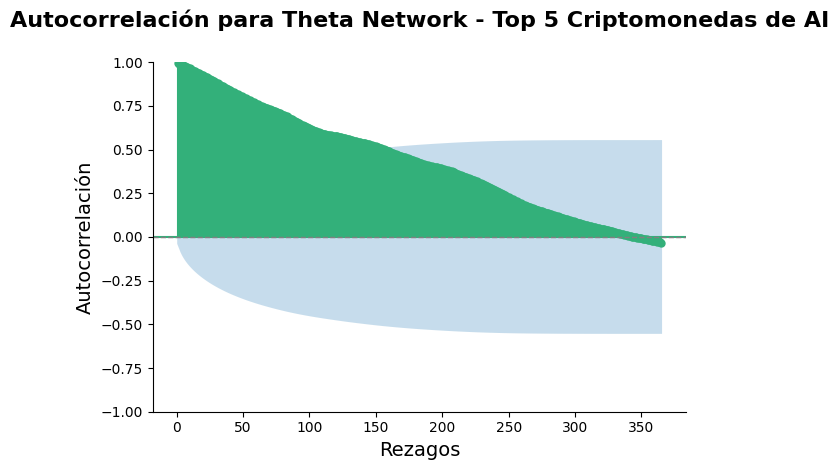

<Figure size 1200x600 with 0 Axes>

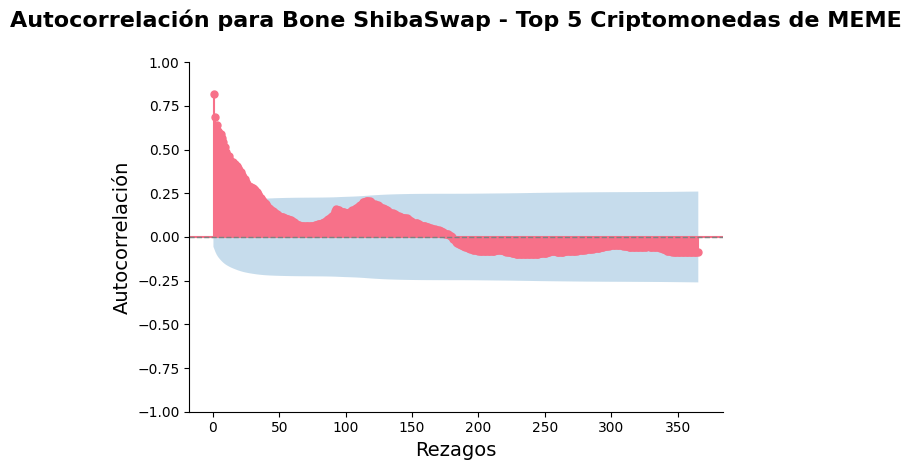

<Figure size 1200x600 with 0 Axes>

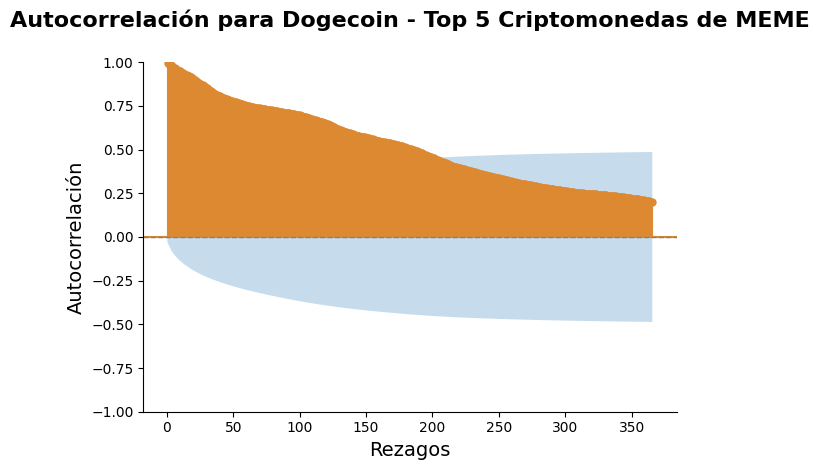

<Figure size 1200x600 with 0 Axes>

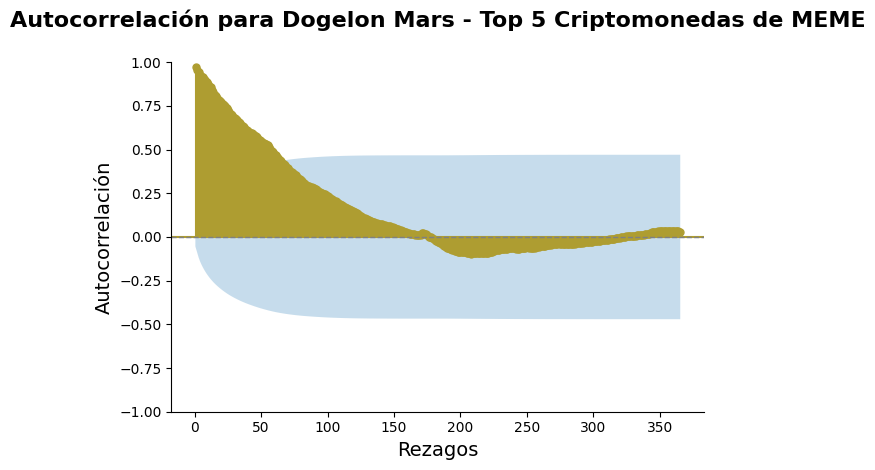

<Figure size 1200x600 with 0 Axes>

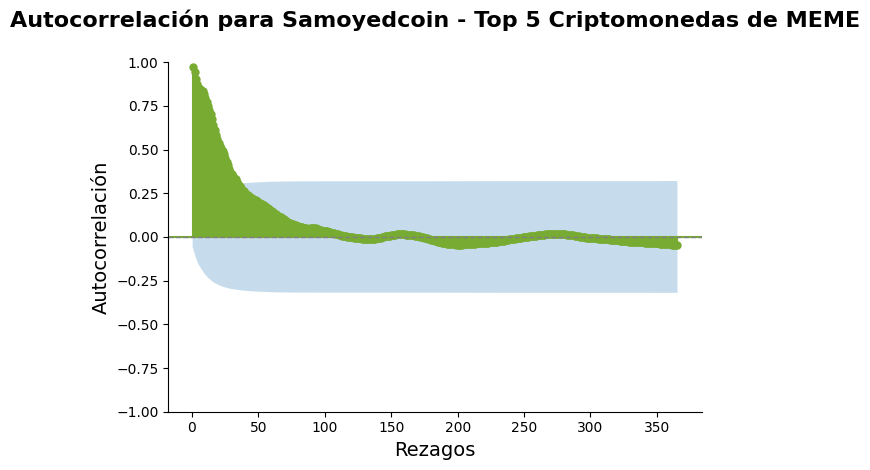

<Figure size 1200x600 with 0 Axes>

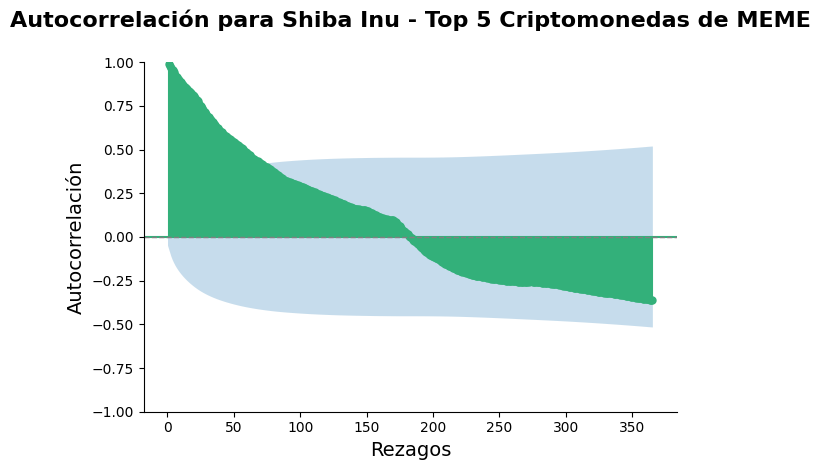

<Figure size 1200x600 with 0 Axes>

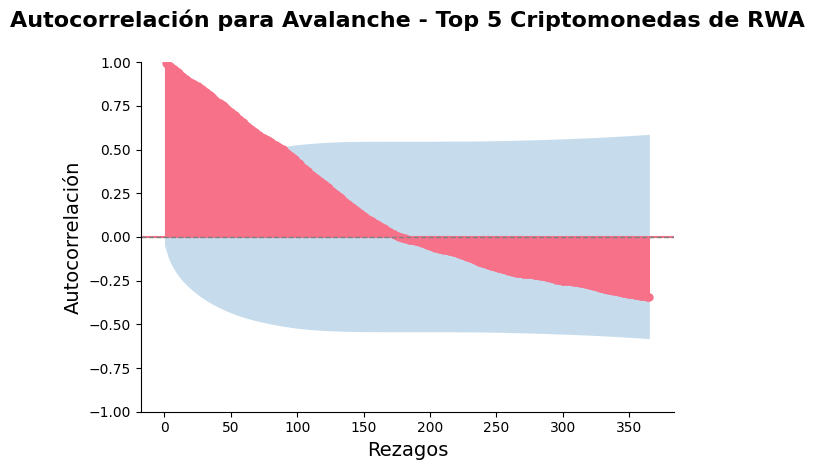

<Figure size 1200x600 with 0 Axes>

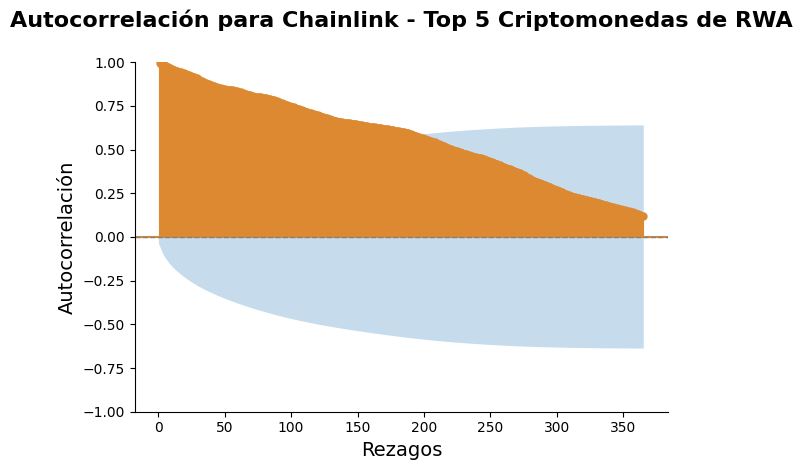

<Figure size 1200x600 with 0 Axes>

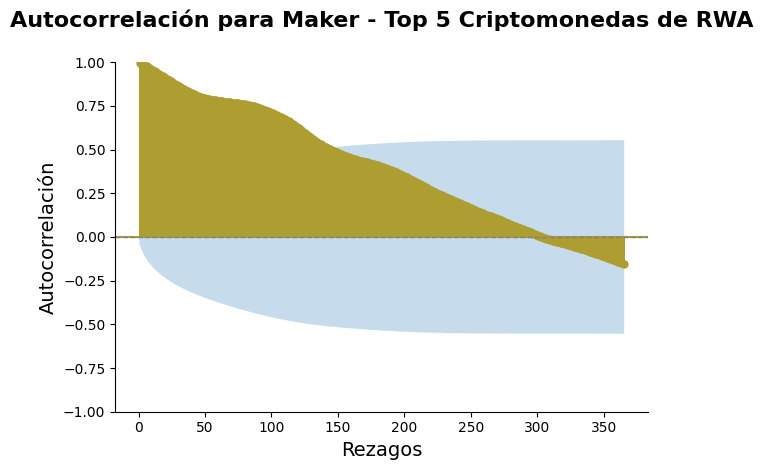

<Figure size 1200x600 with 0 Axes>

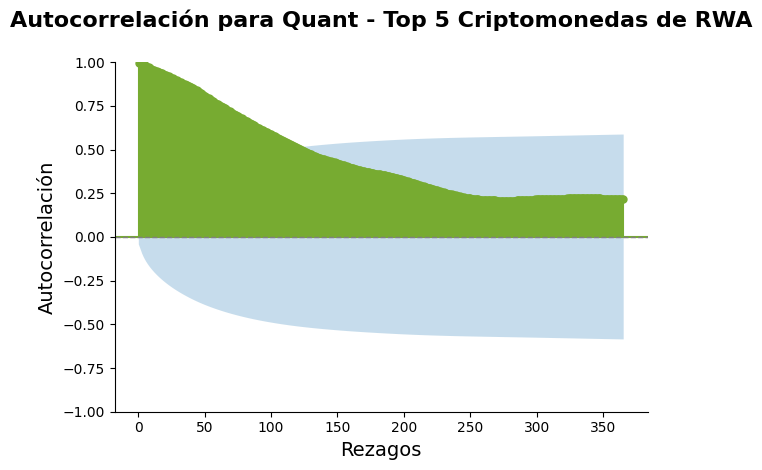

<Figure size 1200x600 with 0 Axes>

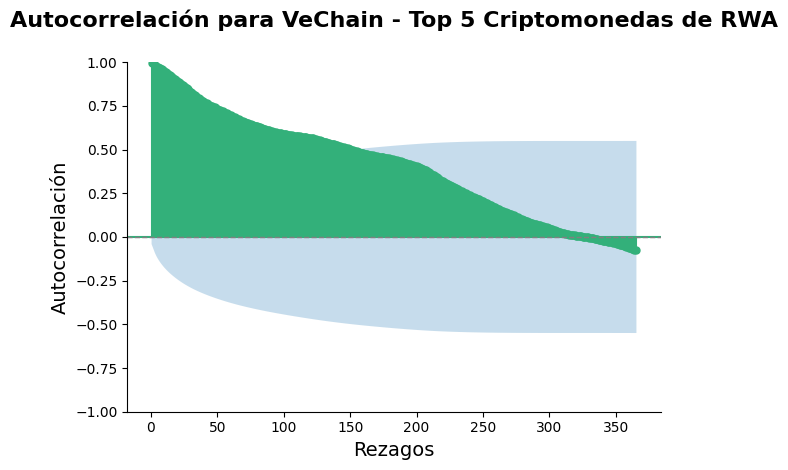

<Figure size 1200x600 with 0 Axes>

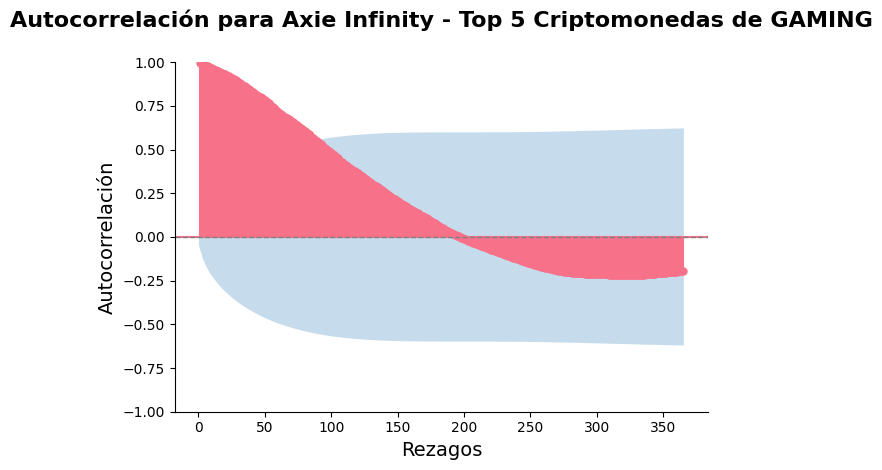

<Figure size 1200x600 with 0 Axes>

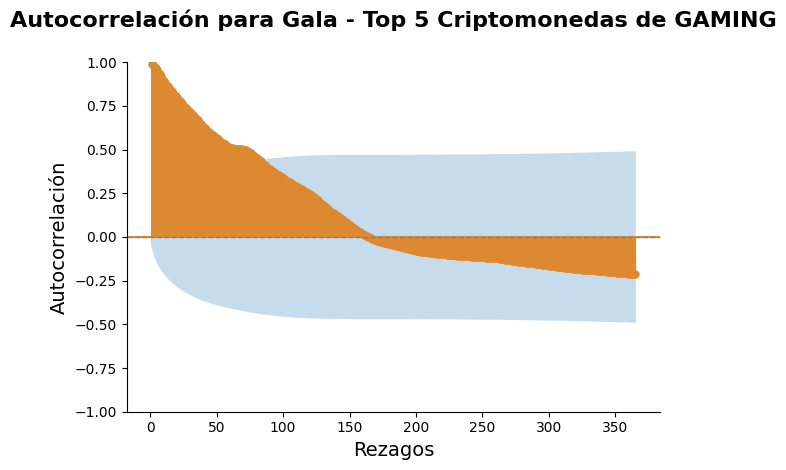

<Figure size 1200x600 with 0 Axes>

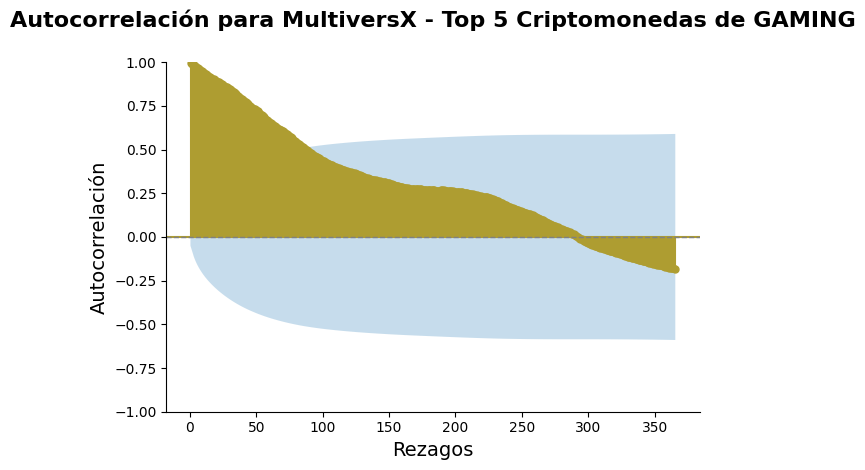

<Figure size 1200x600 with 0 Axes>

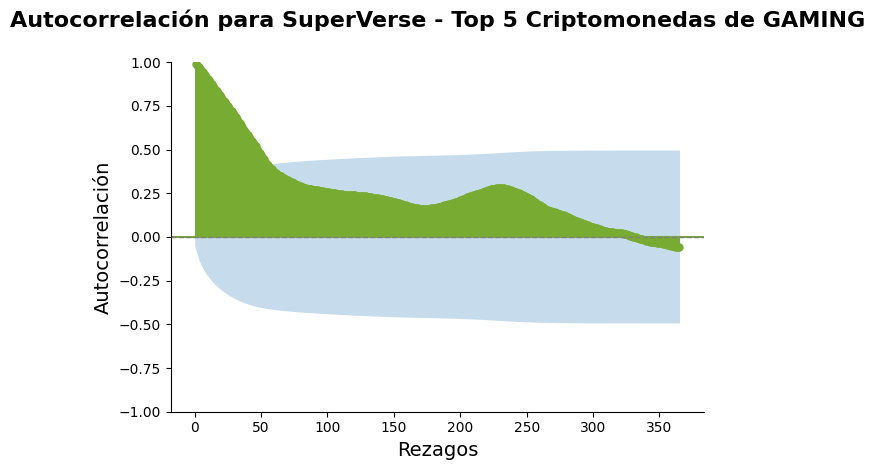

<Figure size 1200x600 with 0 Axes>

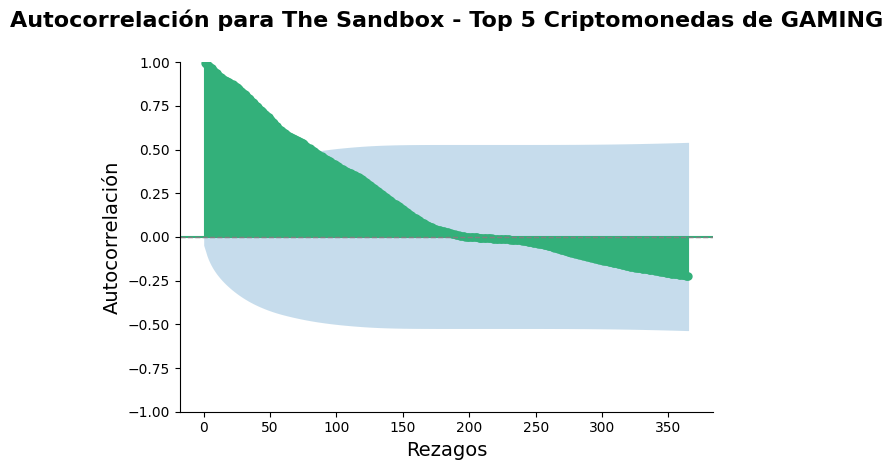

In [33]:
autocorrelacion(df_ai['top'], "Top 5 Criptomonedas de AI")
autocorrelacion(df_meme['top'], "Top 5 Criptomonedas de MEME")
autocorrelacion(df_rwa['top'], "Top 5 Criptomonedas de RWA")
autocorrelacion(df_gaming['top'], "Top 5 Criptomonedas de GAMING")

Si miramos estas gráficas, podemos ver cómo el precio de las criptomonedas, ya sean de inteligencia artificial (IA) o memes, tiene una especie de 'memoria corta'. Al principio, los precios de hoy están muy influenciados por lo que pasó ayer o antes de ayer. Pero a medida que pasa el tiempo, esa influencia se va debilitando, y los precios empiezan a ser más independientes.

Por ejemplo, en el caso de DeXe, un proyecto de IA, vemos que esta 'memoria corta' es bastante pronunciada. Los precios de hoy están muy pegados a los de ayer, pero a medida que nos alejamos en el tiempo, esa relación se va perdiendo. Esto nos dice que las criptomonedas de IA suelen ser bastante volátiles en el corto plazo, pero a largo plazo su comportamiento es más impredecible.

<Figure size 1200x600 with 0 Axes>

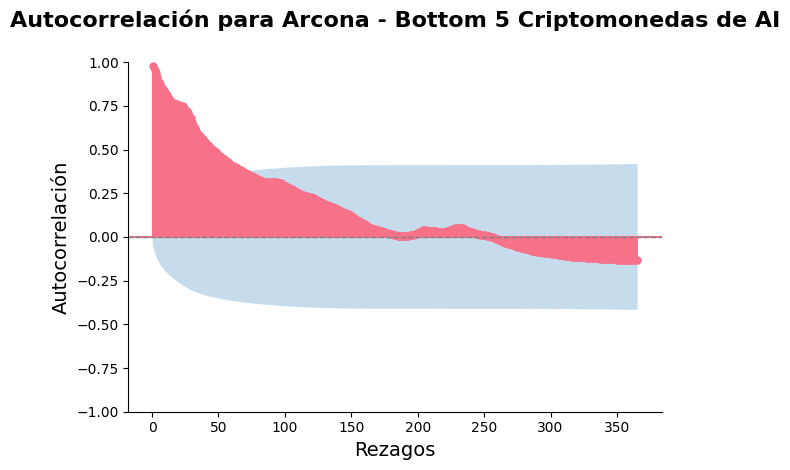

<Figure size 1200x600 with 0 Axes>

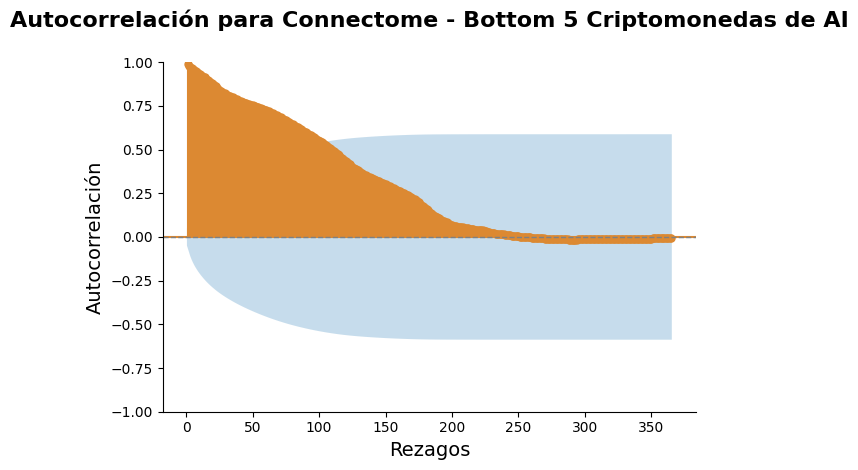

<Figure size 1200x600 with 0 Axes>

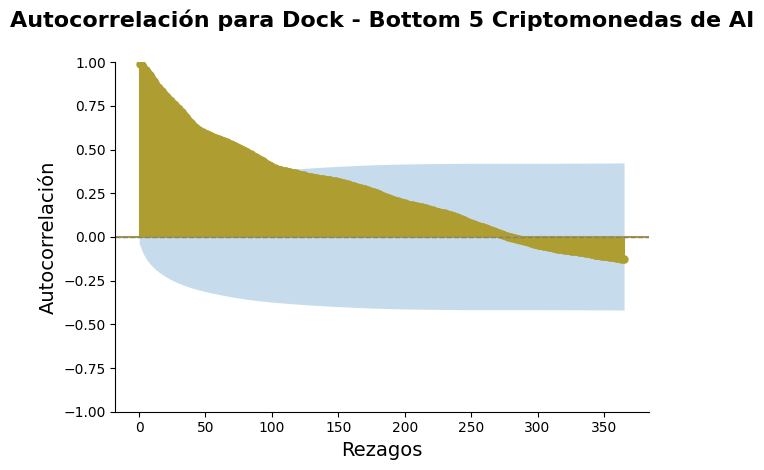

<Figure size 1200x600 with 0 Axes>

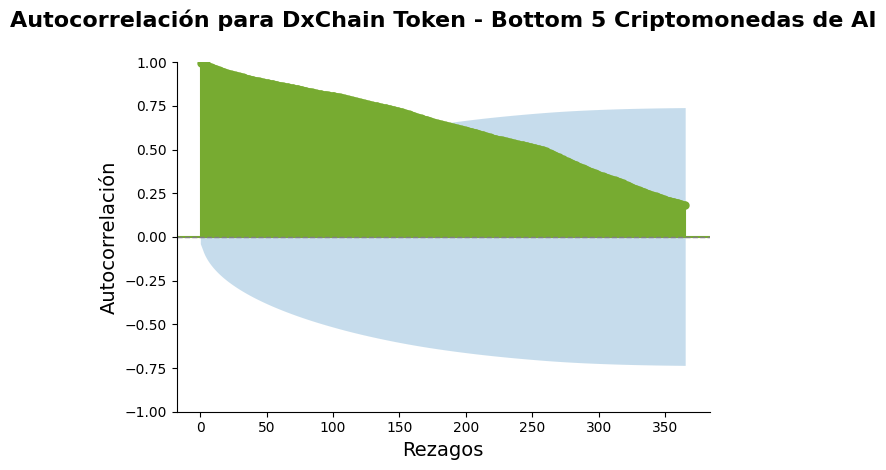

<Figure size 1200x600 with 0 Axes>

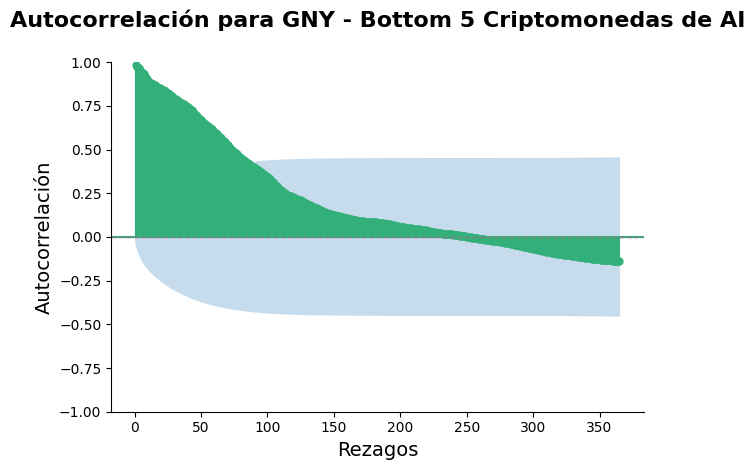

<Figure size 1200x600 with 0 Axes>

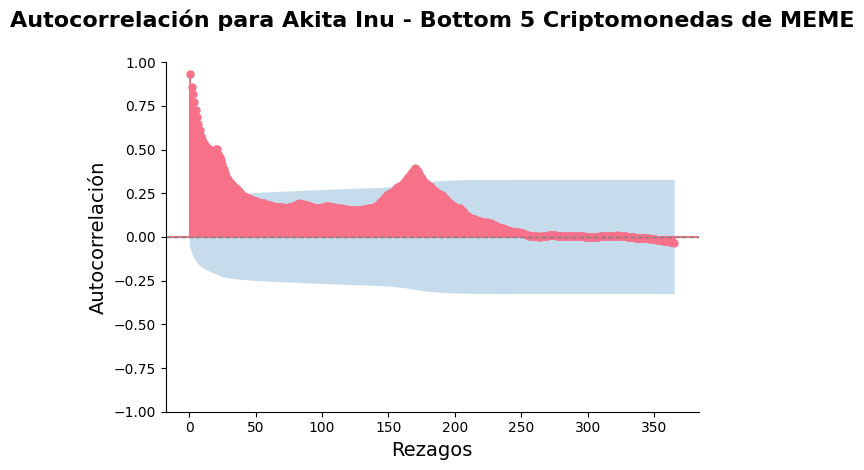

<Figure size 1200x600 with 0 Axes>

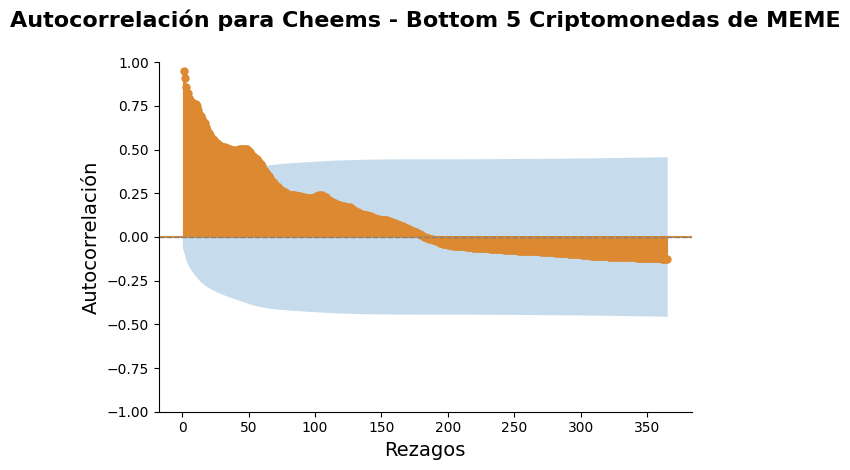

<Figure size 1200x600 with 0 Axes>

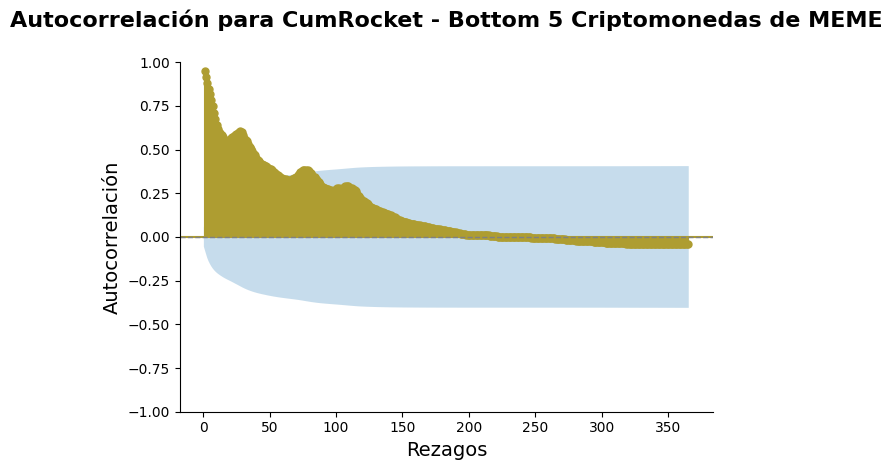

<Figure size 1200x600 with 0 Axes>

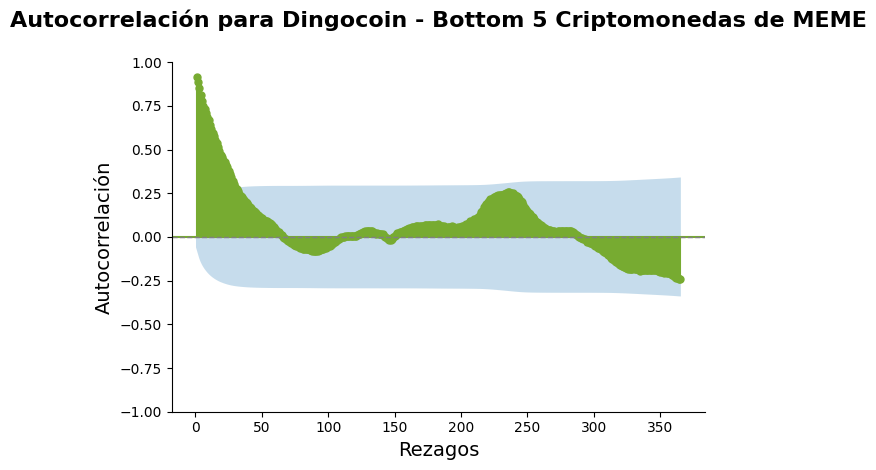

<Figure size 1200x600 with 0 Axes>

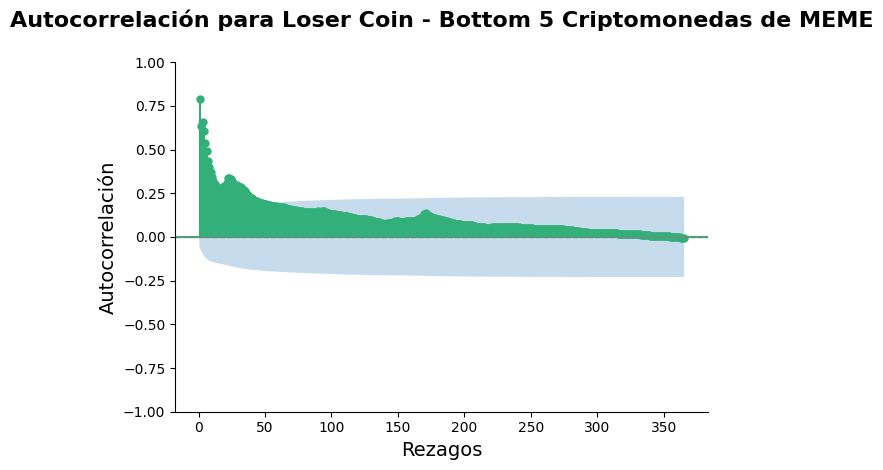

<Figure size 1200x600 with 0 Axes>

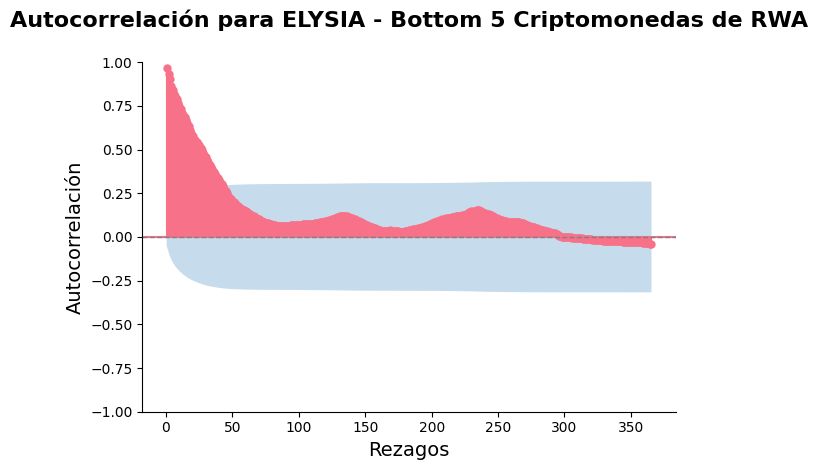

<Figure size 1200x600 with 0 Axes>

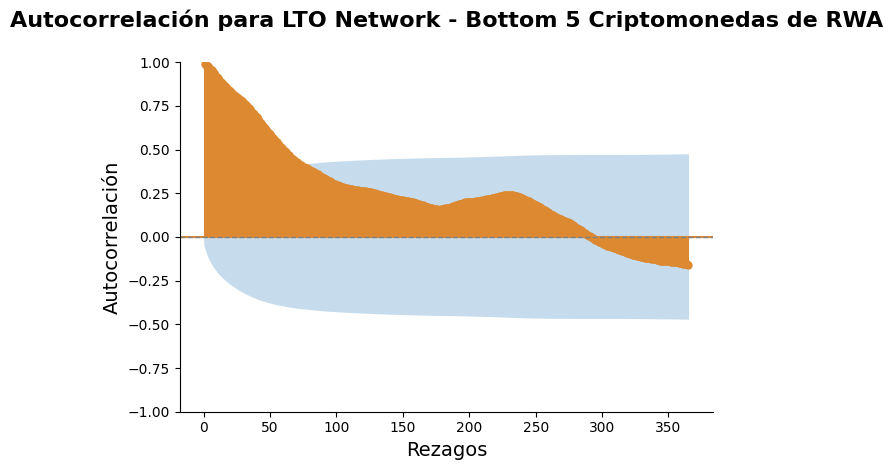

<Figure size 1200x600 with 0 Axes>

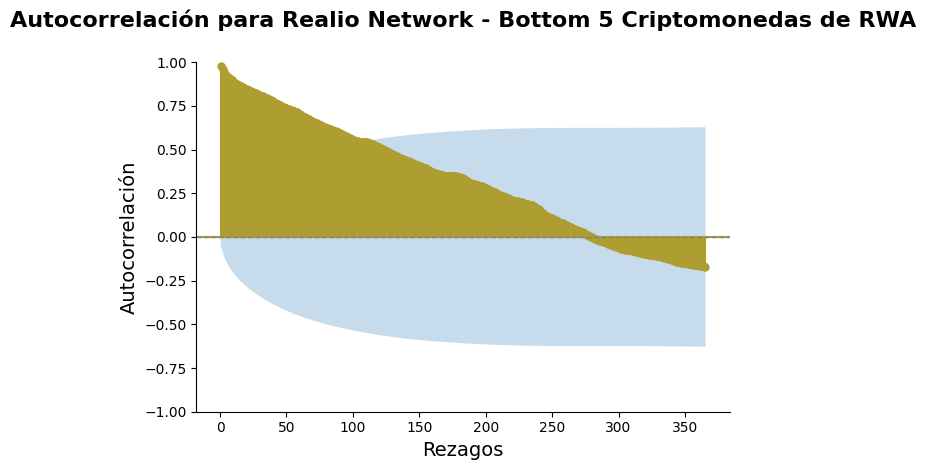

<Figure size 1200x600 with 0 Axes>

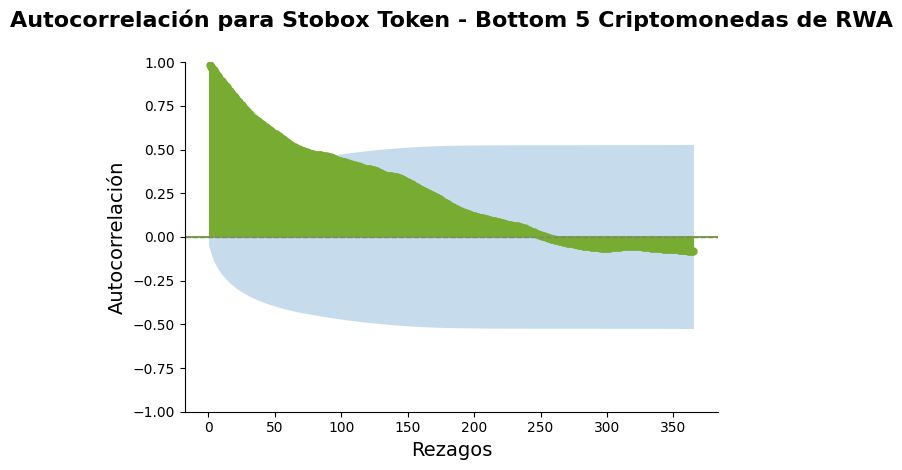

<Figure size 1200x600 with 0 Axes>

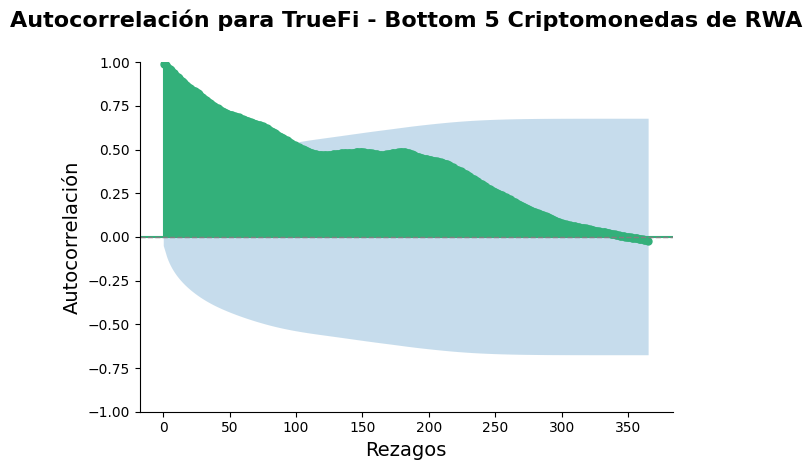

<Figure size 1200x600 with 0 Axes>

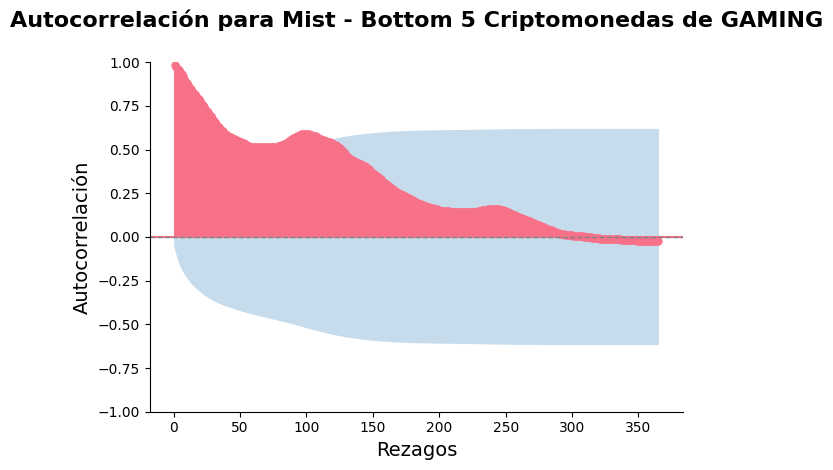

<Figure size 1200x600 with 0 Axes>

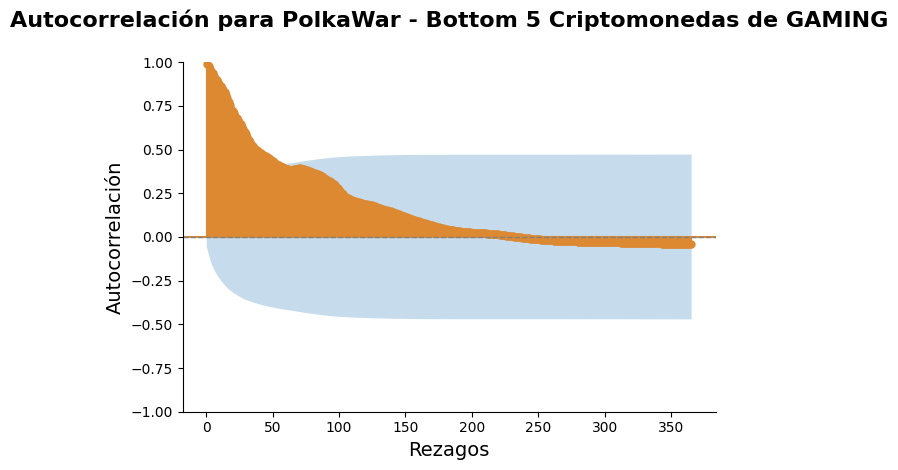

<Figure size 1200x600 with 0 Axes>

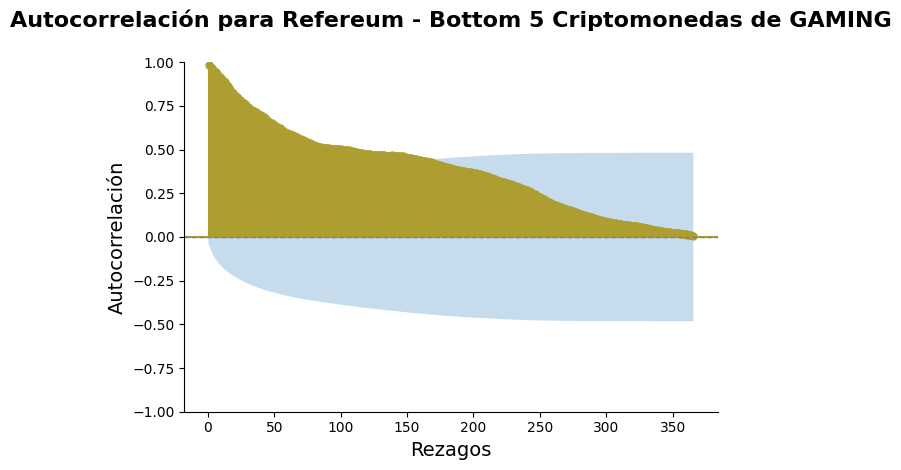

<Figure size 1200x600 with 0 Axes>

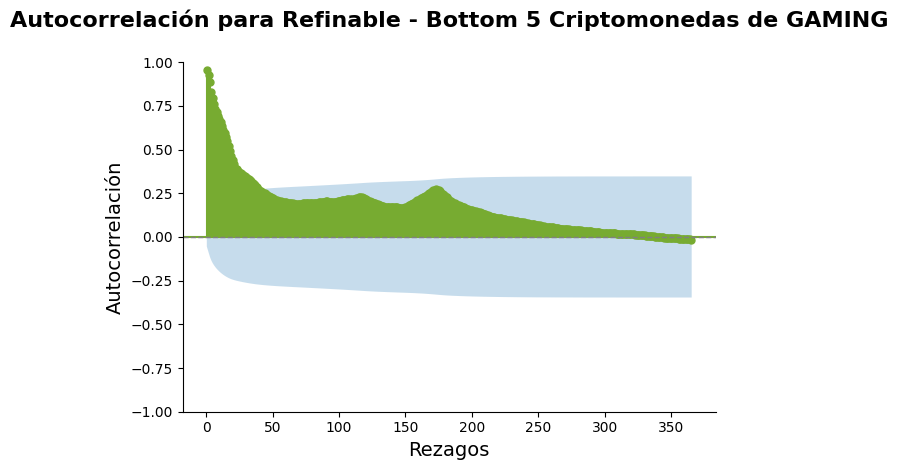

<Figure size 1200x600 with 0 Axes>

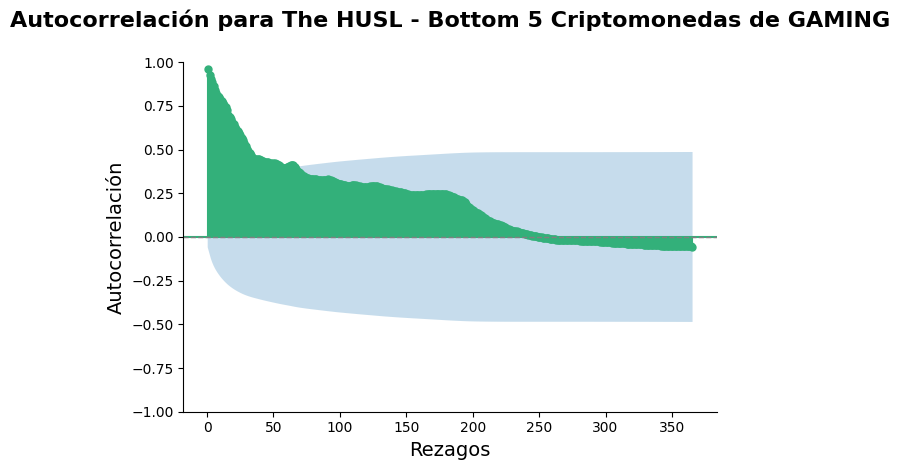

In [34]:
autocorrelacion(df_ai['bottom'], "Bottom 5 Criptomonedas de AI")
autocorrelacion(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME")
autocorrelacion(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA")
autocorrelacion(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING")

En estas gráficas de autocorrelación, podemos observar el comportamiento de diferentes criptomonedas en función del rezago de tiempo. La primera gráfica corresponde a Arcona (Bottom 5 Criptomonedas de AI). Aquí observamos un nivel inicial de autocorrelación alto que disminuye progresivamente con el aumento de rezagos. Esto sugiere que los precios de Arcona están altamente correlacionados en períodos cortos, reflejando una continuidad en sus valores recientes. Sin embargo, a medida que los rezagos aumentan, esta correlación se desvanece, indicando que el precio tiende a perder relación con sus valores pasados.

La siguiente gráfica es de Akita Inu (Bottom 5 Criptomonedas de MEME). En este caso, se observa una alta autocorrelación en los primeros rezagos, con un comportamiento oscilante antes de estabilizarse cerca de cero. Este patrón sugiere cierta persistencia en sus precios a corto plazo, pero también refleja variaciones más abruptas en el mediano plazo, antes de estabilizarse y perder relación con sus valores anteriores.

La gráfica de ELYSIA (Bottom 5 Criptomonedas de RWA) presenta una fuerte autocorrelación inicial que disminuye con el tiempo. Este patrón sugiere que los movimientos recientes de precio son representativos de un período corto, pero su influencia disminuye significativamente en el largo plazo, indicando una pérdida de persistencia en los valores pasados.

Finalmente, la gráfica de PolkaWar (Bottom 5 Criptomonedas de GAMING) muestra un patrón de autocorrelación similar, con una alta correlación en el corto plazo y una disminución constante hacia cero. Este patrón es característico de precios de criptomonedas que presentan cierto nivel de memoria a corto plazo, pero que se diluye con el paso del tiempo.

Medias Móviles de Diferentes Ventanas

In [35]:
import matplotlib.pyplot as plt
import pandas as pd

def media_movel(df, title, palette=palette):
    df = df.copy()
    
    # Convertir 'timestamp' a formato de fecha y establecerlo como índice
    df['date'] = pd.to_datetime(df['timestamp'], unit='s')
    df.set_index('date', inplace=True)
    
    for name, group in df.groupby('name'):
        # Calcular medias móviles
        group['MA_7'] = group['close'].rolling(window=7).mean()
        group['MA_30'] = group['close'].rolling(window=30).mean()
        group['MA_90'] = group['close'].rolling(window=90).mean()
    
        # Crear la figura
        plt.figure(figsize=(12, 6))
        
        # Graficar el precio de cierre y las medias móviles
        plt.plot(group.index, group['close'], label='Precio de Cierre', color="black", linewidth=1.5)
        plt.plot(group.index, group['MA_7'], label='Media Móvil (7 días)', color="purple", linestyle='-', linewidth=1.2)
        plt.plot(group.index, group['MA_30'], label='Media Móvil (30 días)', color="pink", linestyle='-', linewidth=1.2)
        plt.plot(group.index, group['MA_90'], label='Media Móvil (90 días)', color="green", linestyle='-', linewidth=1.2)
        
        # Configuración del título con padding adicional y etiquetas de ejes
        plt.title(f'Medias Móviles de {name} - {title}', fontsize=16, fontweight='bold', pad=15)
        plt.xlabel('Fecha', fontsize=14)
        plt.ylabel('Precio de Cierre', fontsize=14)
        
        # Ajuste de las etiquetas del eje x con formato de fecha
        plt.xticks(rotation=45, ha='right', fontsize=10)
        plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter("%Y-%m-%d"))
        
        # Configuración de la leyenda fuera del área del gráfico
        plt.legend(title="Indicadores", title_fontsize='13', fontsize='10', bbox_to_anchor=(1.05, 1))

        # Agregar bordes suaves al gráfico
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        # Ajustar el diseño y mostrar el gráfico
        plt.tight_layout()
        plt.show()


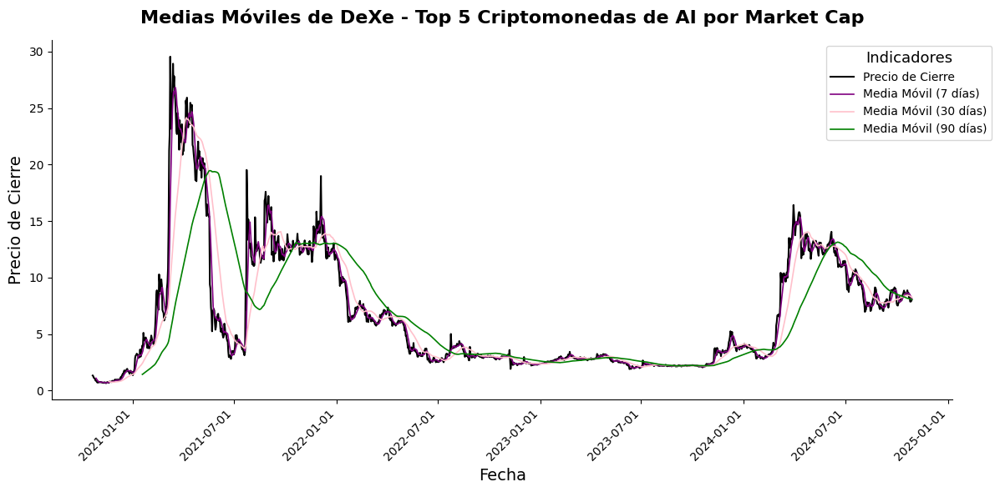

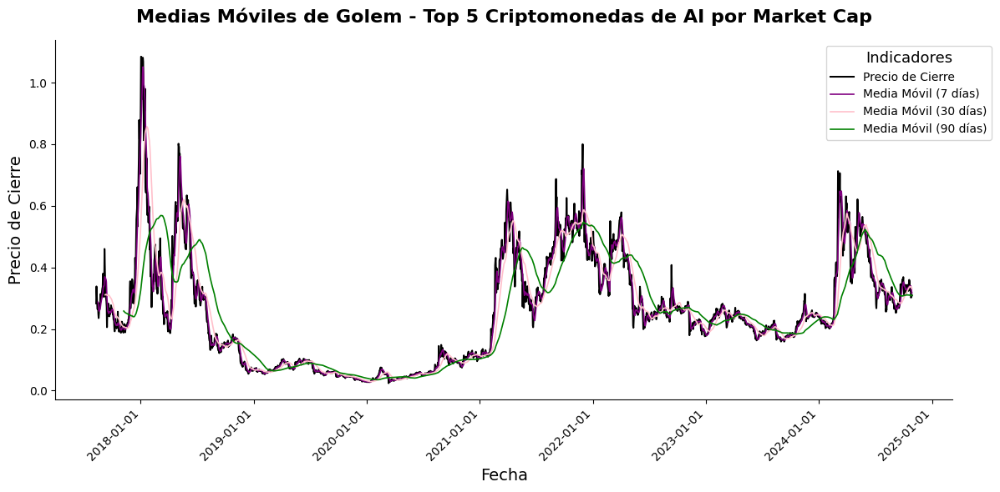

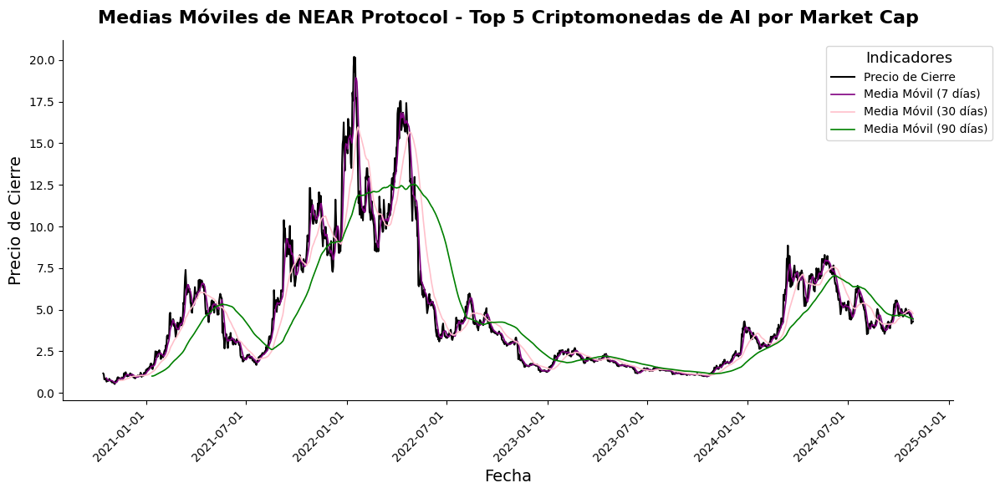

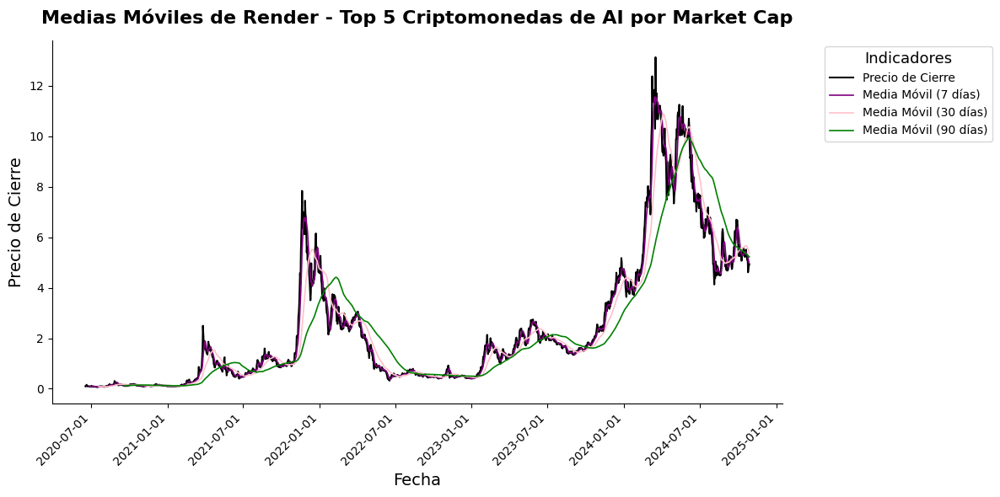

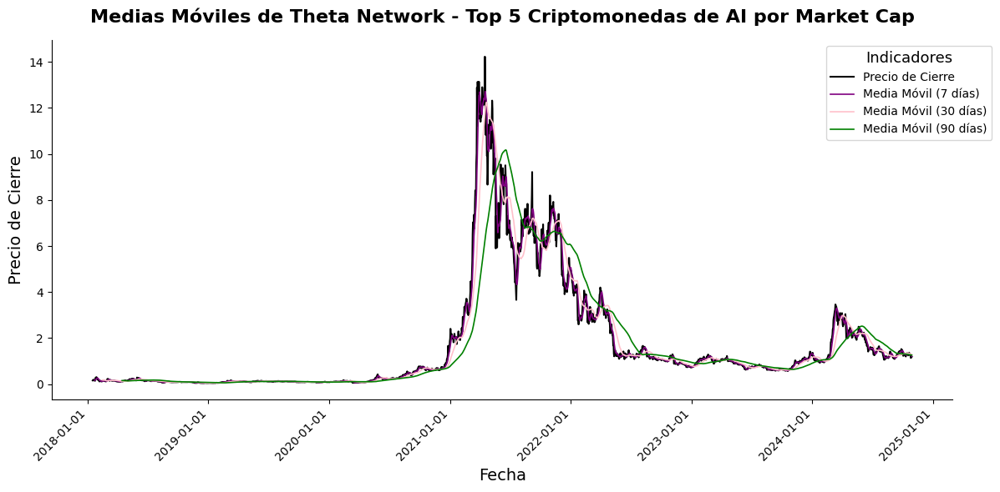

...

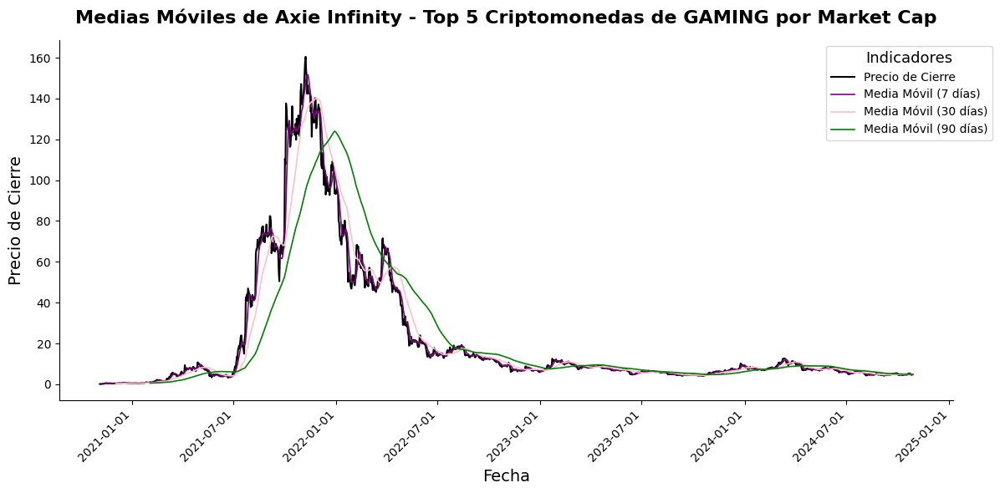

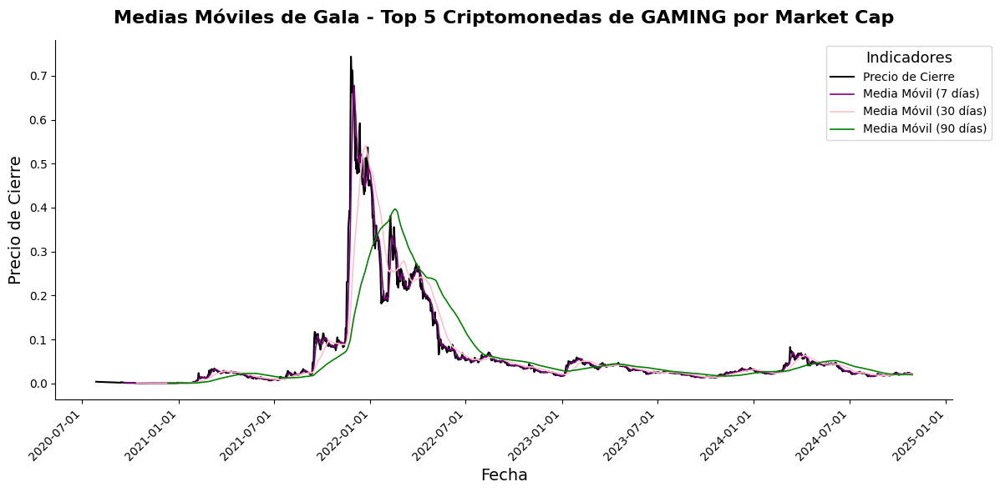

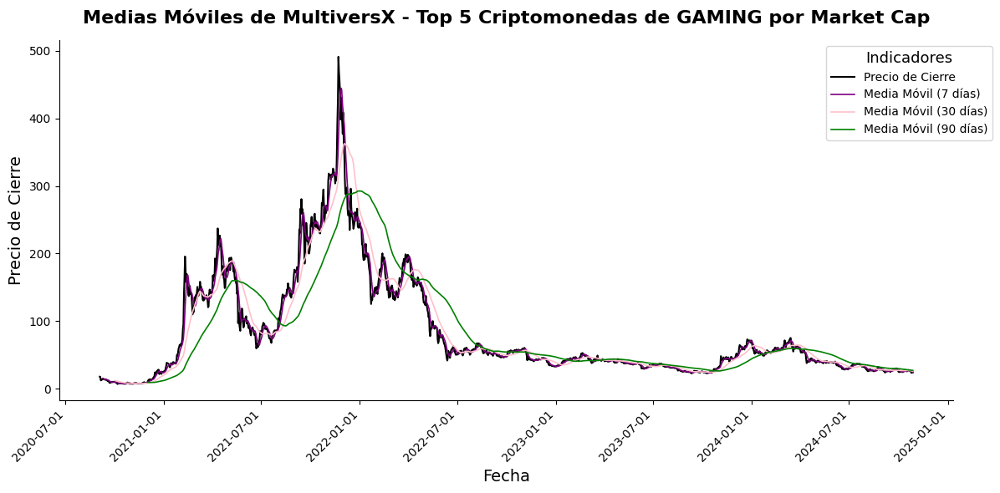

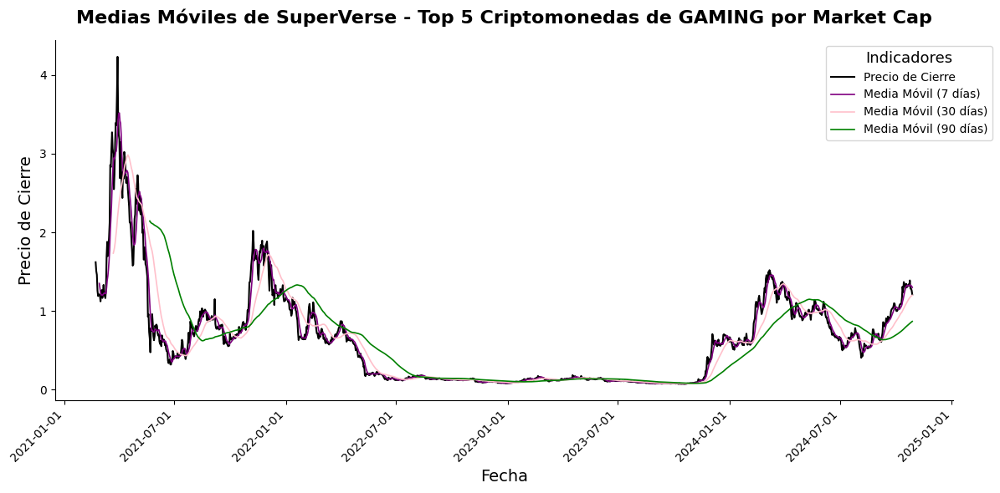

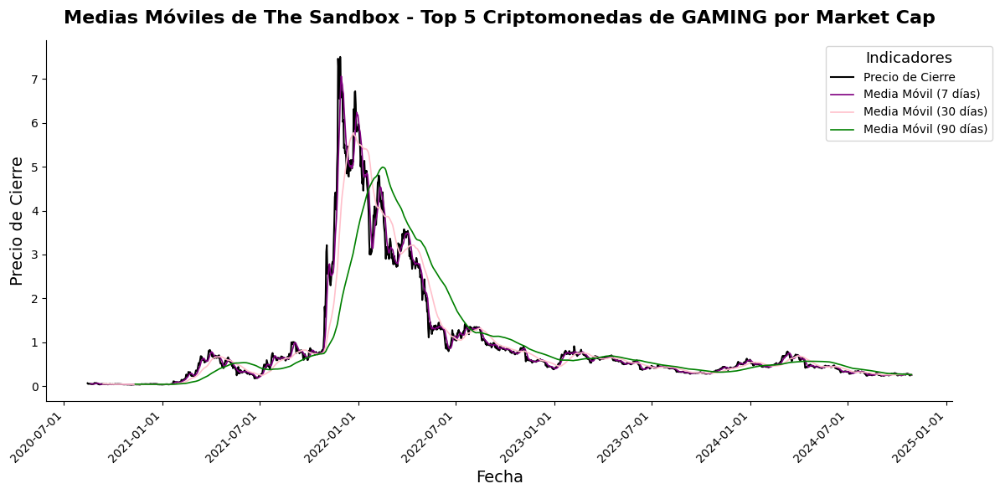

In [36]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
media_movel(df_ai['top'], "Top 5 Criptomonedas de AI por Market Cap")
media_movel(df_meme['top'], "Top 5 Criptomonedas de MEME por Market Cap")
media_movel(df_rwa['top'], "Top 5 Criptomonedas de RWA por Market Cap")
media_movel(df_gaming['top'], "Top 5 Criptomonedas de GAMING por Market Cap")

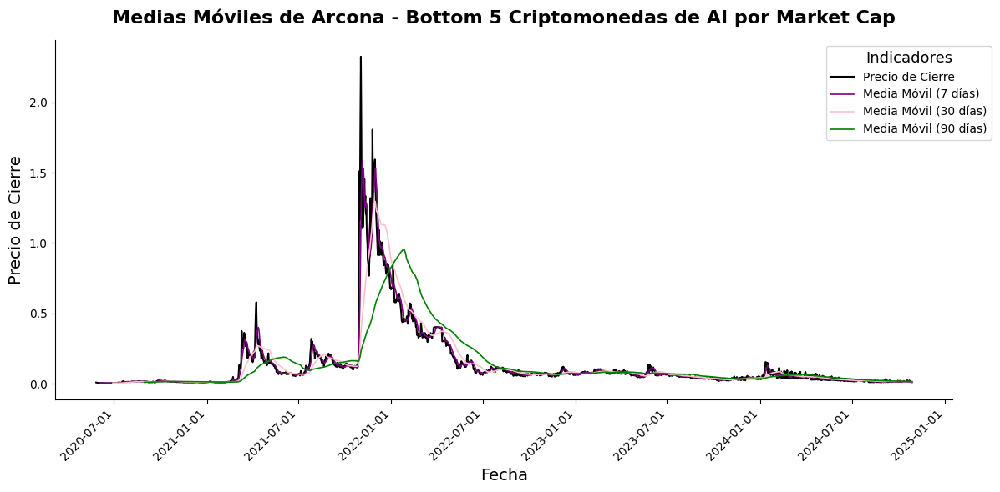

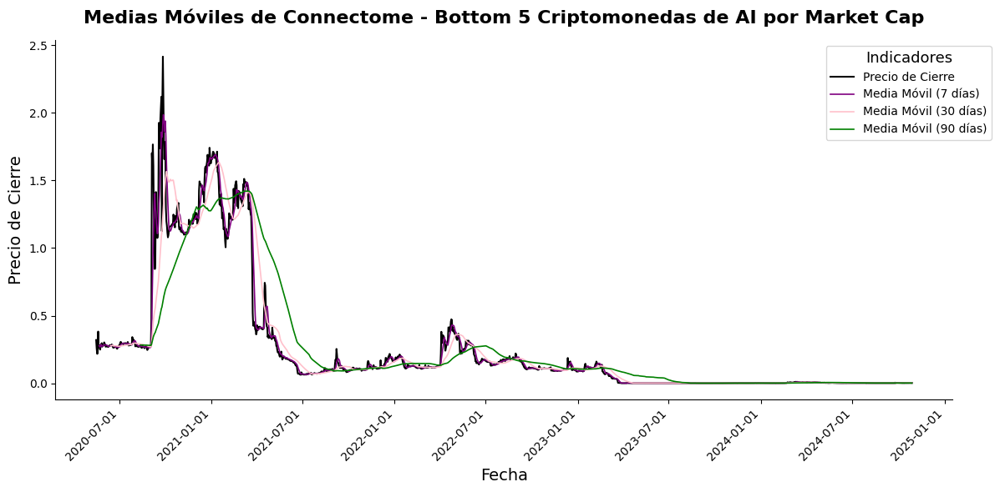

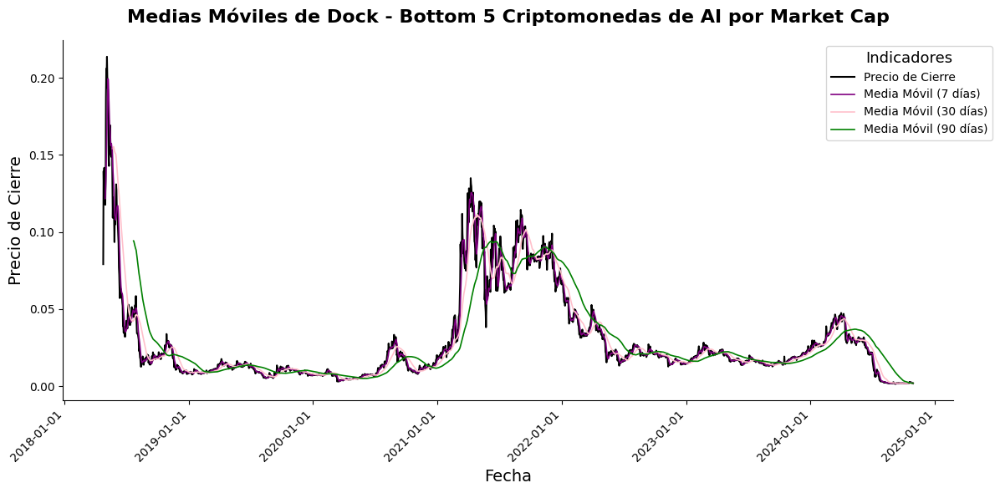

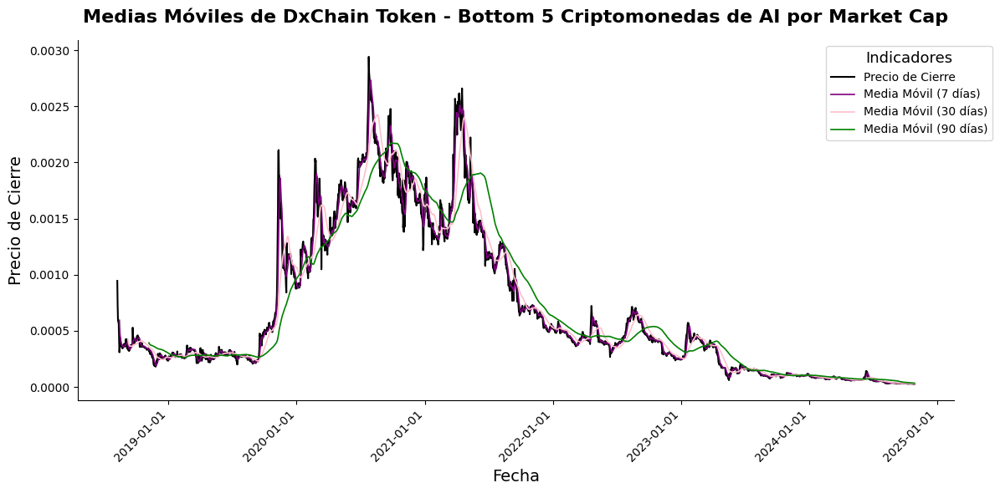

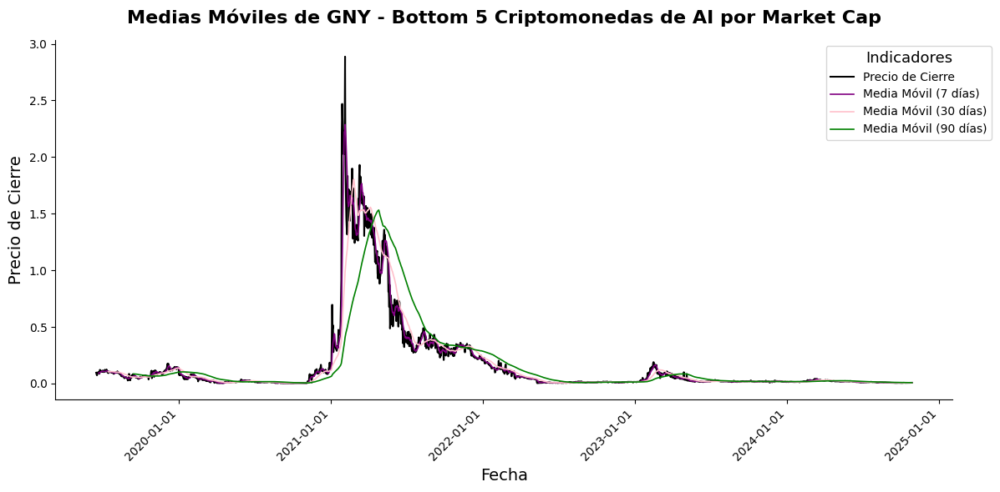

...

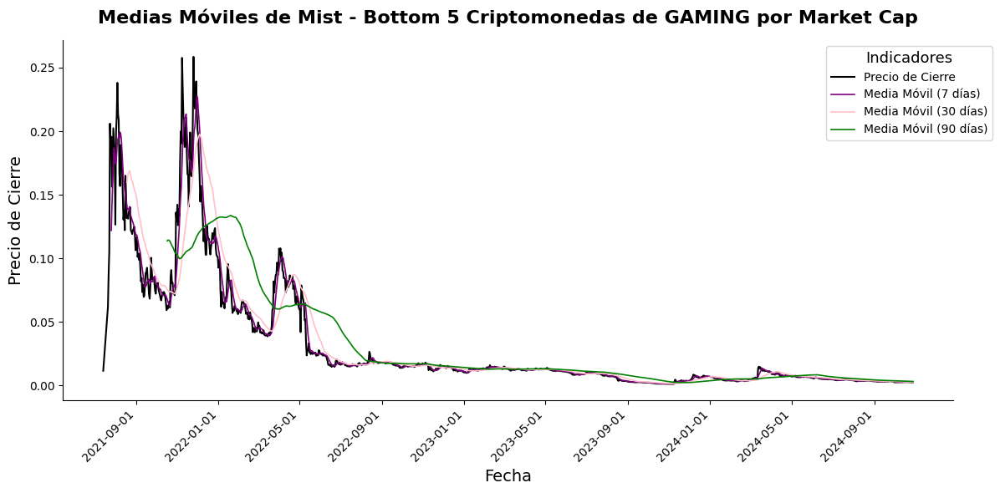

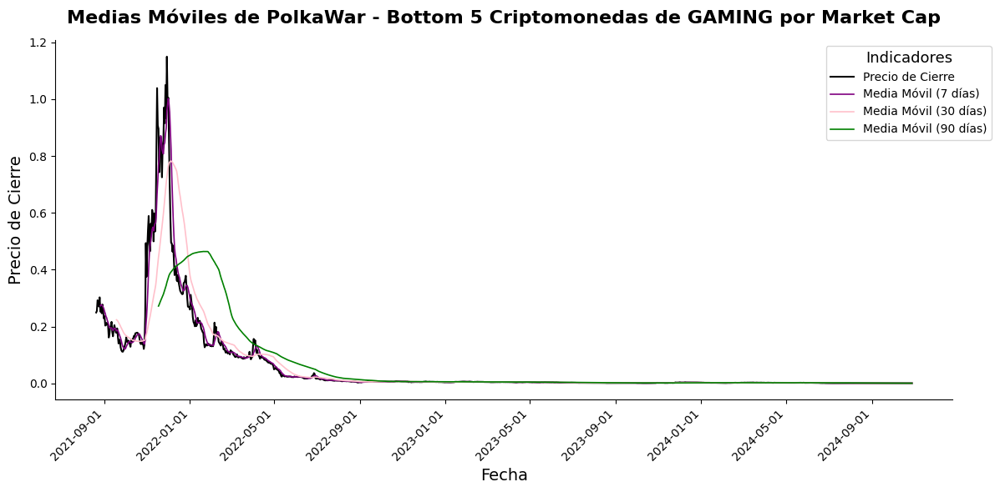

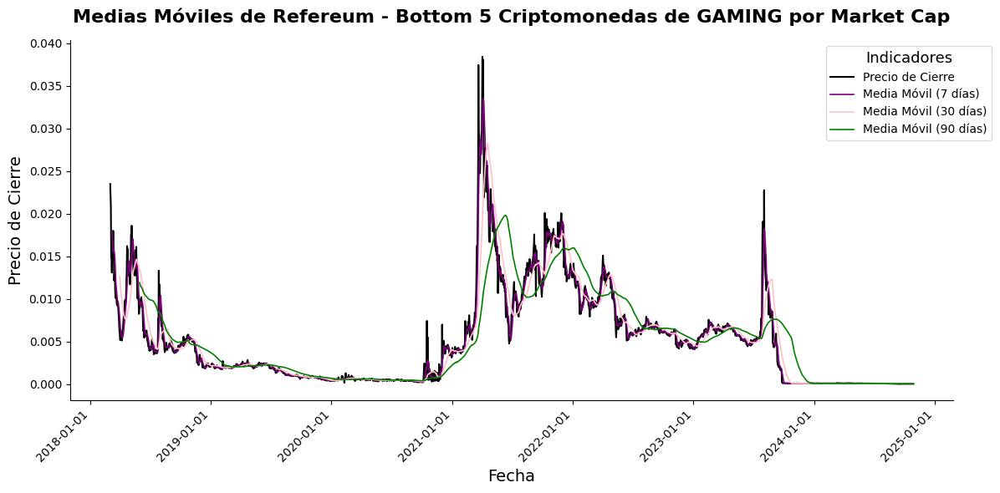

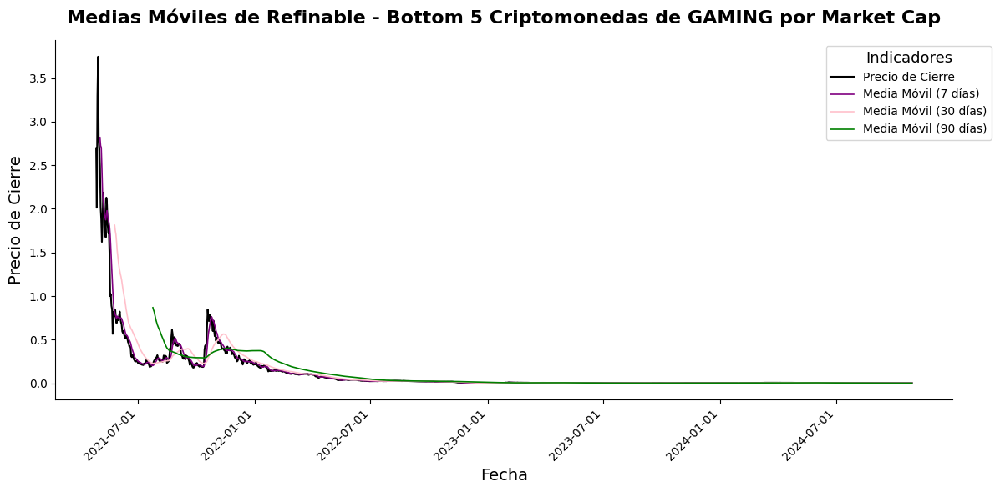

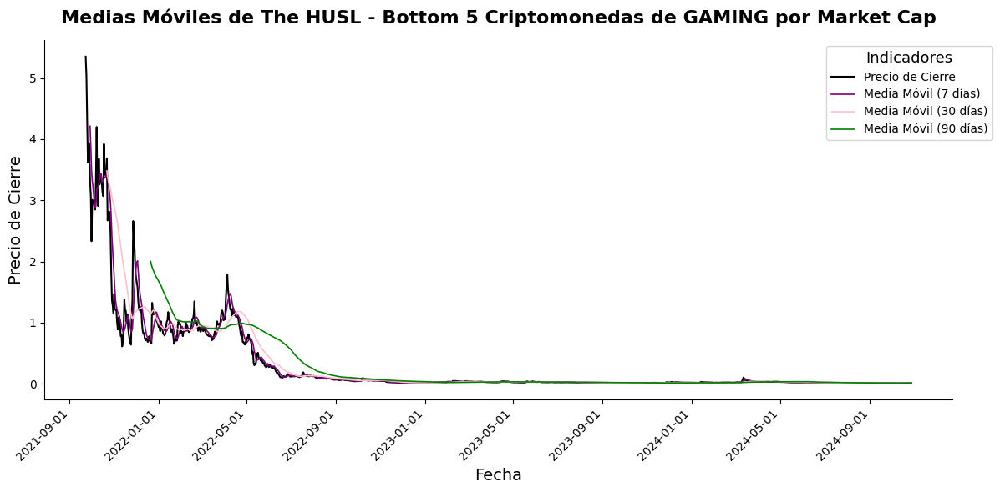

In [37]:
# Precios de Cierre de las 5 criptomonedas con menor Market Cap en cada categoría
media_movel(df_ai['bottom'], "Bottom 5 Criptomonedas de AI por Market Cap")
media_movel(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME por Market Cap")
media_movel(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA por Market Cap")
media_movel(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING por Market Cap")

Volatilidad (Desviación Estándar Móvil de 7 Días) del Precio de Cierre 

In [38]:
def volatilidad(df, title, palette=palette):
    for name, group in df.groupby('name'):
        # Calcular volatilidad (desviación estándar de 7 días)
        volatility = group['close'].rolling(window=7).std()
        
        # Crear la figura
        plt.figure(figsize=(12, 6))
        
        # Graficar la volatilidad
        plt.plot(group['timestamp'], volatility, label='Volatilidad (7 días)', color=palette[1], linewidth=1.5)
        
        # Configuración del título con padding adicional y etiquetas de ejes
        plt.title(f'Volatilidad de {name} - {title}', fontsize=16, fontweight='bold', pad=15)
        plt.xlabel('Timestamp', fontsize=14)  # Usamos 'Timestamp' como etiqueta del eje X
        plt.ylabel('Volatilidad', fontsize=14)
        
        # Ajuste de las etiquetas del eje x sin formatear la fecha
        plt.xticks(rotation=45, ha='right', fontsize=10)
        plt.yticks(fontsize=10)
        
        # Configuración de la leyenda fuera del área del gráfico
        plt.legend(title="Indicador", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1.05, 1))

        # Agregar bordes suaves al gráfico
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        # Ajustar el diseño y mostrar el gráfico
        plt.tight_layout()
        plt.show()

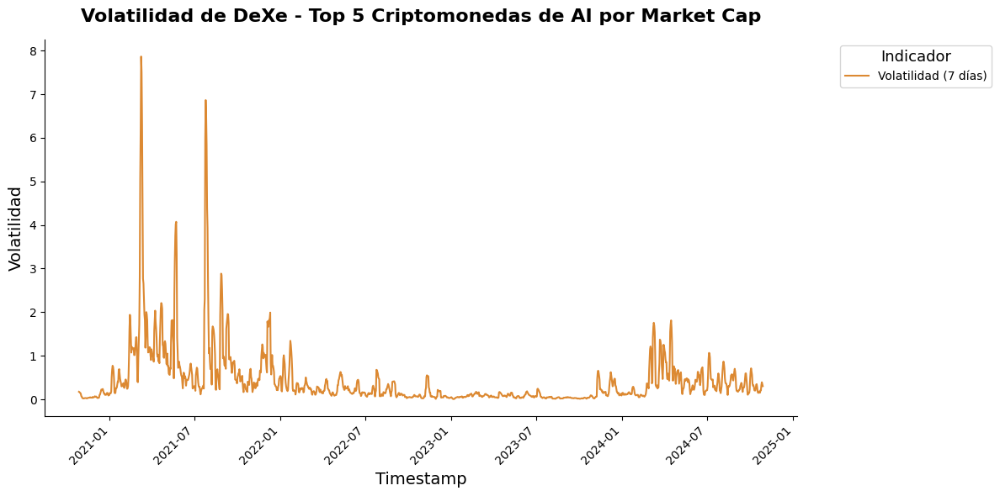

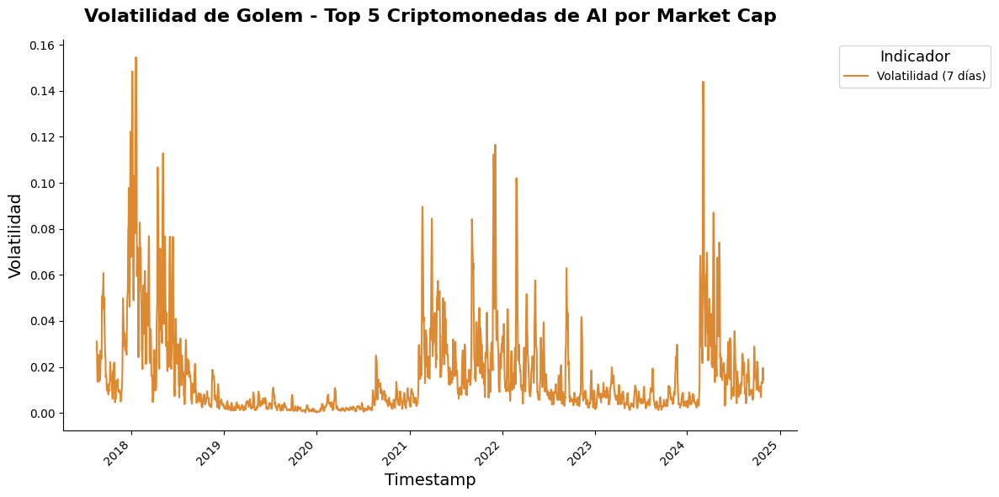

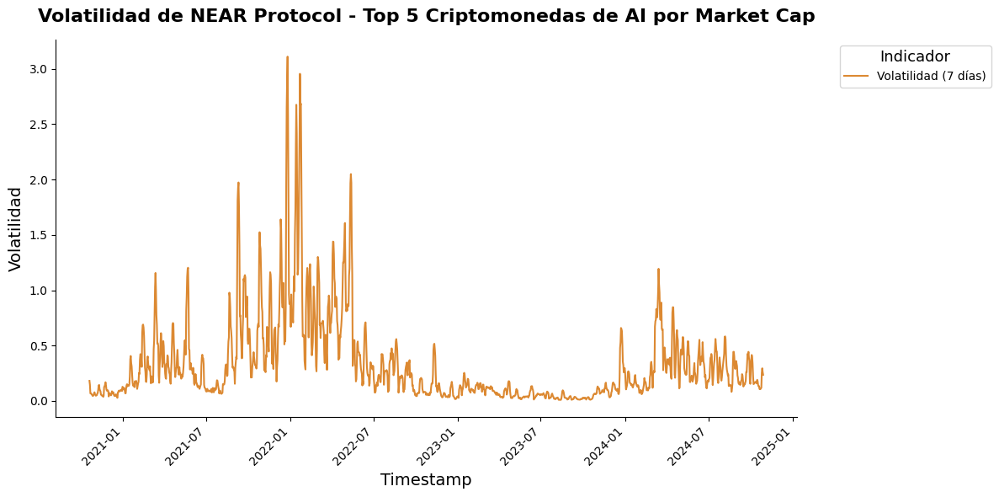

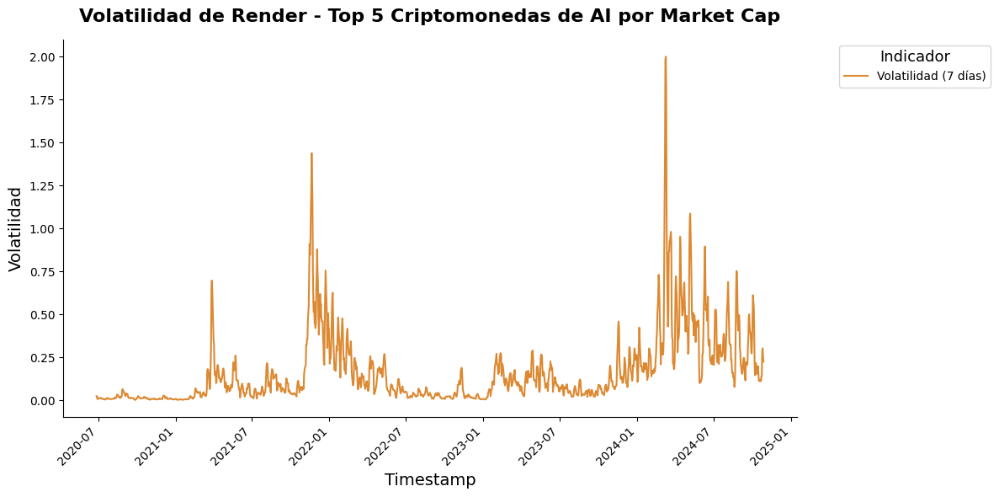

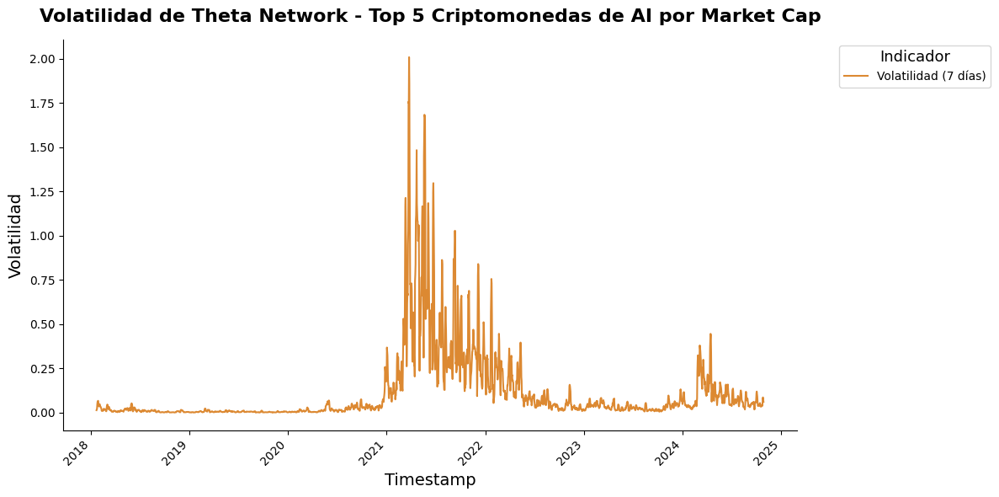

...

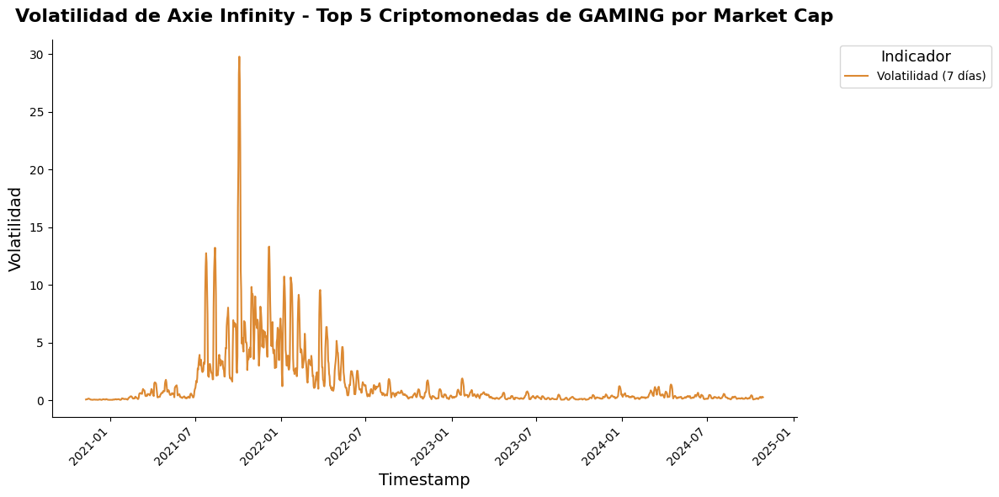

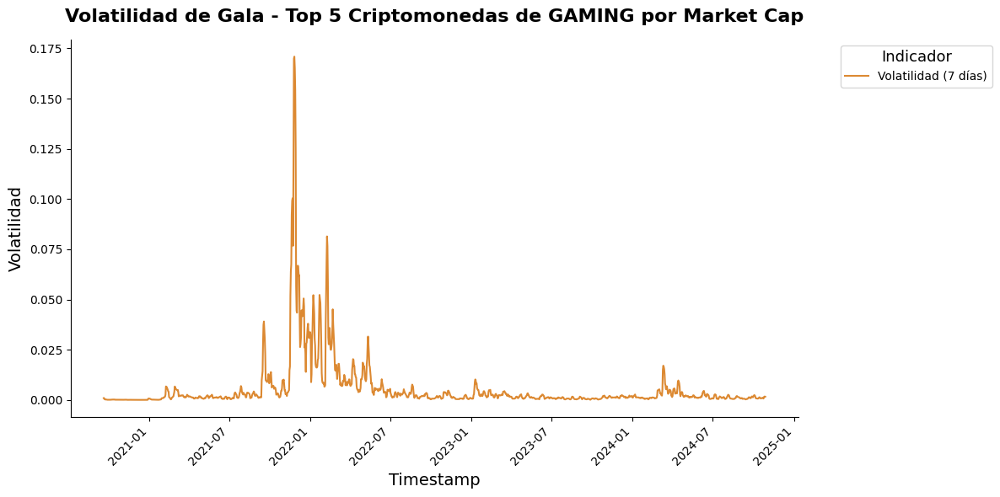

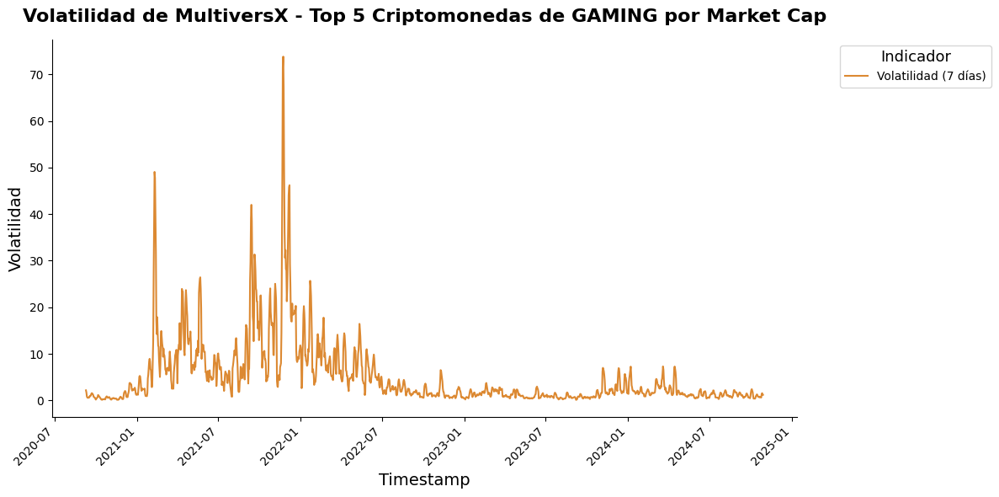

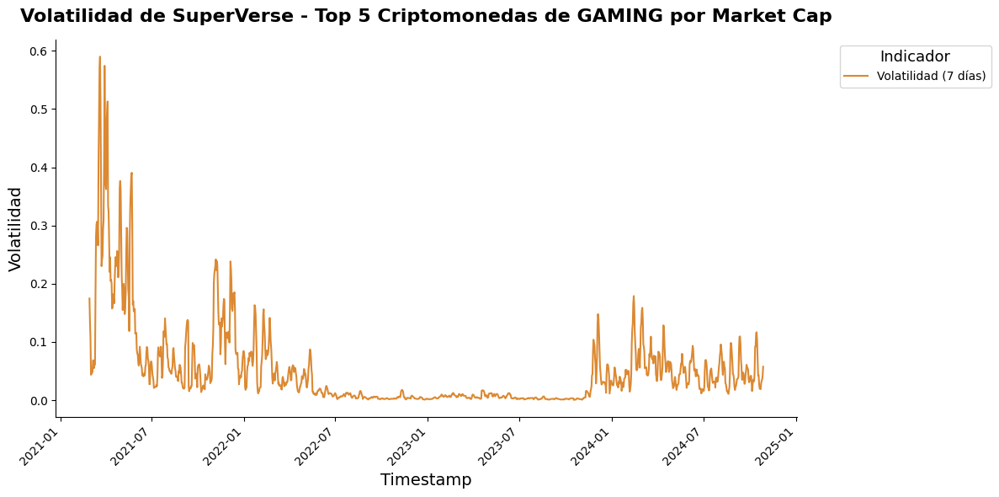

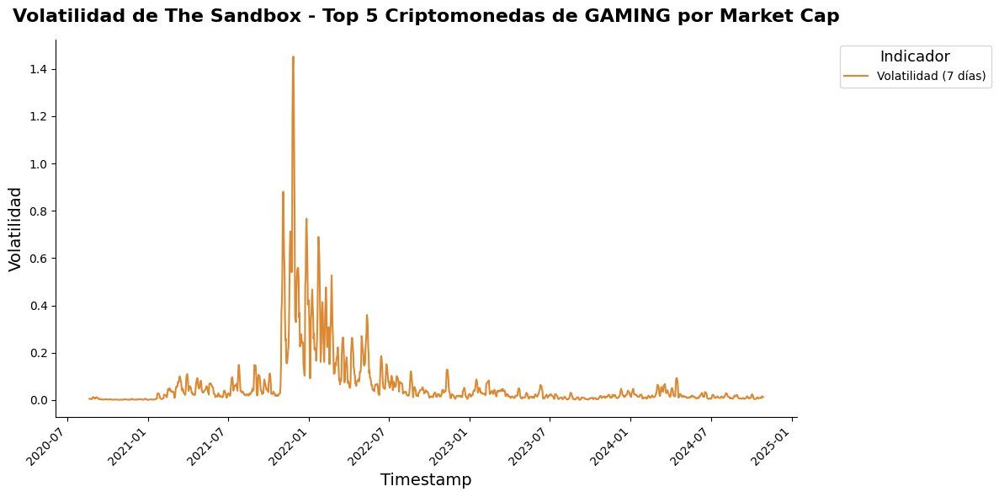

In [39]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
volatilidad(df_ai['top'], "Top 5 Criptomonedas de AI por Market Cap")
volatilidad(df_meme['top'], "Top 5 Criptomonedas de MEME por Market Cap")
volatilidad(df_rwa['top'], "Top 5 Criptomonedas de RWA por Market Cap")
volatilidad(df_gaming['top'], "Top 5 Criptomonedas de GAMING por Market Cap")

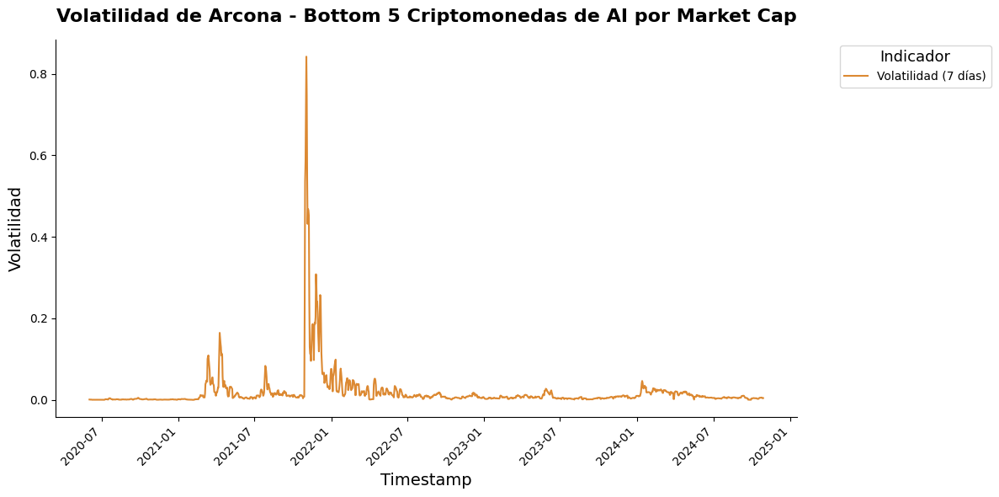

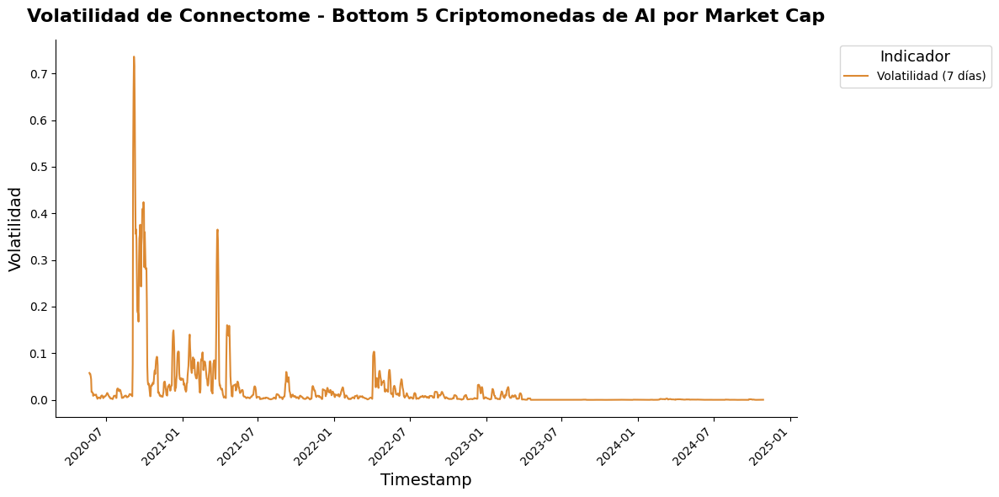

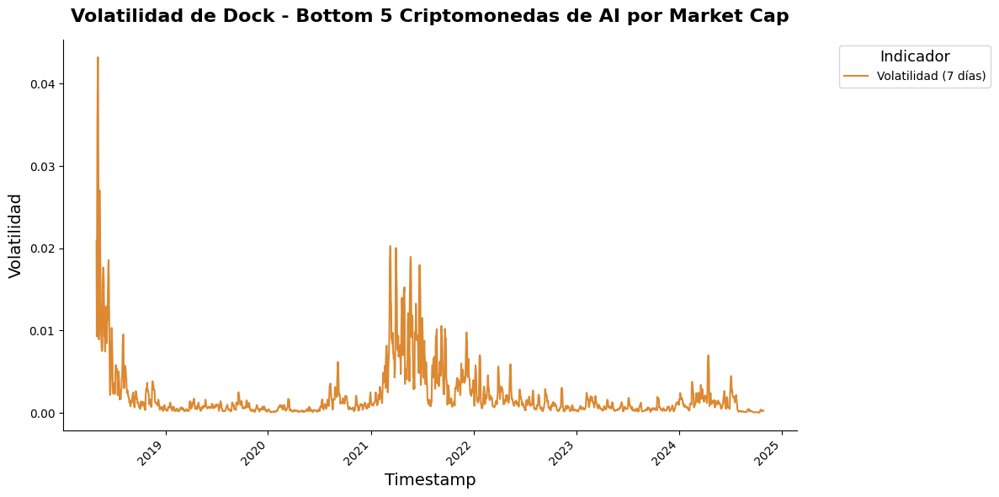

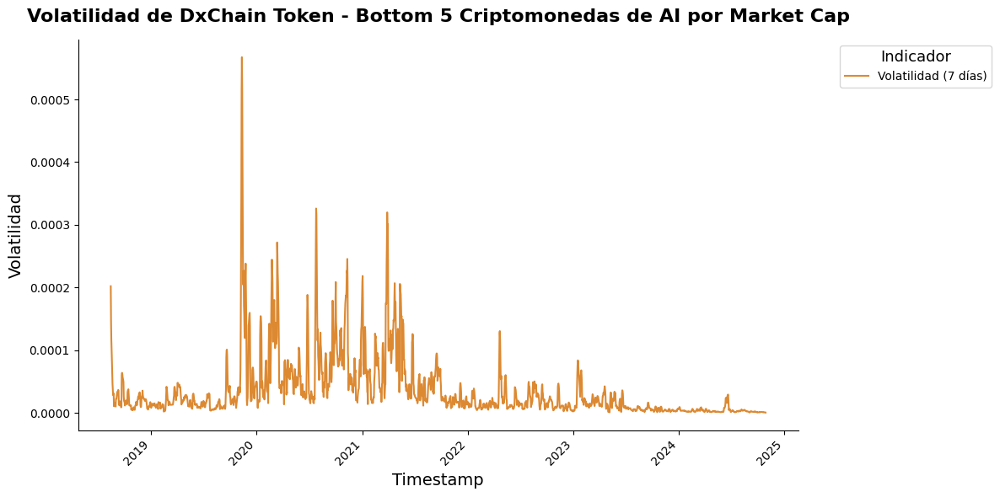

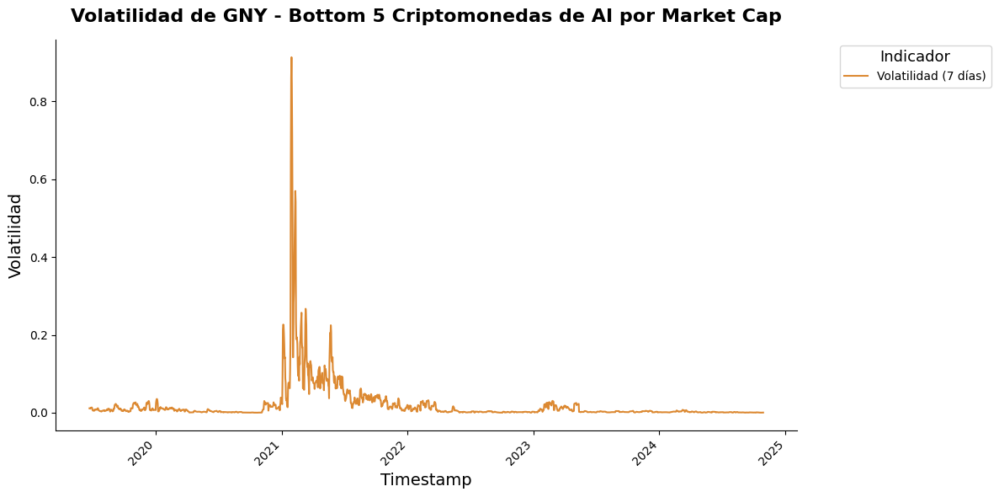

...

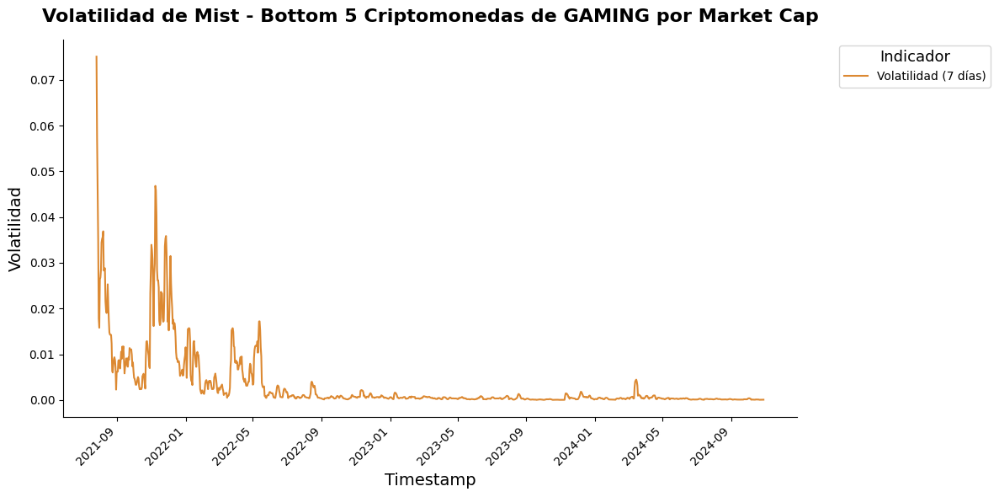

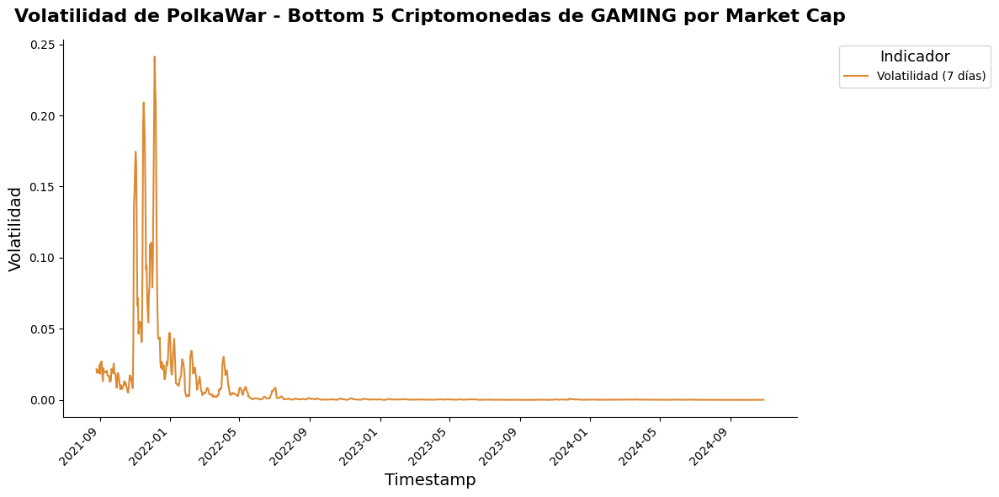

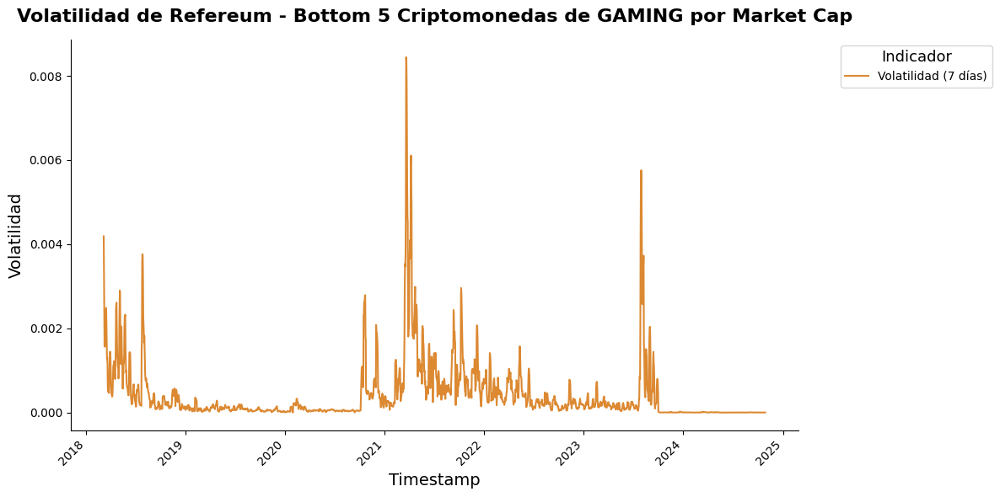

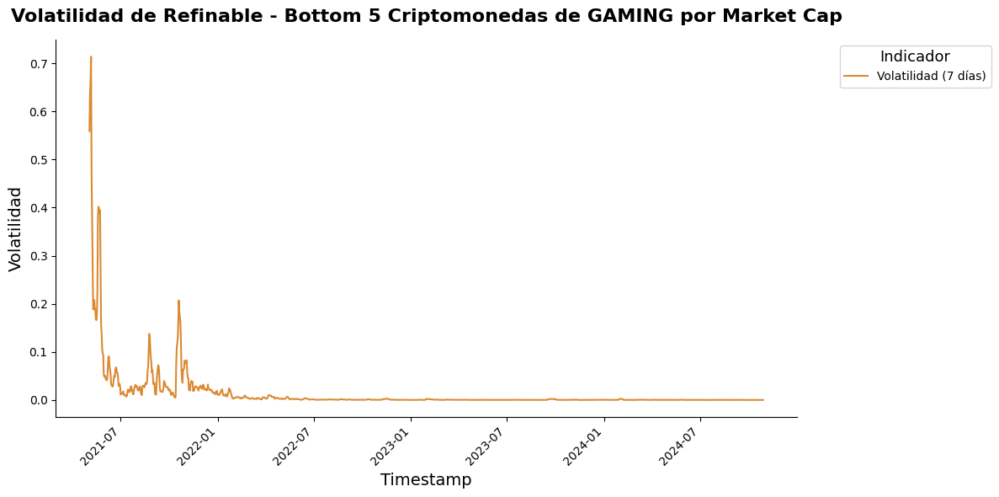

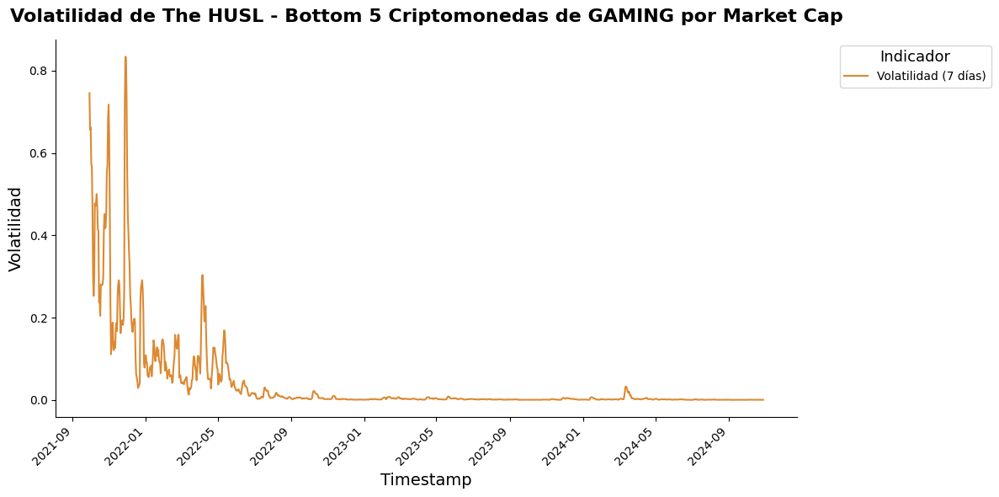

In [40]:
volatilidad(df_ai['bottom'], "Bottom 5 Criptomonedas de AI por Market Cap")
volatilidad(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME por Market Cap")
volatilidad(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA por Market Cap")
volatilidad(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING por Market Cap")

Descomposición STL (descomposición de tendencias estacionales utilizando LOESS)

In [41]:
def add_stl_plot(fig, res, colors, legend):
    axs = fig.get_axes()
    components = ["trend", "seasonal", "resid"]
    
    # Fecha del halving
    halving_date = pd.to_datetime("2024-04-19")
    
    for ax, comp, color in zip(axs[1:], components, colors):
        series = getattr(res, comp)
        
        # Graficar la serie con color específico y estilo
        if comp == "resid":
            ax.plot(series, marker="o", linestyle="none", markersize=3, color=color, alpha=0.7, label="Residuales")
        else:
            ax.plot(series, color=color, linewidth=1.5, label=comp.capitalize())
            
            # Añadir leyenda solo en la tendencia
            if comp == "trend":
                ax.legend(legend + ["Fecha del Halving (19 de Abril de 2024)"], frameon=False, loc='upper left', bbox_to_anchor=(1, 1))
                
        ax.axvline(halving_date, color="red", linestyle="--", linewidth=1, label="Fecha del Halving (19 de Abril de 2024)")

In [42]:
def stl_decomposition(df, palette=palette):
    # Convertir 'timestamp' a formato de fecha y establecerlo como índice
    df['date'] = pd.to_datetime(df['timestamp'], unit='s')
    df.set_index('date', inplace=True)

    for name, group in df.groupby('name'):
        # Realizar la descomposición STL con y sin robustez
        stl_robust = STL(group['close'], period=30, robust=True).fit()
        stl_non_robust = STL(group['close'], period=30, robust=False).fit()
        
        # Crear la figura
        fig = stl_robust.plot()
        fig.set_size_inches(14, 10)
        
        # Asignar colores para las versiones robusta y no robusta
        robust_colors = [palette[0], palette[1], palette[2]]
        non_robust_colors = [palette[3], palette[4], palette[5]]
        
        # Añadir la descomposición sin robustez con colores variables
        add_stl_plot(fig, stl_non_robust, non_robust_colors, ["Robust", "Non-robust"])
        add_stl_plot(fig, stl_robust, robust_colors, ["Robust", "Non-robust"])
        
        # Ajustes estéticos de los ejes y títulos
        for ax in fig.get_axes():
            ax.set_title(ax.get_title(), fontsize=10, pad=10)  # Títulos de los componentes con padding
            ax.set_xlabel("Fecha", fontsize=10)  # Etiqueta de eje X como "Fecha"
            ax.set_ylabel(ax.get_ylabel(), fontsize=10)
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))  # Formato de fecha en eje X
            plt.setp(ax.get_xticklabels(), rotation=45, ha="right")  # Rotar las etiquetas de fecha para mejor legibilidad
        
        # Configuración del título principal con padding adicional
        fig.suptitle(f'Descomposición de {name}', fontsize=14, fontweight='bold', y=1.02)
        
        # Ajustar diseño para evitar superposición
        plt.tight_layout()
        plt.subplots_adjust(top=0.9)  # Ajuste del espacio superior para el título
        plt.show()


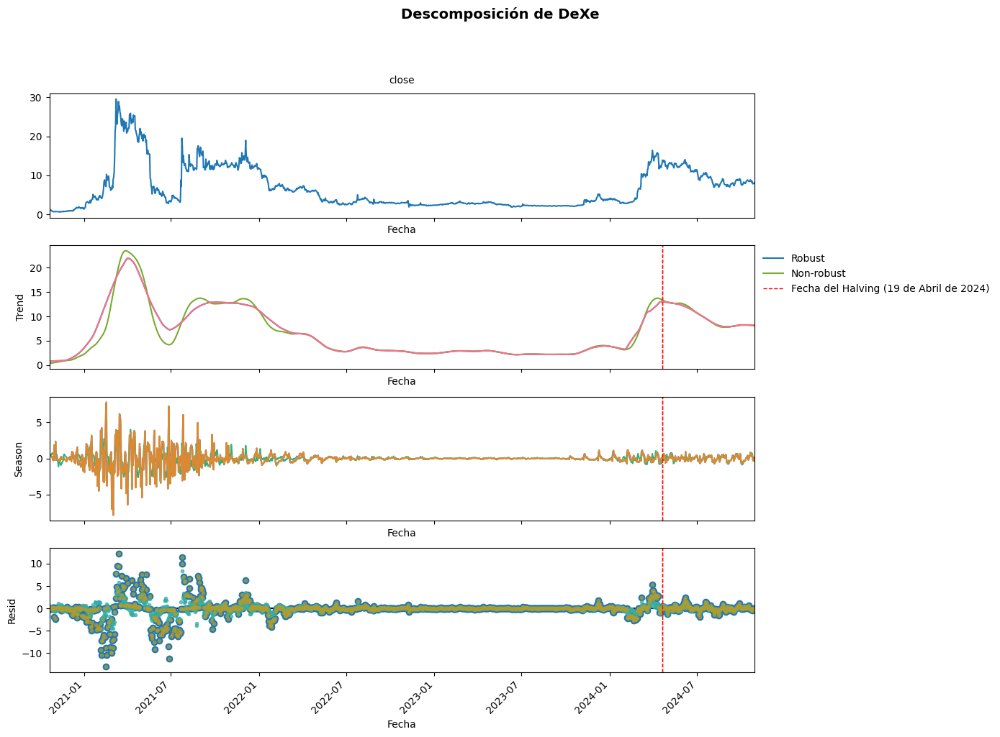

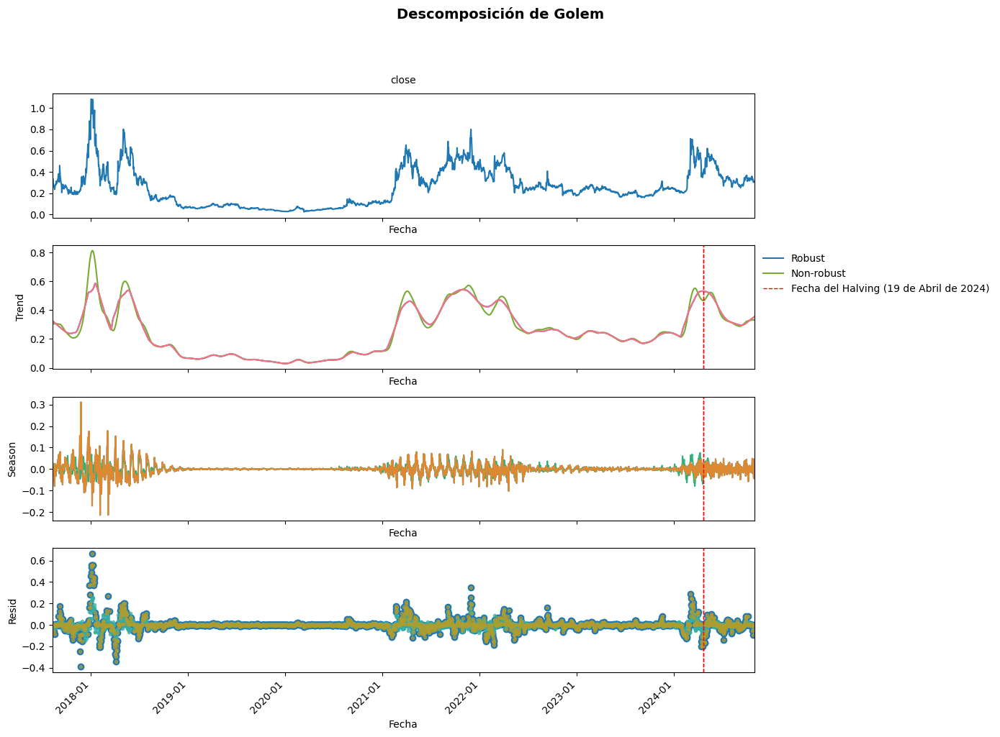

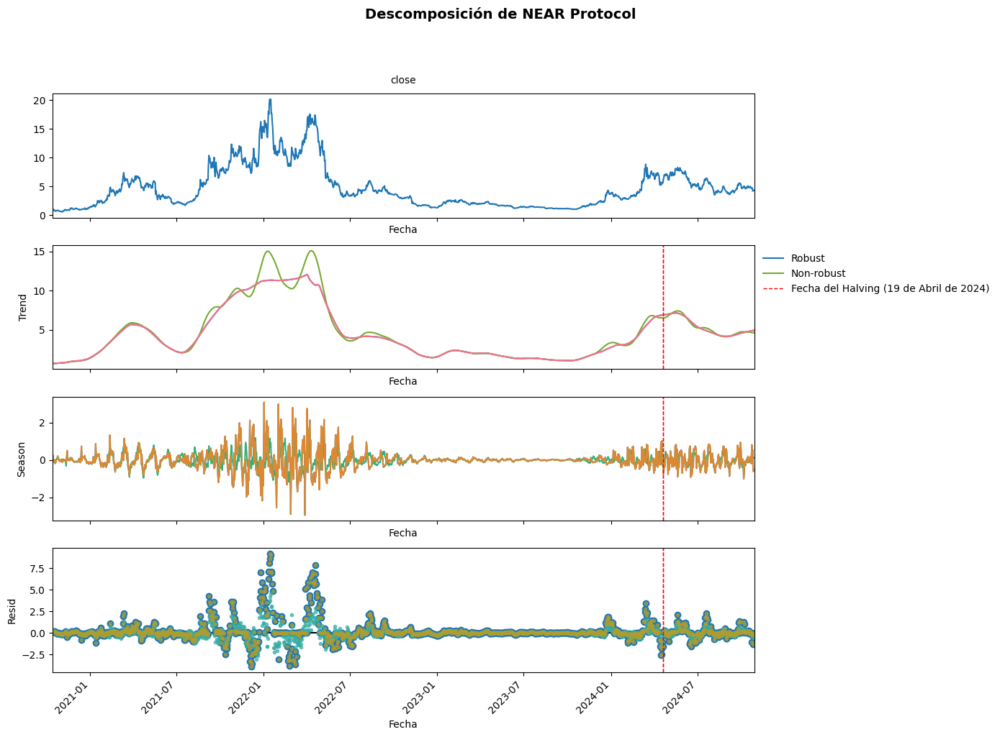

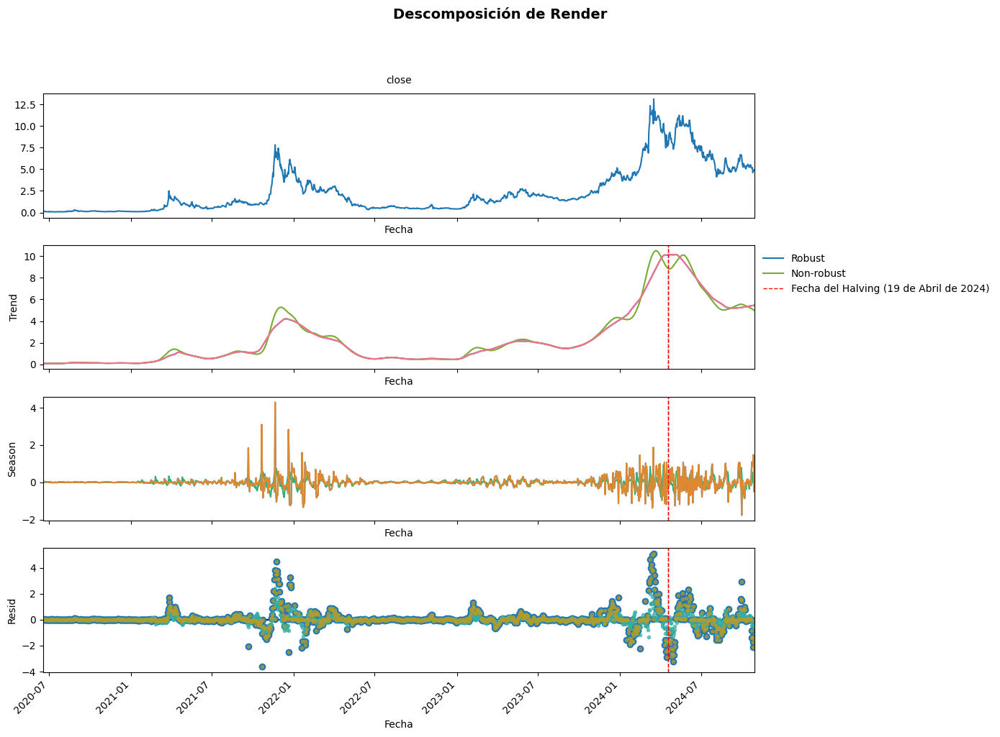

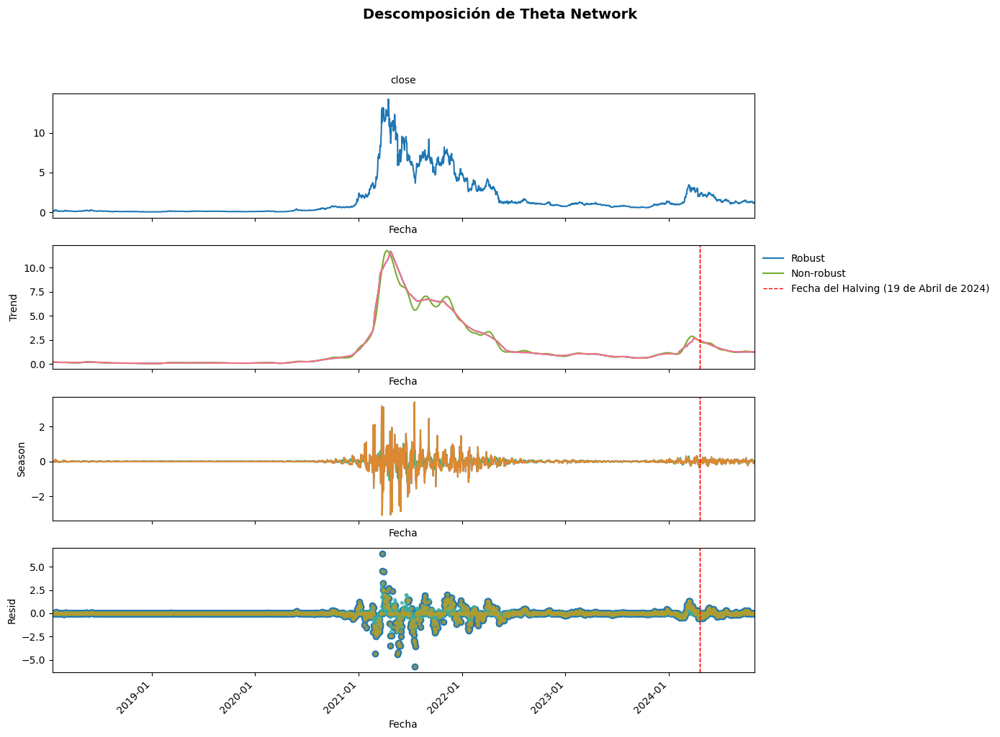

...

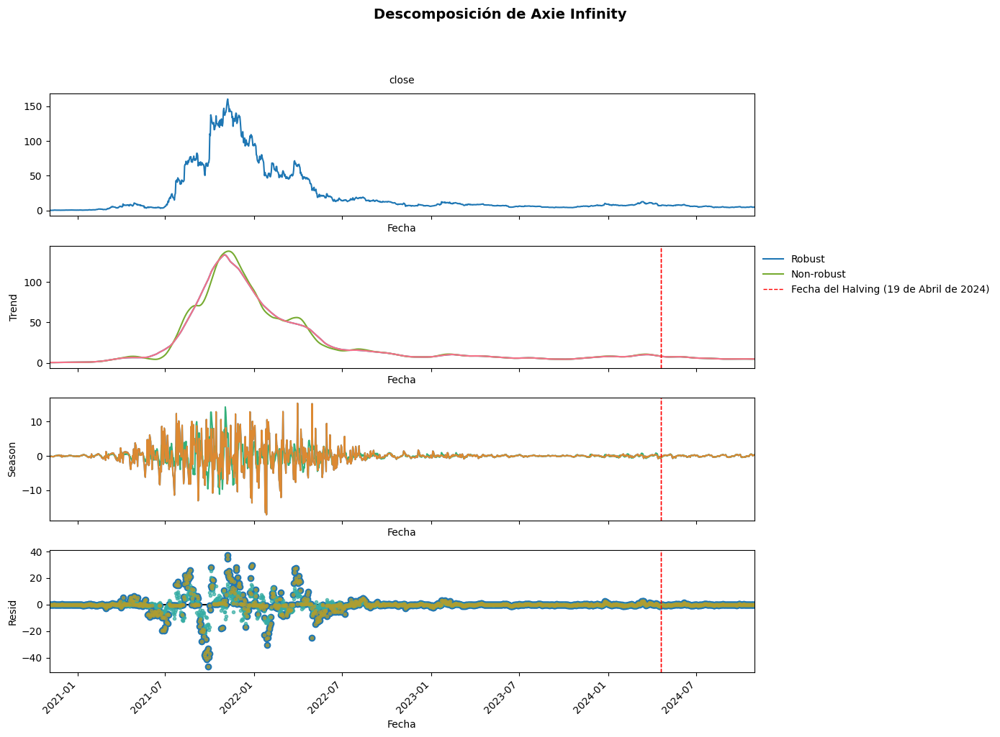

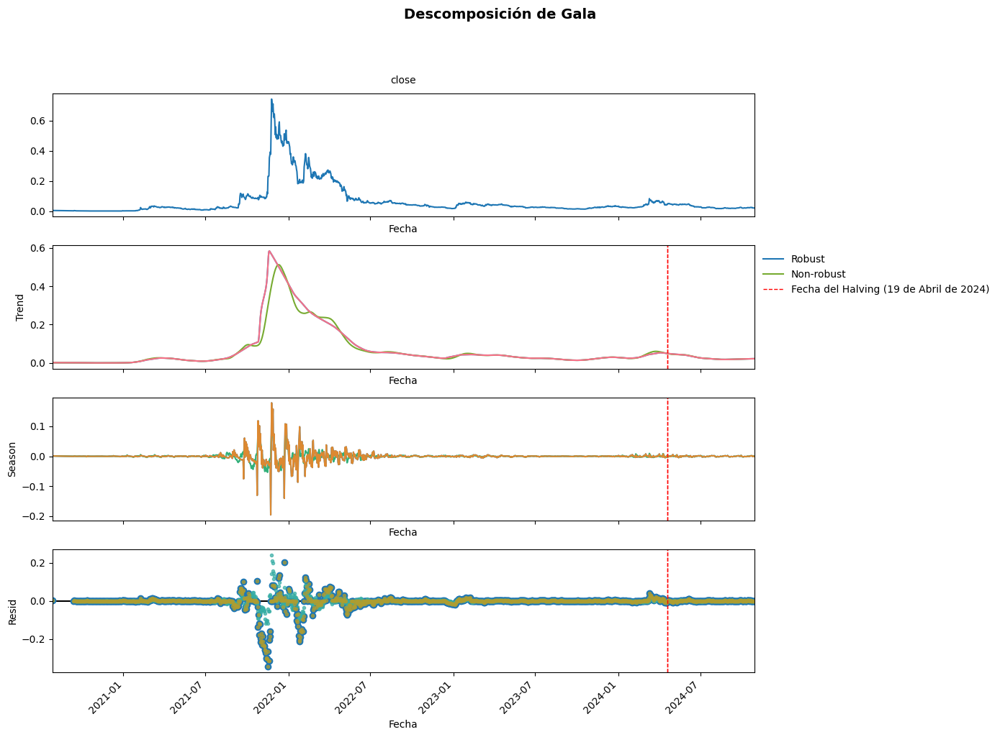

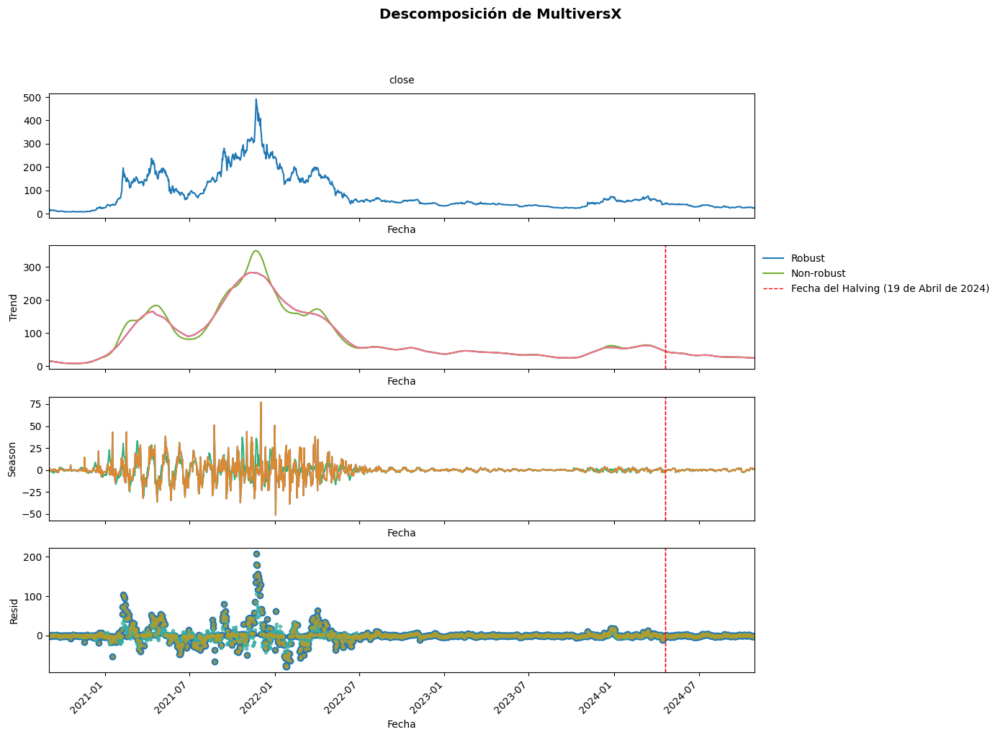

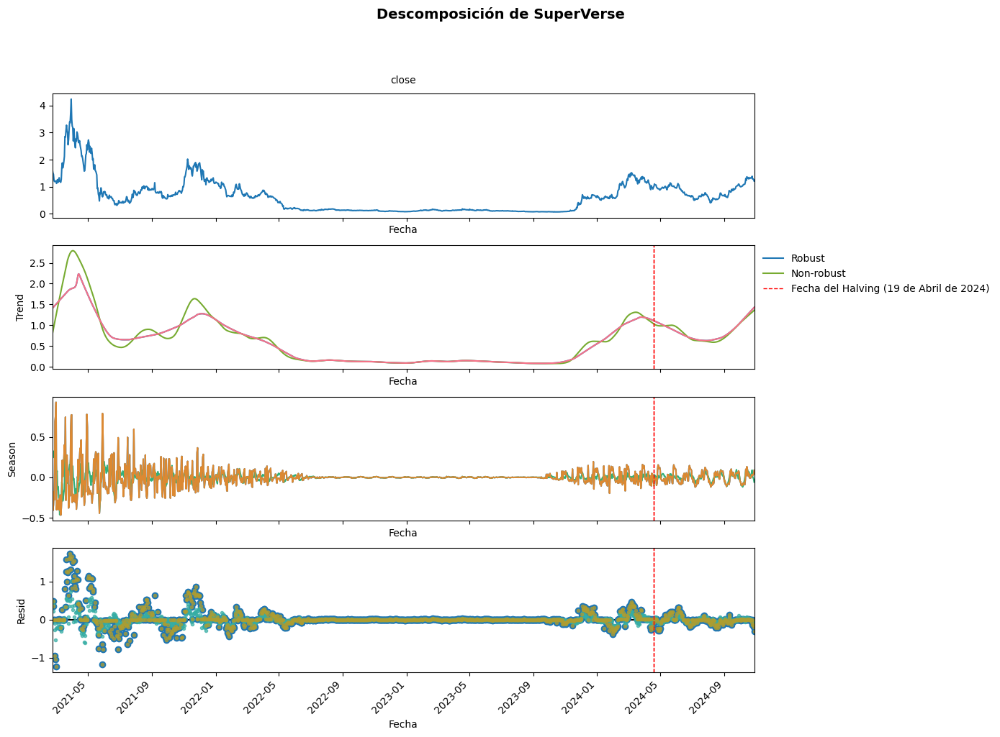

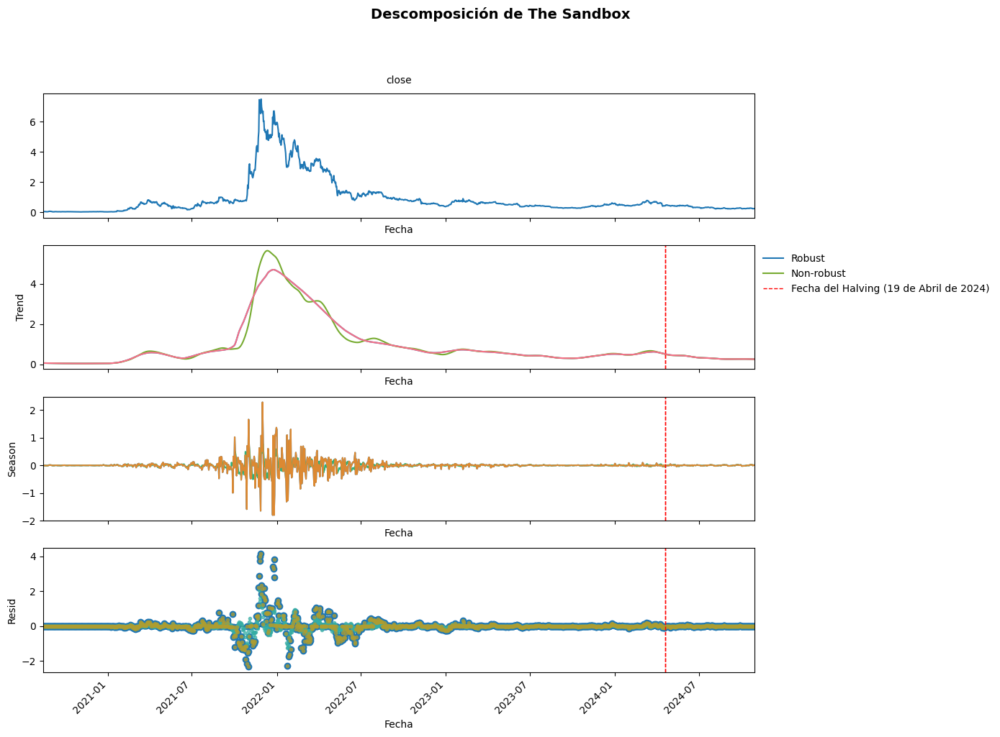

In [43]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
stl_decomposition(df_ai['top'])
stl_decomposition(df_meme['top'])
stl_decomposition(df_rwa['top'])
stl_decomposition(df_gaming['top'])

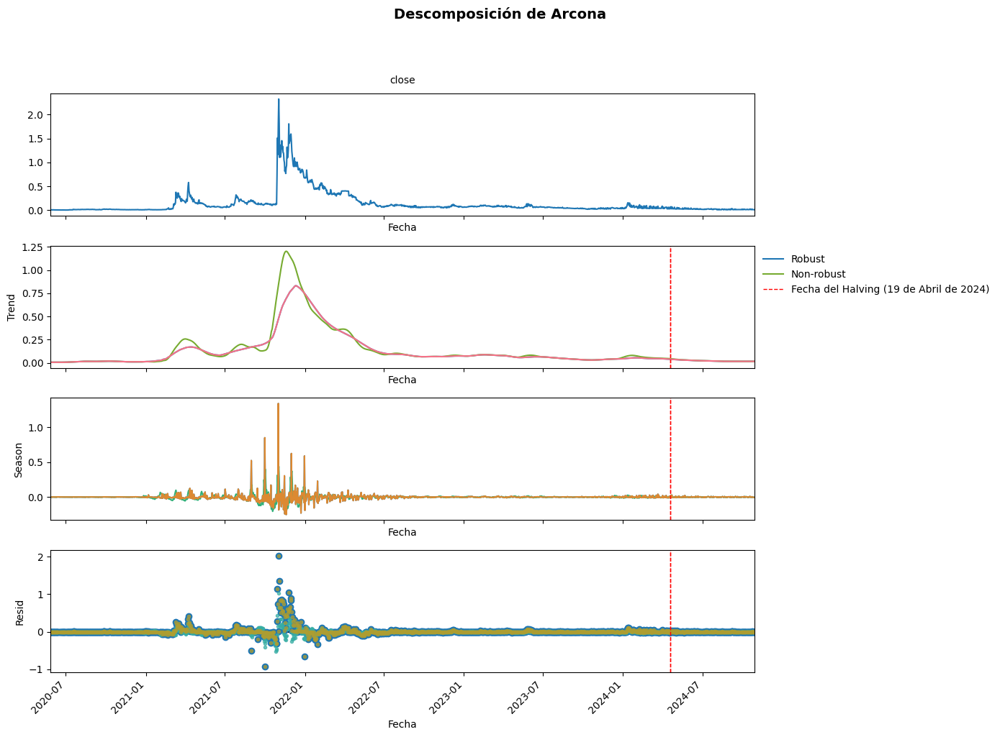

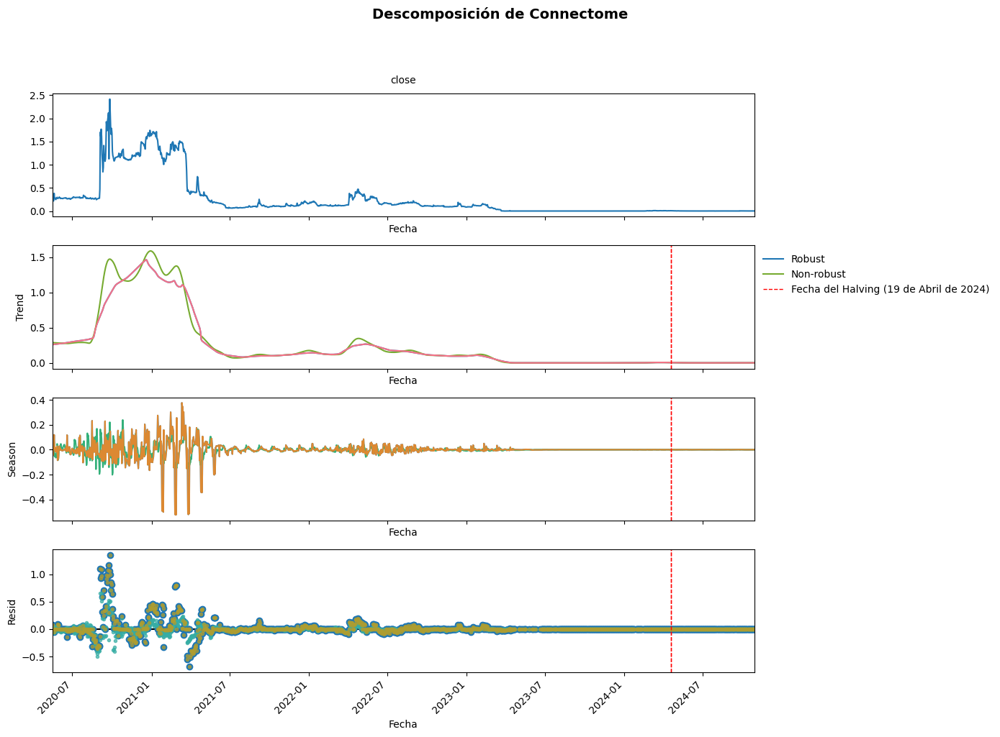

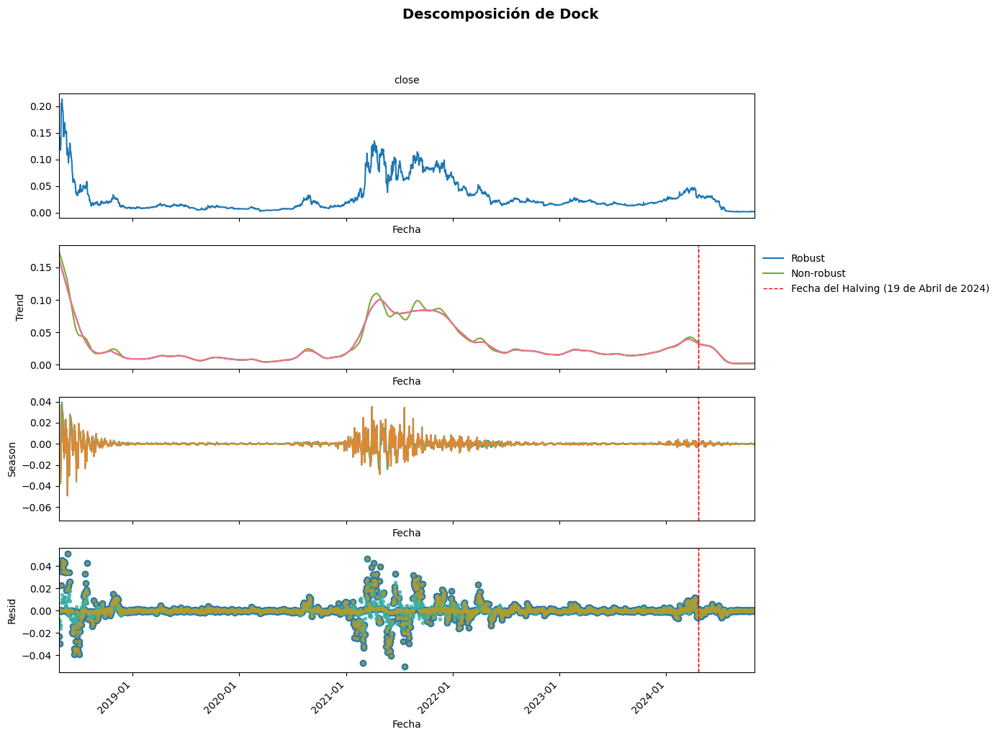

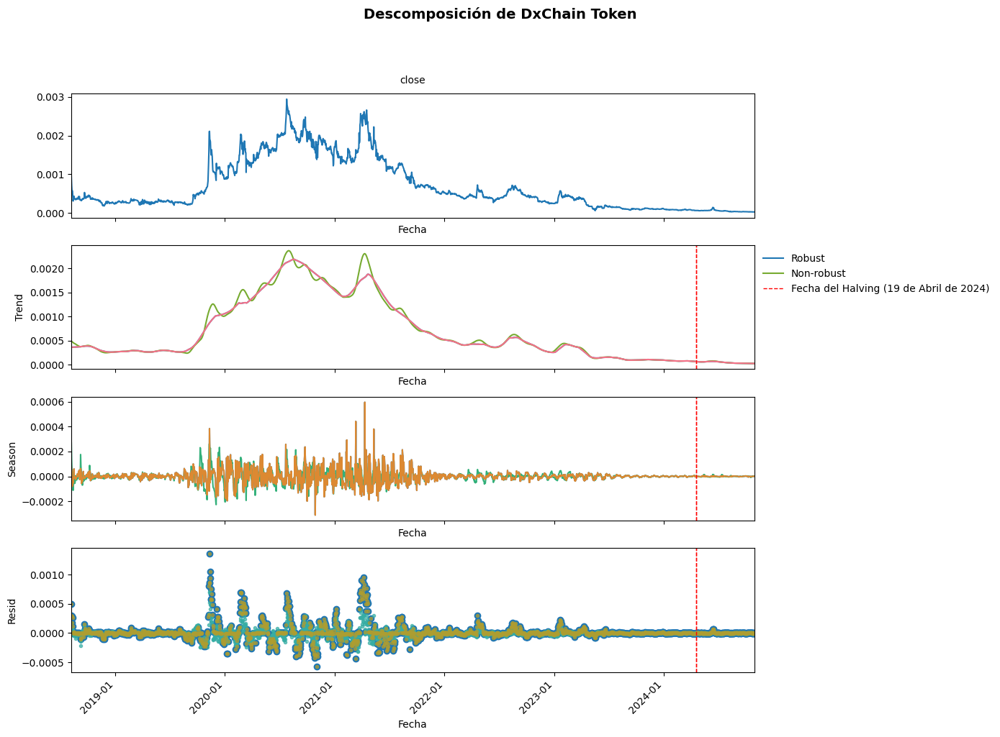

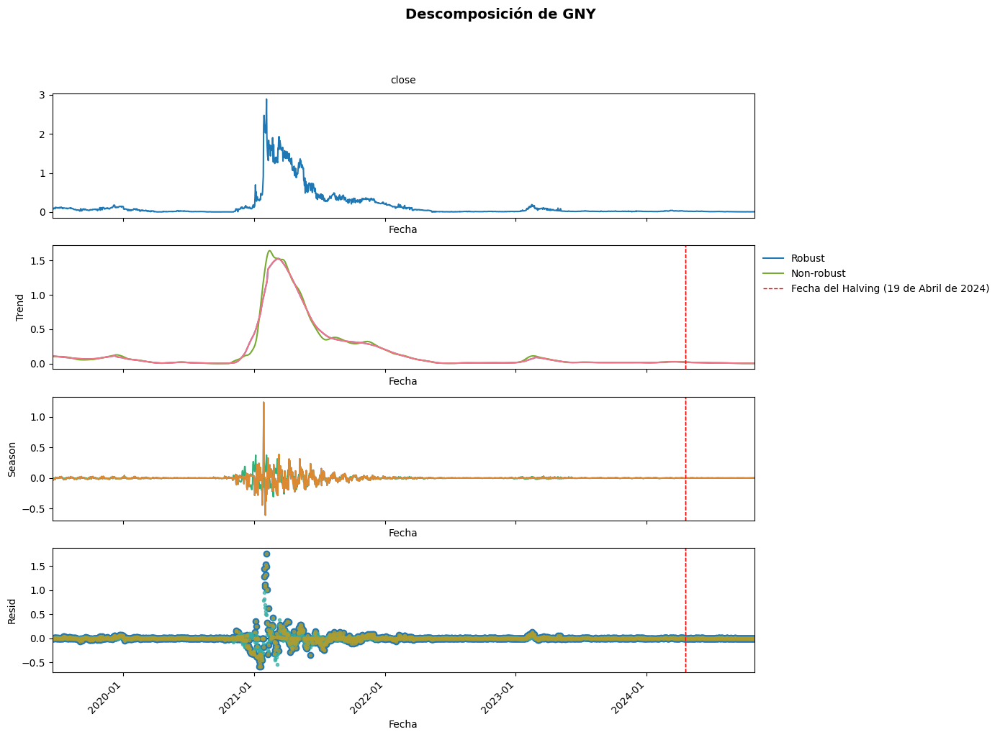

...

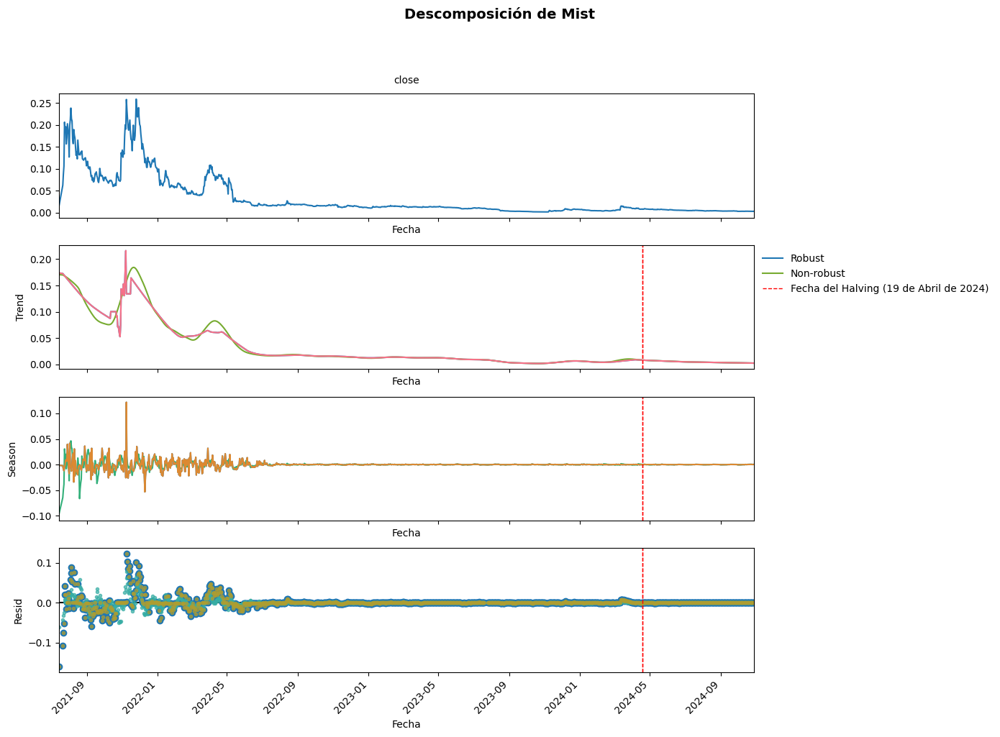

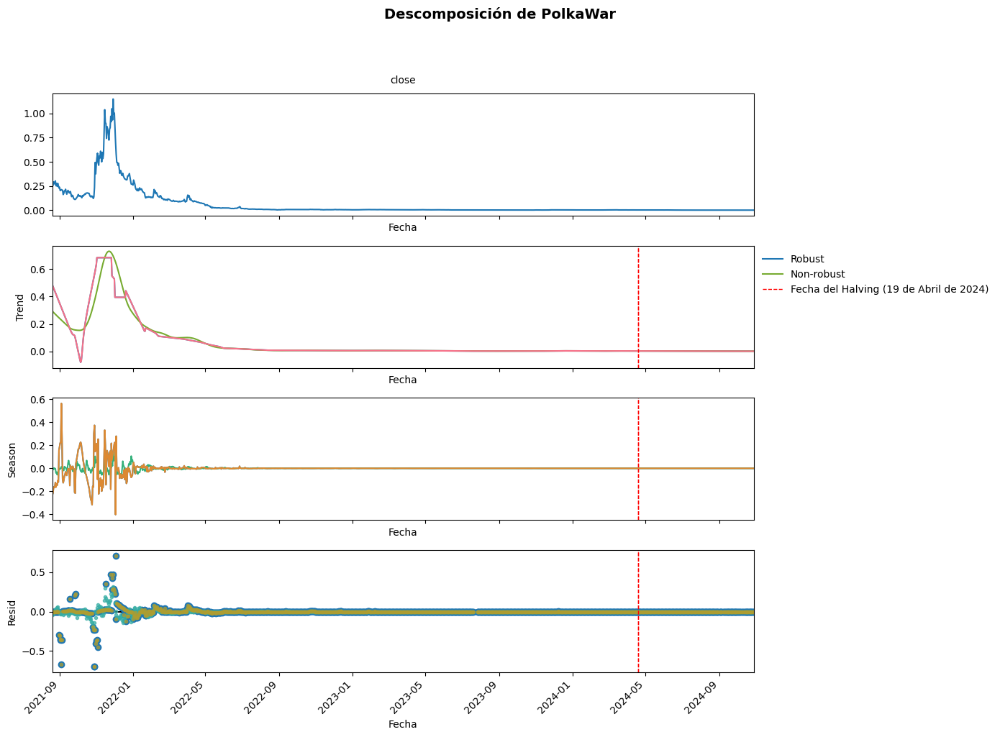

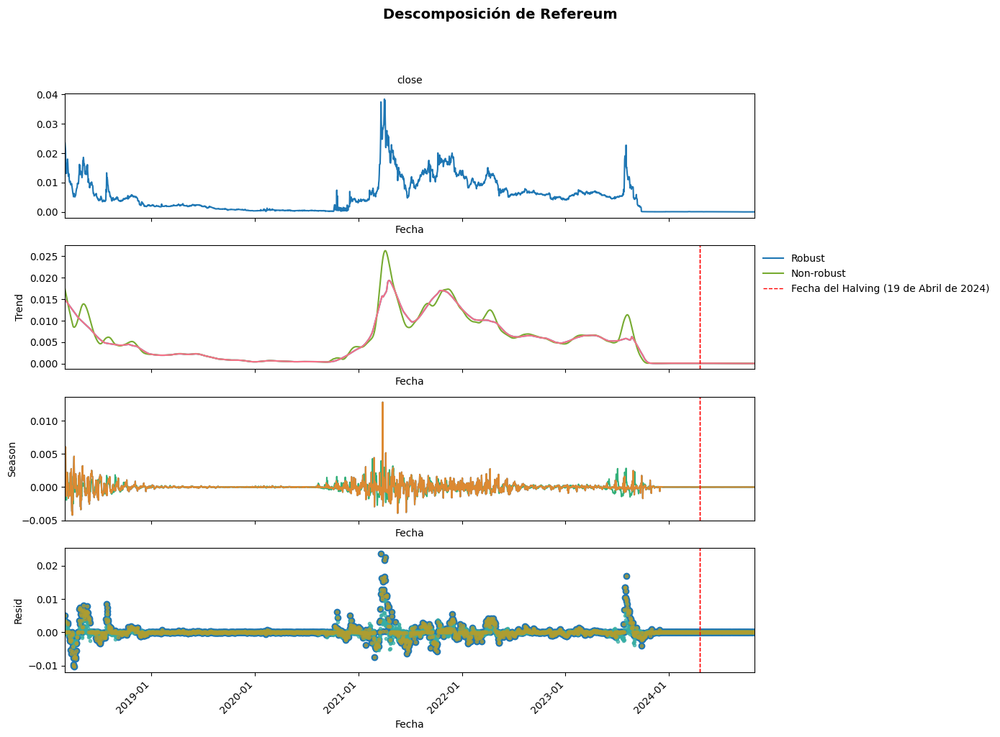

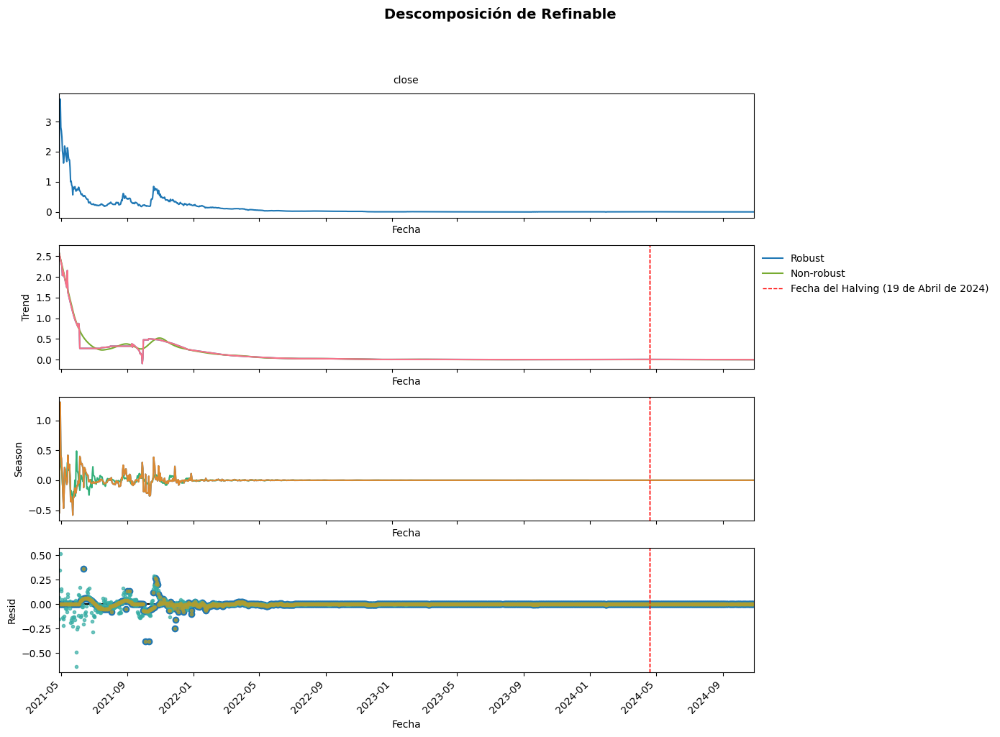

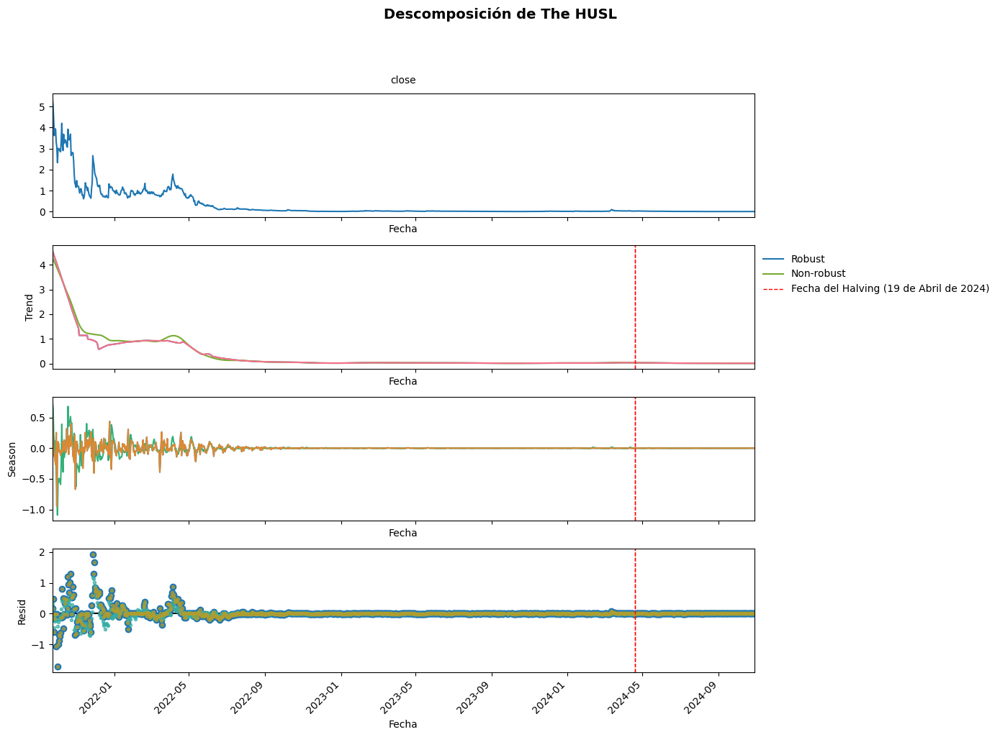

In [44]:
stl_decomposition(df_ai['bottom'])
stl_decomposition(df_meme['bottom'])
stl_decomposition(df_rwa['bottom'])
stl_decomposition(df_gaming['bottom'])

In [ ]:
def find_coins_with_no_prior_records(df, timestamp_column='timestamp', previous_halving_cutoff='2020-05-11'):
    df['date'] = pd.to_datetime(df[timestamp_column], unit='s')
    df.set_index('date', inplace=True)
    previous_halving_cutoff = pd.to_datetime(previous_halving_cutoff)
    qualifying_groups = []
    for name, group in df.groupby('name'):
        min_date = group.index.min()
        if min_date > previous_halving_cutoff:
            qualifying_groups.append(group)
            print(name)
    result_df = pd.concat(qualifying_groups) if qualifying_groups else pd.DataFrame()
    return result_df

In [46]:
df_ai_h_top = find_coins_with_no_prior_records(df_ai['top'])
df_meme_h_top = find_coins_with_no_prior_records(df_meme['top'])
df_rwa_h_top = find_coins_with_no_prior_records(df_rwa['top'])
df_gaming_h_top = find_coins_with_no_prior_records(df_gaming['top'])
df_gaming_h_bottom = find_coins_with_no_prior_records(df_gaming['bottom'])
df_meme_h_bottom = find_coins_with_no_prior_records(df_meme['bottom'])
df_rwa_h_bottom = find_coins_with_no_prior_records(df_rwa['bottom'])
df_ai_h_bottom = find_coins_with_no_prior_records(df_ai['bottom'])

DeXe
NEAR Protocol
Render
Bone ShibaSwap
Dogelon Mars
Samoyedcoin
Shiba Inu
Avalanche
Axie Infinity
Gala
MultiversX
SuperVerse
The Sandbox
Mist
PolkaWar
Refinable
The HUSL
Akita Inu
Cheems
CumRocket
Dingocoin
Loser Coin
ELYSIA
Realio Network
Stobox Token
TrueFi
Arcona
Connectome


In [47]:
#Todas las monedas, en total hay como 86 monedas
df_ai_halving = find_coins_with_no_prior_records(filtered_data_ai)
df_meme_halving = find_coins_with_no_prior_records(filtered_data_meme)
df_rwa_halving = find_coins_with_no_prior_records(filtered_data_rwa)
df_gaming_halving = find_coins_with_no_prior_records(filtered_data_gaming)

Aleph.im
Arcona
Connectome
DeXe
Kadena
NEAR Protocol
PARSIQ
Phala Network
Render
Vectorspace AI
dKargo
Akita Inu
Banano
Bone ShibaSwap
Catgirl
Cheems
CumRocket
Dingocoin
Doge Killer
Dogelon Mars
Hoge Finance
Katana Inu
Kishu Inu
Loser Coin
Pitbull
Samoyedcoin
Shiba Inu
Vita Inu
Avalanche
ELYSIA
Oraichain
Realio Network
Stobox Token
TrueFi
XDC Network
Alien Worlds
Altura
Aurory
Axie Infinity
BabySwap
Binamon
Biswap
Blockchain Monster Hunt
CryptoBlades
Crypton
DOSE
DeFi Land
Decimated
Dreams Quest
Dvision Network
Ethernity Chain
Exeedme
Fabwelt
GAMEE
Gala
GameZone
GamerCoin
Genopets
Gods Unchained
Illuvium
MARS4
Mist
MultiversX
My DeFi Pet
NFTb
Nakamoto Games
PolkaWar
RealFevr
Refinable
Revomon
SHILL Token
Saito
Seedify.fund
Star Atlas
SuperVerse
The HUSL
The Sandbox
UFO Gaming
Vidya
WEMIX
Wilder World
X World Games
XCarnival
Xaya
Yield Guild Games
YooShi


In [48]:
def plot_all_historical_data_halving(df, title, halving_date='2024-04-19', palette=None):
    halving_date = datetime.strptime(halving_date, '%Y-%m-%d')
    if palette is None:
        palette = plt.cm.tab20.colors 
    plt.figure(figsize=(14, 8))
    for i, (name, group) in enumerate(df.groupby('name')):
        color = palette[i % len(palette)]
        group = group.sort_values(by='timestamp')
        before_halving = group[group['timestamp'] < halving_date]
        after_halving = group[group['timestamp'] >= halving_date]
        plt.plot(before_halving['timestamp'], before_halving['close'], label=f'{name} - Antes del Halving', 
                 color=color, alpha=0.8, linewidth=1.5)
        plt.plot(after_halving['timestamp'], after_halving['close'], linestyle='--', label=f'{name} - Después del Halving', 
                 color=color, alpha=0.8, linewidth=1.5)
    plt.axvline(x=halving_date, color='red', linestyle=':', linewidth=2, label=f'Fecha del Halving ({halving_date.strftime("%Y-%m-%d")})')
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)
    plt.legend(title="Leyenda", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()
    plt.show()

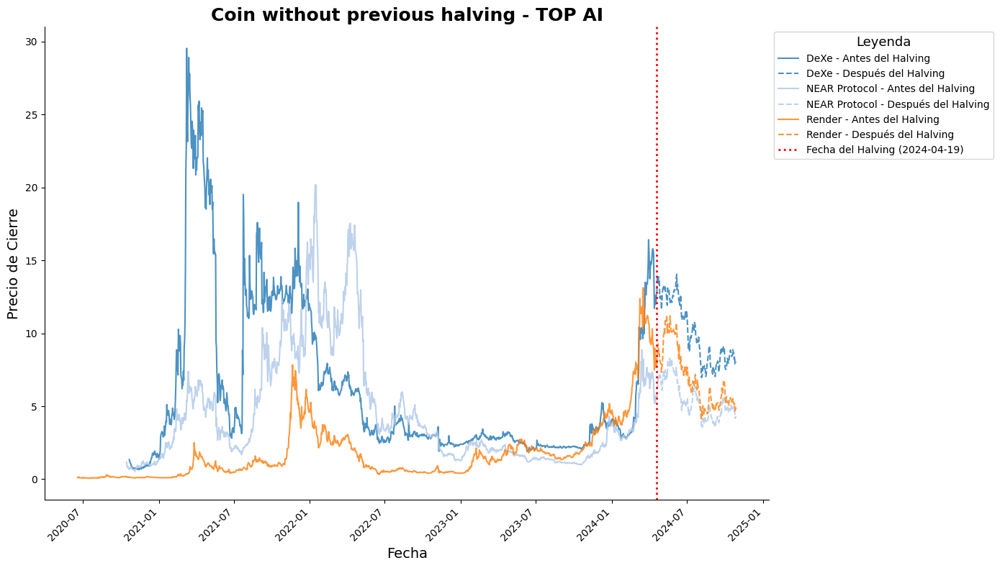

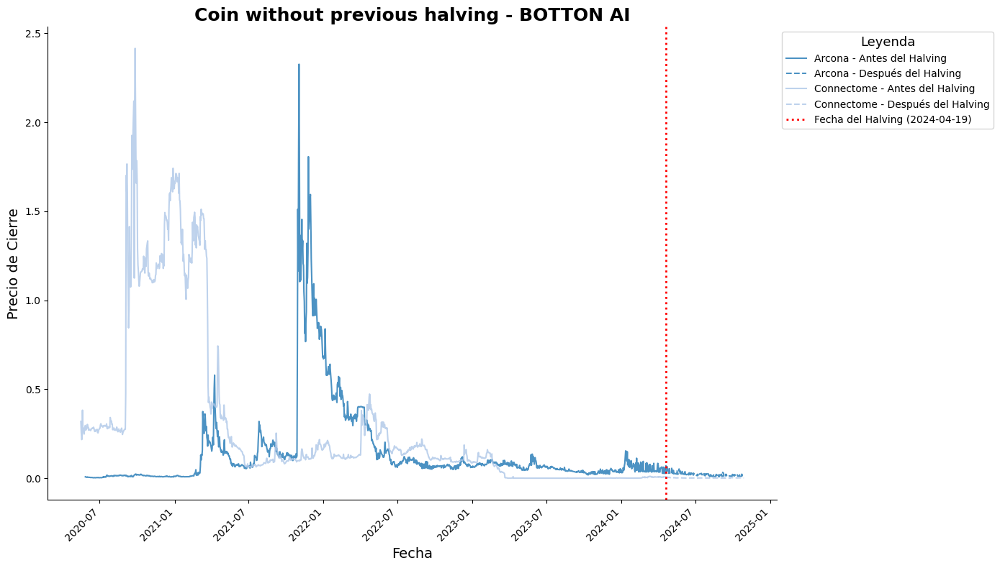

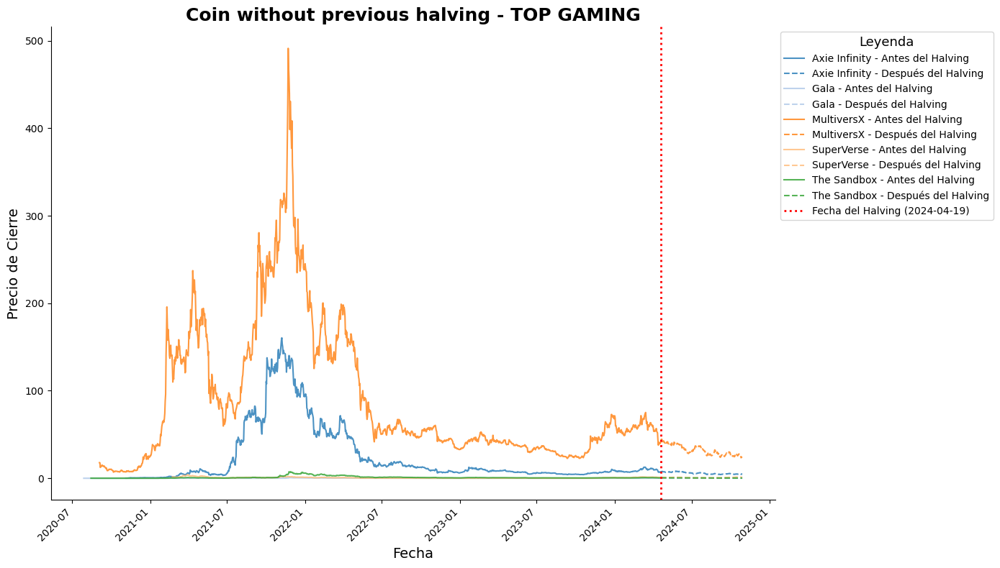

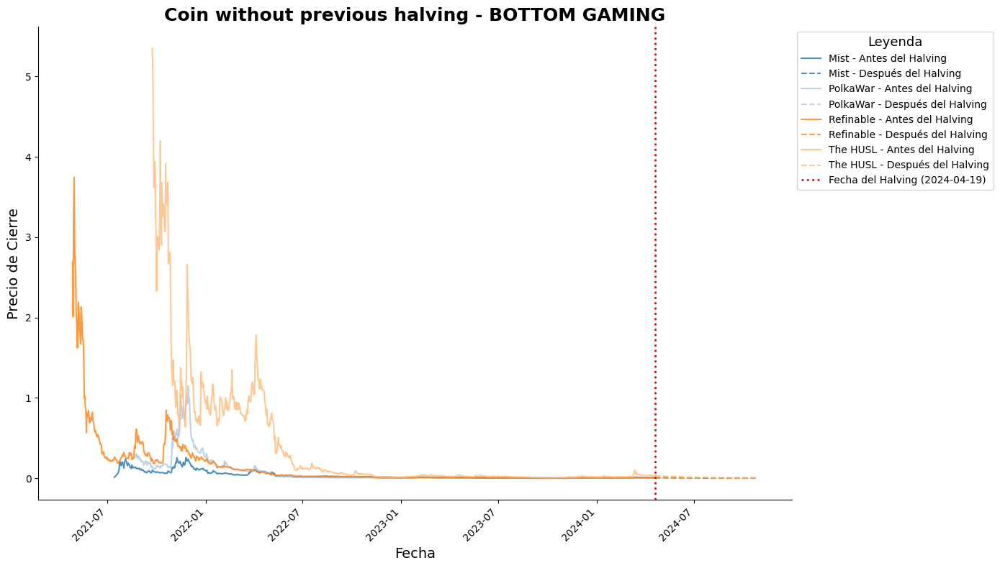

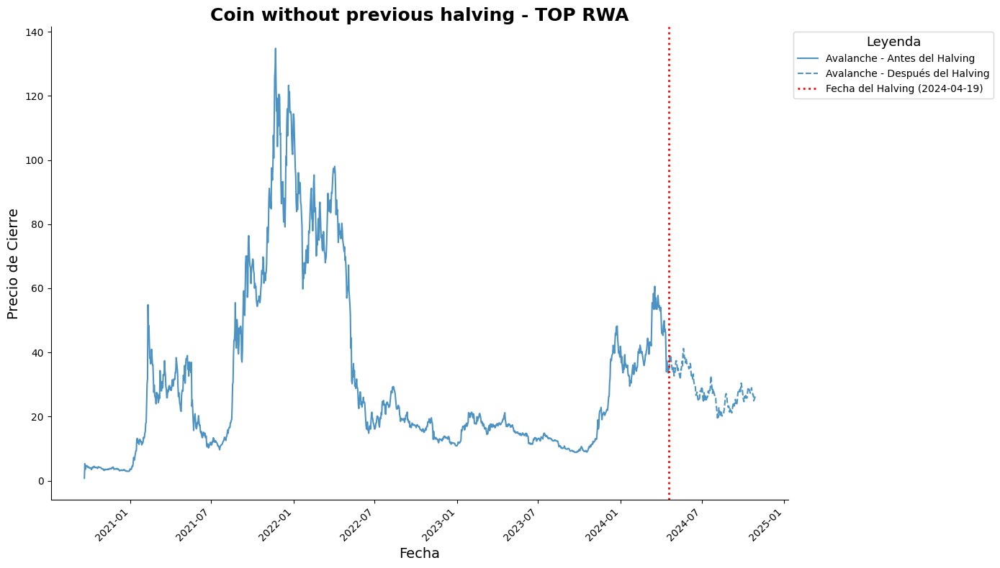

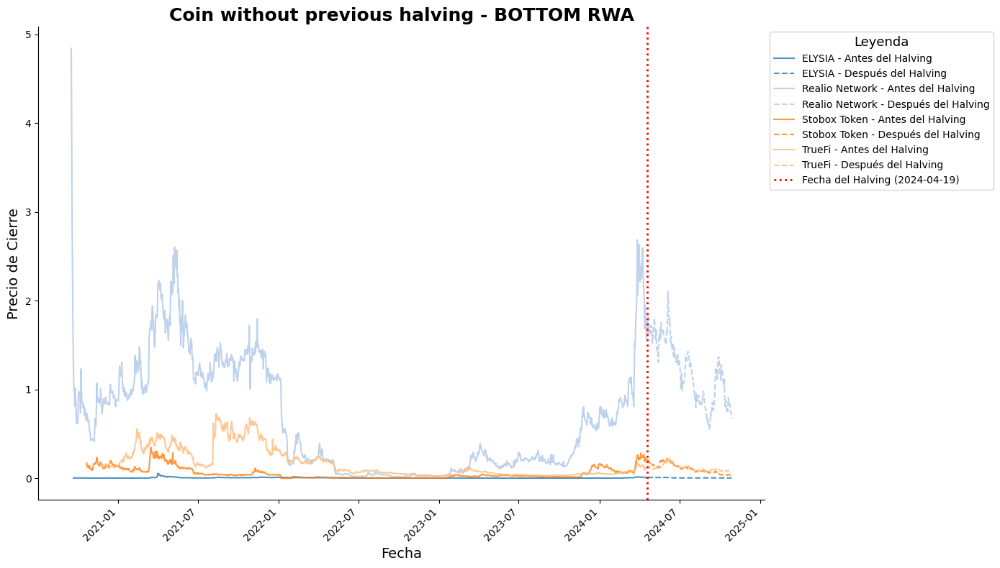

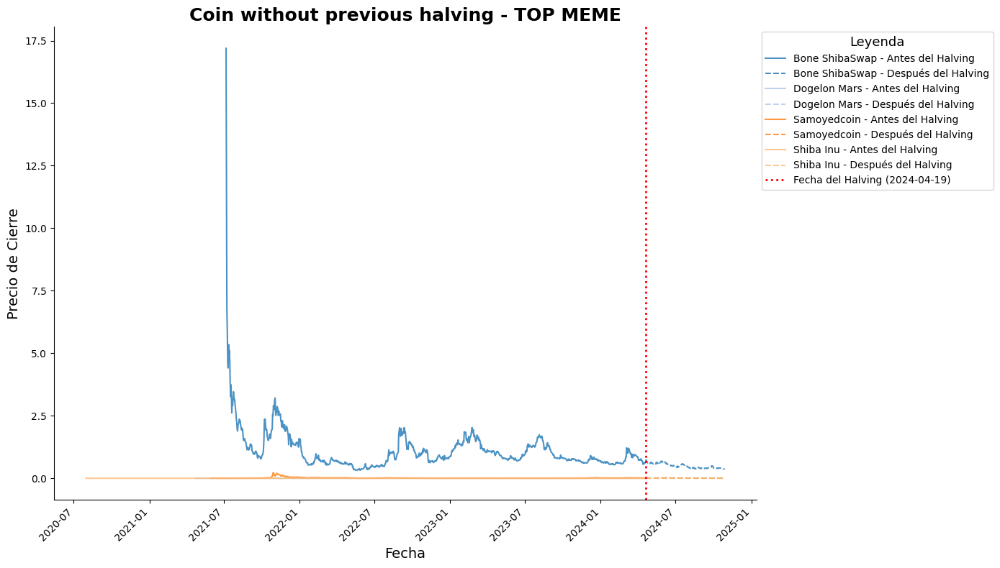

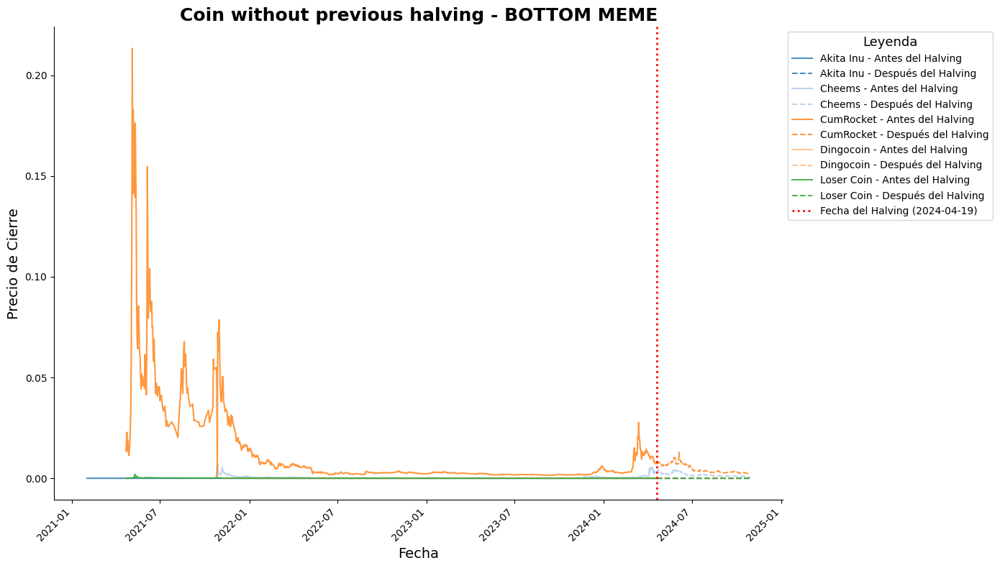

In [49]:
plot_all_historical_data_halving(df_ai_h_top, "Coin without previous halving - TOP AI")
plot_all_historical_data_halving(df_ai_h_bottom, "Coin without previous halving - BOTTON AI")
plot_all_historical_data_halving(df_gaming_h_top, "Coin without previous halving - TOP GAMING")
plot_all_historical_data_halving(df_gaming_h_bottom, "Coin without previous halving - BOTTOM GAMING")
plot_all_historical_data_halving(df_rwa_h_top, "Coin without previous halving - TOP RWA")
plot_all_historical_data_halving(df_rwa_h_bottom, "Coin without previous halving - BOTTOM RWA")
plot_all_historical_data_halving(df_meme_h_top, "Coin without previous halving - TOP MEME")
plot_all_historical_data_halving(df_meme_h_bottom, "Coin without previous halving - BOTTOM MEME")

In [50]:
df_ai['top']

,timestamp,open,high,low,close,volume,name,symbol,id,category,marketcap
date,,,,,,,,,,,
2017-08-10,2017-08-10,0.305169,0.306056,0.274675,0.283181,7.880669e+05,Golem,GLM,0bb97d30-b5bb-45d6-b105-e49436cace0e,ai,285440705
2017-08-11,2017-08-11,0.283290,0.338770,0.265750,0.338412,2.657014e+06,Golem,GLM,0bb97d30-b5bb-45d6-b105-e49436cace0e,ai,285440705
2017-08-12,2017-08-12,0.338561,0.362926,0.297332,0.311488,3.576640e+06,Golem,GLM,0bb97d30-b5bb-45d6-b105-e49436cace0e,ai,285440705
2017-08-13,2017-08-13,0.311639,0.320937,0.272864,0.277621,2.143432e+06,Golem,GLM,0bb97d30-b5bb-45d6-b105-e49436cace0e,ai,285440705
2017-08-14,2017-08-14,0.278353,0.290638,0.239921,0.265174,1.699340e+06,Golem,GLM,0bb97d30-b5bb-45d6-b105-e49436cace0e,ai,285440705
...,...,...,...,...,...,...,...,...,...,...,...
2024-10-24,2024-10-24,1.247023,1.292155,1.242449,1.258789,1.544997e+07,Theta Network,THETA,ddb361c5-0827-4324-a9ba-ee4fdbf475d9,ai,1098964292
2024-10-25,2024-10-25,1.259428,1.264012,1.091861,1.136317,2.063503e+07,Theta Network,THETA,ddb361c5-0827-4324-a9ba-ee4fdbf475d9,ai,1098964292
2024-10-26,2024-10-26,1.136163,1.154559,1.112713,1.147514,1.283639e+07,Theta Network,THETA,ddb361c5-0827-4324-a9ba-ee4fdbf475d9,ai,1098964292


In [ ]:
def get_top_5_oldest_cryptos_with_data(df):
    df['timestamp'] = pd.to_datetime(df['timestamp'])
    oldest_dates = df.groupby('name')['timestamp'].min().reset_index()
    oldest_dates = oldest_dates.sort_values(by='timestamp')
    top_5_oldest = oldest_dates.head(5)
    filtered_data = df[df['name'].isin(top_5_oldest['name'])]
    return filtered_data

In [63]:
df_ai_oldest_t = get_top_5_oldest_cryptos_with_data(df_ai['top'])
df_meme_oldest_t = get_top_5_oldest_cryptos_with_data(df_meme['top'])
df_rwa_oldest_t = get_top_5_oldest_cryptos_with_data(df_rwa['top'])
df_gaming_oldest_t = get_top_5_oldest_cryptos_with_data(df_gaming['top'])
df_ai_oldest_b = get_top_5_oldest_cryptos_with_data(df_ai['bottom'])
df_meme_oldest_b = get_top_5_oldest_cryptos_with_data(df_meme['bottom'])
df_rwa_oldest_b = get_top_5_oldest_cryptos_with_data(df_rwa['bottom'])
df_gaming_oldest_b = get_top_5_oldest_cryptos_with_data(df_gaming['bottom'])

In [64]:
halving_dates = [
    pd.Timestamp('2012-11-28'),
    pd.Timestamp('2016-07-09'),
    pd.Timestamp('2020-05-11')
]

def get_halving_date(start_date, halvings):

    for halving in halvings:
        if start_date <= halving:
            return halving
    return None

def filter_and_plot_first_halving(df, halvings):
    df['timestamp'] = pd.to_datetime(df['timestamp'])
    oldest_dates = df.groupby('name')['timestamp'].min().reset_index()
    oldest_dates['halving_date'] = oldest_dates['timestamp'].apply(lambda x: get_halving_date(x, halvings))
    valid_cryptos = oldest_dates.dropna()
    filtered_df = df[df['name'].isin(valid_cryptos['name'])]
    plt.figure(figsize=(12, 6))
    for _, row in valid_cryptos.iterrows():
        name = row['name']
        halving_date = row['halving_date']
        end_date = halving_date + pd.Timedelta(days=100)
        crypto_data = filtered_df[(filtered_df['name'] == name) & (filtered_df['timestamp'] <= end_date)]
        plt.plot(crypto_data['timestamp'], crypto_data['close'], label=name)
        plt.axvline(x=halving_date, color='red', linestyle='--', label=f'{name} Halving')
    plt.title('Precios de criptomonedas alrededor del primer halving')
    plt.xlabel('Fecha')
    plt.ylabel('Precio de cierre')
    plt.legend()
    plt.grid()
    plt.show()

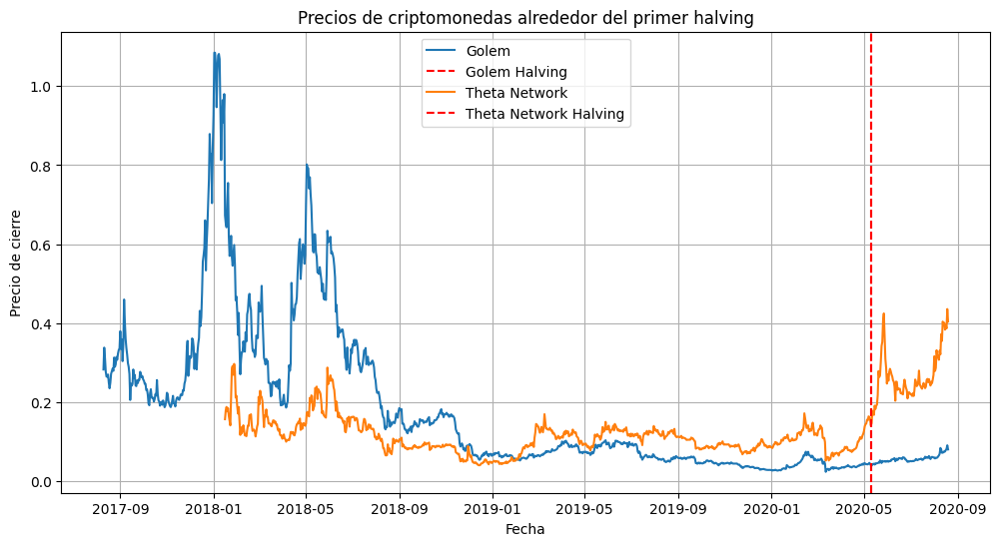

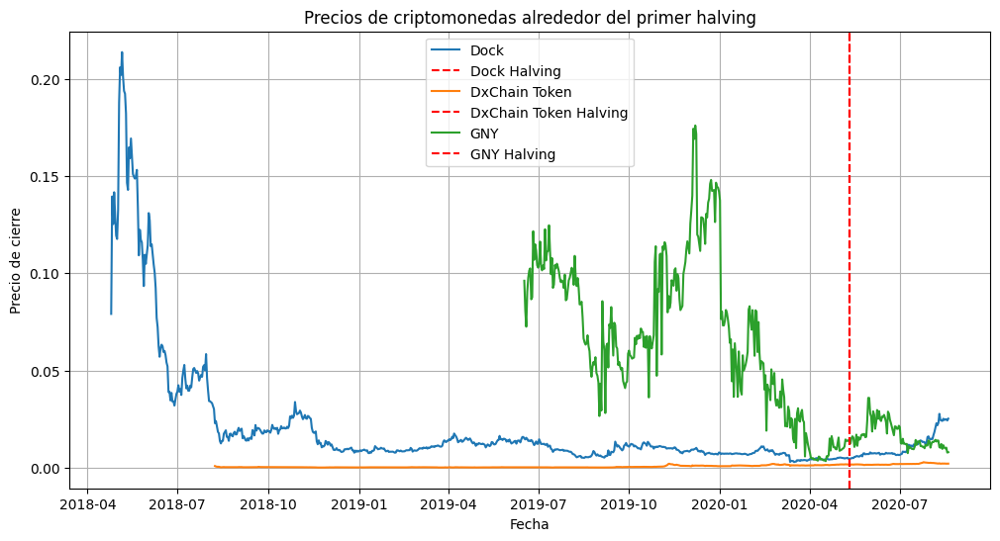

In [65]:
filter_and_plot_first_halving(df_ai_oldest_t, halving_dates)
filter_and_plot_first_halving(df_ai_oldest_b, halving_dates)


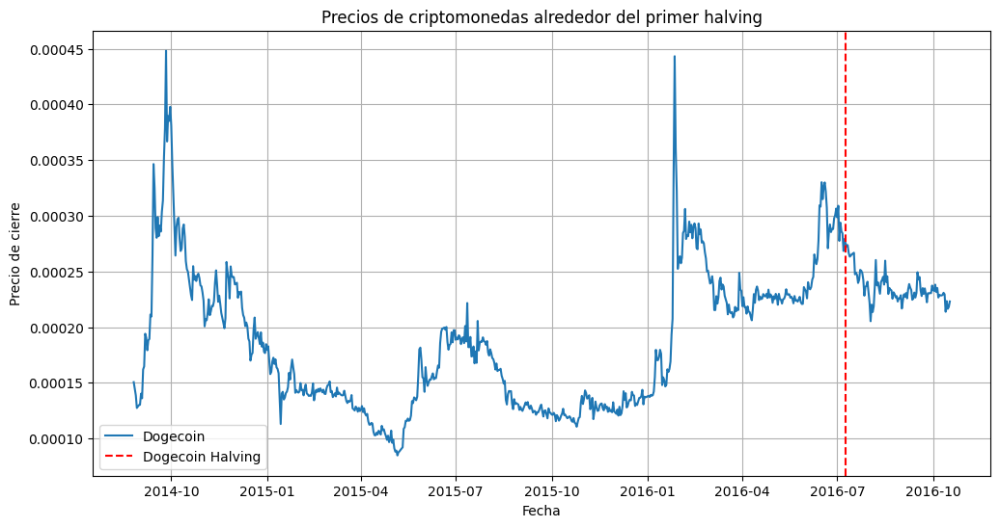

In [70]:
filter_and_plot_first_halving(df_meme_oldest_t, halving_dates)


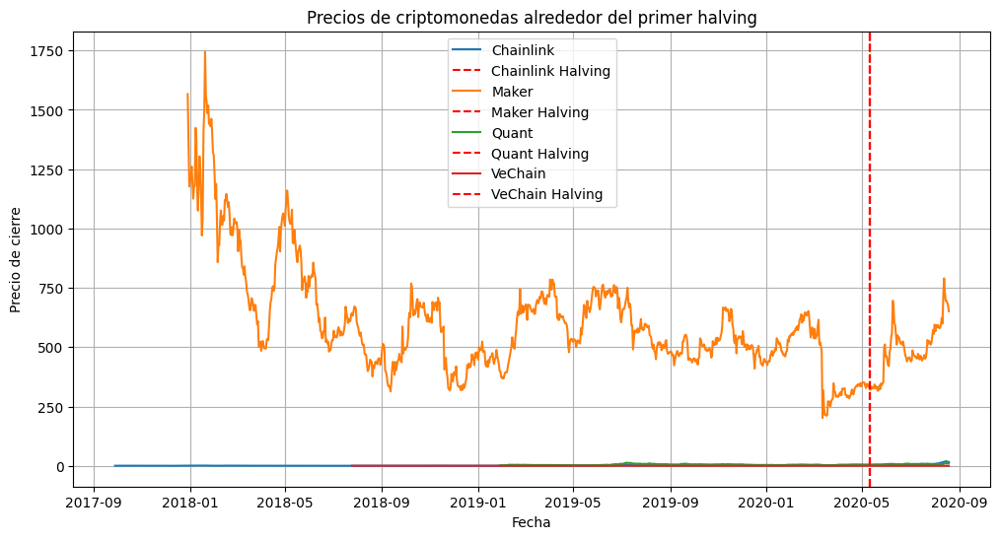

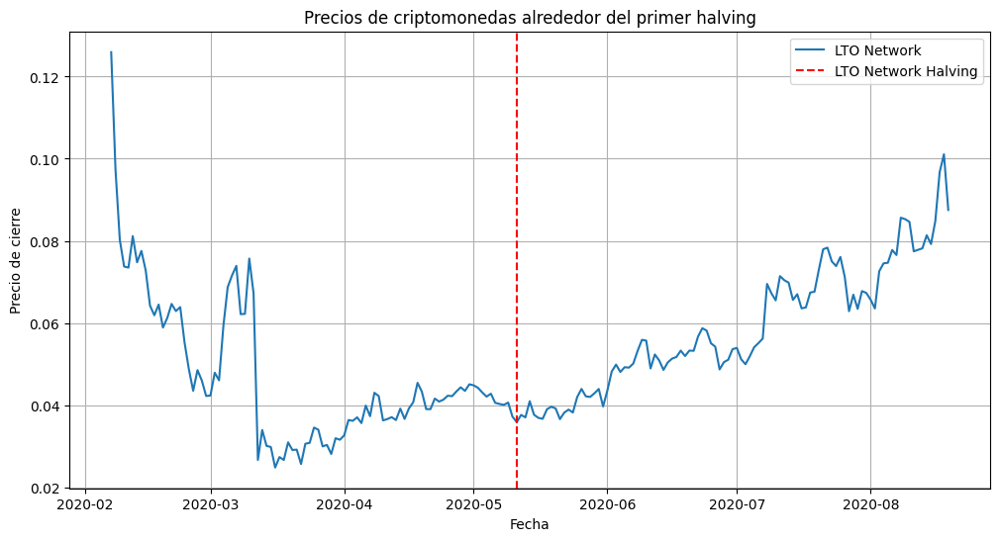

In [67]:
filter_and_plot_first_halving(df_rwa_oldest_t, halving_dates)
filter_and_plot_first_halving(df_rwa_oldest_b, halving_dates)


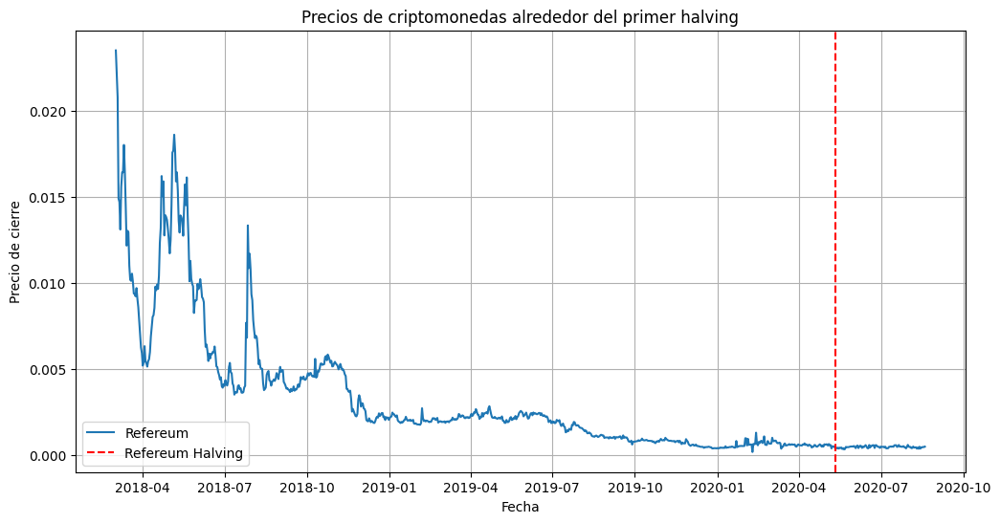

In [69]:
filter_and_plot_first_halving(df_gaming_oldest_b, halving_dates)
